# Python pour le Machine Learning : Projet Coronavirus + Exploratory Data Analysis


## 1. Intro

Je vous propose de pratiquer tout ce que nous avons vu en travaillant sur un vrai dataset. Je vous ai donc trouvé un dataset très intéressant qui va vous permettre de pratiquer tout ce que nous avons vu avec Pandas et Scikit-learn. Il s'agit du dataset "Diagnosis of COVID-19 and Clinical Spectrum" qui est disponible sur Google et qui regroupe les résultats cliniques de plus de 5000 personnes, indiquant à chaque fois si la personne souffre de la maladie du COVID-19 ou non.

## 2. Démarche de travail

Pour commencer, il vous faut toujours définir un objectif mesurable. 

Cela paraît évident dit comme ça, mais il y a beaucoup de gens qui se lancent parfois dans l'analyse de données avant même de s'être fixé un objectif. Du coup, ces personnes risquent de partir dans tous les sens, d'être désorganisées, d'explorer des choses au hasard. Bref, rien de scientifique. 

Or, nous, on fait de la data science, c'est-à-dire de la data et de la science. Voilà, il faut être organisé, il faut avoir une démarche scientifique. 

Donc, pour commencer, on se fixe un objectif. Par exemple, ici, on pourrait avoir comme objectif de prédire si une personne est infectée ou non avec 90% d'exactitude. Autrement dit, sur 100 prédictions, on a raison 90% du temps. 

Maintenant, le problème, c'est que dans ce genre de projet, on a souvent des classes déséquilibrées. C'est-à-dire que sur 100 individus, 90% d'entre eux ne vont pas avoir le virus, c'est-à-dire vont être dans la classe zéro, et 10% d'entre eux vont avoir le virus, donc vont être dans la classe 1. 

Alors, en quoi c'est un problème, vous allez me dire ? Eh bien, c'est que il est plutôt facile d'atteindre 90 % de performances. Il suffit de développer un modèle qui dit que personne n'est infecté par le coronavirus. Voilà, tout le monde est d'accord. Du coup, sur ces prédictions, le modèle aura raison 90% du temps. Est-ce que c'est un bon modèle ? Pourtant, bien sûr que non. 

Du coup, dans ce genre de circonstances, il nous faut choisir une autre mesure de performance que l'exactitude. En l'occurrence, de bonnes mesures de performances vont être la précision, le recall aussi appelé sensibilité, ou bien le score F1 qui fait le rapport entre la précision et le recall.

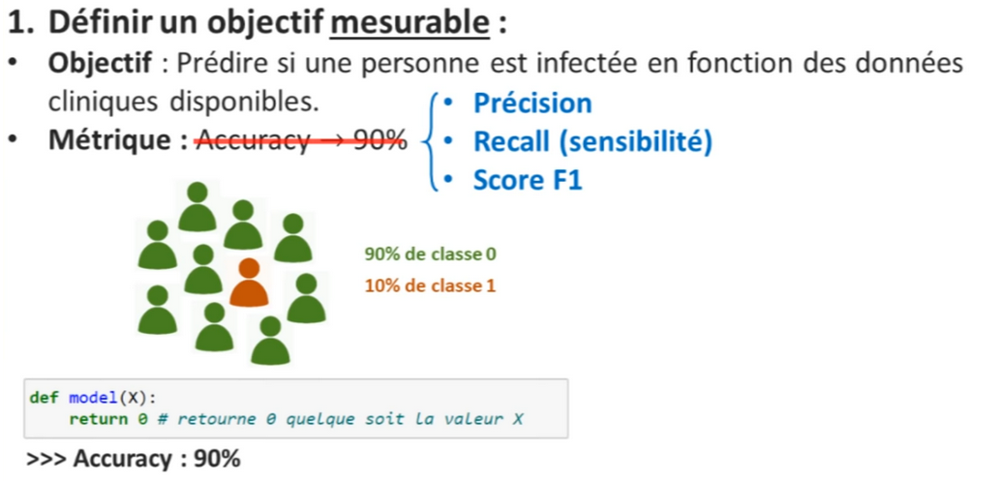

**Précision et Recall**

La précision et le recall sont des mesures de performance calculées à partir des éléments que l'on trouve dans une matrice de confusion : les faux positifs, les faux négatifs, etc.
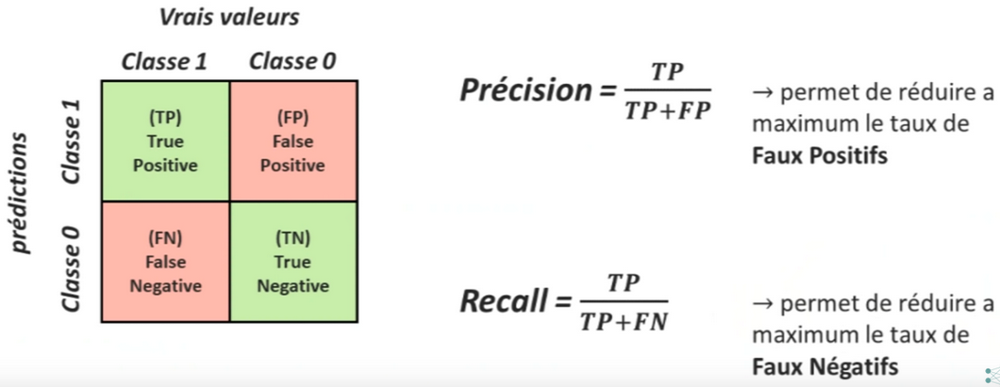

Pour faire simple, la précision vous permet de réduire au maximum le nombre de faux positifs dans vos prédictions, c'est-à-dire que vous éviterez d'envoyer à l'hôpital des gens qui n'ont pas le coronavirus. 

À l'inverse, si vous choisissez de travailler sur le recall, vous éliminerez au maximum le nombre de faux négatifs dans vos prédictions, c'est-à-dire que vous éviterez de laisser des gens ayant le coronavirus se balader sans surveillance.

Je vous laisse donc choisir la mesure de performance que vous estimez être la plus appropriée pour ce projet. À titre d'exemple, on pourrait se fixer comme objectif d'atteindre un score F1 de 50% avec un recall de 70%. 


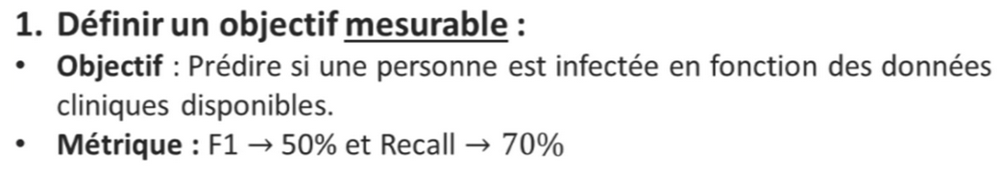

Honnêtement, si on atteint cela, c'est déjà bien.

Une fois l'objectif fixé, on peut entamer notre travail. En général, le travail de data scientist est divisé en trois activités. 
1. La première, c'est l'analyse et l'exploration de nos données, ce qu'on appelle en anglais "exploratory data analysis". Ici, le but est de se familiariser avec le dataset et de comprendre les différentes variables pour ensuite définir une stratégie de modélisation. 
2. Une fois cette stratégie définie, on passe à la deuxième activité : le preprocessing. C'est ici que l'on transforme le dataset pour qu'il soit prêt pour le développement de modèles de machine learning. On va encoder les données, éliminer les valeurs manquantes, sélectionner des variables, etc.
3. Finalement, on arrive à la troisième activité : la modélisation. Le but est clair : créer, entraîner, évaluer et améliorer un modèle de machine learning. On va peut-être aussi comparer ce modèle avec d'autres modèles pour atteindre l'objectif initial.

Le dataset se trouve sur https://www.kaggle.com/datasets/einsteindata4u/covid19

In [1]:
%matplotlib inline

import numpy as np
import pandas as pd

In [2]:
pd.set_option('display.max_Row',111)
pd.set_option('display.max_column',111)

# data = pd.read_excel('./datasets/dataset_Covid19.xlsx')
data = pd.read_excel('./datasets/dataset.xlsx')

In [3]:
data

,Patient ID,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Serum Glucose,Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Mycoplasma pneumoniae,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,Neutrophils,Urea,Proteina C reativa mg/dL,Creatinine,Potassium,Sodium,"Influenza B, rapid test","Influenza A, rapid test",Alanine transaminase,Aspartate transaminase,Gamma-glutamyltransferase,Total Bilirubin,Direct Bilirubin,Indirect Bilirubin,Alkaline phosphatase,Ionized calcium,Strepto A,Magnesium,pCO2 (venous blood gas analysis),Hb saturation (venous blood gas analysis),Base excess (venous blood gas analysis),pO2 (venous blood gas analysis),Fio2 (venous blood gas analysis),Total CO2 (venous blood gas analysis),pH (venous blood gas analysis),HCO3 (venous blood gas analysis),Rods #,Segmented,Promyelocytes,Metamyelocytes,Myelocytes,Myeloblasts,Urine - Esterase,Urine - Aspect,Urine - pH,Urine - Hemoglobin,Urine - Bile pigments,Urine - Ketone Bodies,Urine - Nitrite,Urine - Density,Urine - Urobilinogen,Urine - Protein,Urine - Sugar,Urine - Leukocytes,Urine - Crystals,Urine - Red blood cells,Urine - Hyaline cylinders,Urine - Granular cylinders,Urine - Yeasts,Urine - Color,Partial thromboplastin time (PTT),Relationship (Patient/Normal),International normalized ratio (INR),Lactic Dehydrogenase,"Prothrombin time (PT), Activity",Vitamin B12,Creatine phosphokinase (CPK),Ferritin,Arterial Lactic Acid,Lipase dosage,D-Dimer,Albumin,Hb saturation (arterial blood gases),pCO2 (arterial blood gas analysis),Base excess (arterial blood gas analysis),pH (arterial blood gas analysis),Total CO2 (arterial blood gas analysis),HCO3 (arterial blood gas analysis),pO2 (arterial blood gas analysis),Arteiral Fio2,Phosphor,ctO2 (arterial blood gas analysis)
0,44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,126e9dd13932f68,17,negative,0,0,0,0.236515,-0.022340,-0.517413,0.010677,0.102004,0.318366,-0.950790,-0.094610,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,-0.140648,not_detected,not_detected,not_detected,not_detected,not_detected,detected,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,-0.619086,1.198059,-0.147895,2.089928,-0.305787,0.862512,negative,negative,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

### 2.1 Exploratory Data Analysis

L'exploratory data analysis est, en général, une étape qui peut être assez intimidante. On est souvent confronté au syndrome de la page blanche. On a parfois l'ambition de réaliser un travail parfait, et on ne sait pas par où commencer. 

Il y a des fois des centaines de variables à analyser; d'ailleurs, c'est le cas dans ce dataset, et on peut facilement se perdre dans tous nos graphiques.
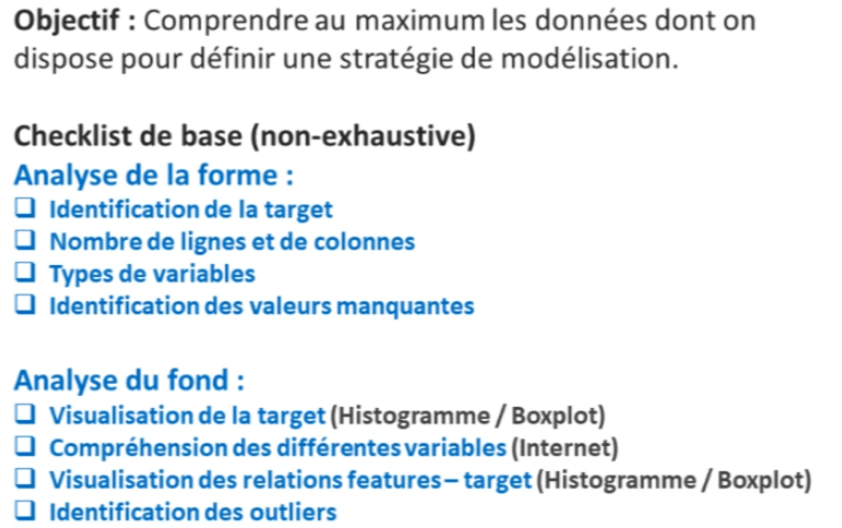

Ce que je vous conseille de faire, c'est de commencer simplement. 

1. Identifiez d'abord votre target. 
- Analysez combien il y a de lignes et de colonnes. 
- Ensuite, examinez le nombre de variables discrètes et de variables continues. Essayez de compter le nombre de types de variables que vous avez. 
- Une autre étape importante est de repérer les valeurs manquantes dans vos données. Tout ceci constitue ce que l'on appelle l'analyse de la forme des données. 

C'est une tâche simple mais cruciale. Je vous conseille également de prendre des notes. Écrivez peut-être dans un document Word séparé ou directement dans votre notebook les conclusions de votre recherche. 

2. Une fois cela fait, passez à l'analyse de fond. Il est facile de se perdre dans cette analyse en voulant tout faire parfaitement. 
- Commencez simplement : visualisez votre target. 
    - Si c'est une valeur discrète, utilisez des boxplots. 
    - Si c'est une valeur continue, essayez de faire un histogramme. 

- Ensuite, tentez de visualiser la relation entre votre target et les autres variables du dataset. En fonction des relations entre les variables (continue-continue, discrète-discrète, etc.), vous utiliserez différents types de graphiques comme des histogrammes, boxplots, etc. 

- En même temps, essayez de comprendre ce que représentent vos différentes variables. Par exemple, dans ce dataset, vous remarquerez de nombreuses variables liées à des analyses sanguines. Lorsque vous identifiez des variables importantes, renseignez-vous sur ce qu'elles représentent. Une recherche sur Internet peut être utile. 

- Enfin, identifiez les outliers éventuels présents dans votre dataset, car ils devront être traités lors de l'étape de préprocessing.

Honnêtement, si vous suivez cette checklist, vous accomplirez déjà un bon travail. 

Rappelez-vous, l'objectif est simplement de comprendre vos données. Soyez à l'aise avec elles. Comprenez ce que vous faites. Si vous y parvenez, c'est déjà une grande victoire.

### 2.2 Pre-processing

Ensuite, pour l'étape de preprocessing, 
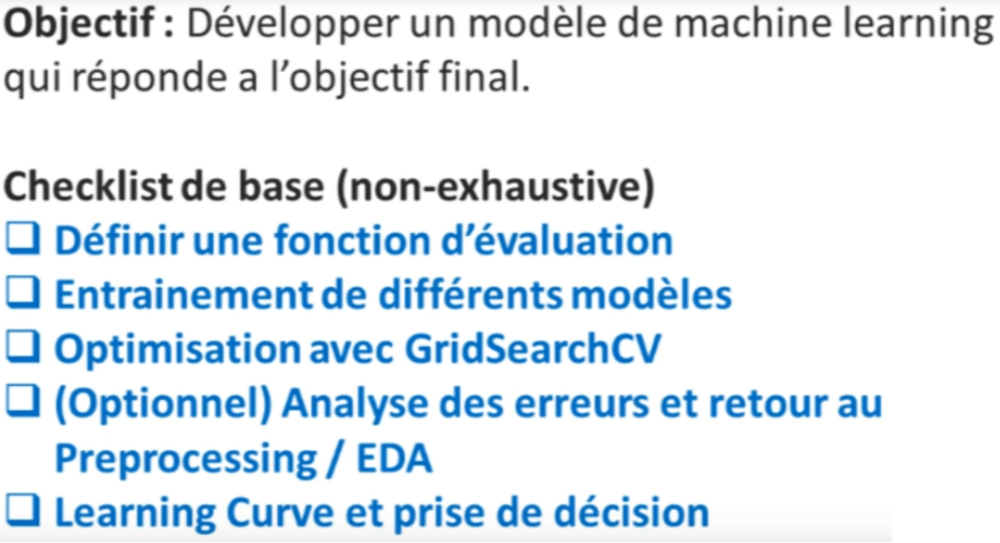

- Il faut bien sûr penser à éliminer toutes les valeurs manquantes de notre dataset. Alors pour cela, vous pouvez utiliser la fonction "dropna" de Pandas. Vous pouvez également éliminer manuellement certaines colonnes qui seraient majoritairement remplies de vide, ou vous pouvez choisir de faire de l'imputation avec cette langue.

- Une autre chose très importante à faire, c'est d'encoder notre data. De cette manière, toute variable catégorielle doit être transformée en variable numérique. C'est très important. Vous savez très bien que vous pouvez utiliser OneHot encoding ou Ordinal encoding, ou bien vous pouvez même créer une fonction de remplacement et l'utiliser avec la fonction "replace" de Pandas ou bien la fonction "map" de Pandas. Ça fonctionne très bien aussi.

- Ensuite, cela reste optionnel, mais cela peut être utile : essayez de supprimer les outliers qui pourraient être présents dans votre dataset. 
    Moi, en général, je préfère faire cela après avoir déjà créé un premier modèle de machine learning, en essayant d'analyser comment est-ce que je pourrais l'améliorer. Donc, je ne fais pas cela à la première itération. 

- Par contre, une chose que je fais directement, c'est la sélection de variables. C'est quelque chose de très important.
    - Essayez, au moins, d'éliminer les variables qui n'ont pas de variance, enfin, dont la variance est nulle. 
    - Essayez d'éliminer les variables redondantes. 
Ce genre de choses peut être très important. 
- À l'inverse, et c'est le point suivant, le feature engineering, essayez de créer de nouvelles variables à partir des variables déjà existantes. Essayez, par exemple, de créer des variables. Alors, en général, si vous êtes un professionnel du milieu, ici, par exemple, du milieu médical, vous sauriez par vous-même que, si on combine ces deux variables concernant des tests sanguins, on peut obtenir quelque chose de très informatif. 
    
    Mais si vous ne savez pas faire cela, vous pouvez toujours vous reposer sur le Polynomial feature, créer des variables polynomiales avec le transformer de Scikit-learn, et pourquoi pas utiliser une PCA pour réduire la dimensionnalité de votre dataset après que vous ayez créé de nombreuses variables. Cela peut être intéressant.

- Et pour finir, une étape très importante dans le pré-processing, c'est bien sûr le feature scaling. Pensez à normaliser vos données, soit avec un MinMax, soit avec un StandardScaler. Voilà une liste non exhaustive des choses qui sont importantes à faire quand on fait du pré-processing. Bien sûr, il y a d'autres choses, c'est pour ça qu'elle est non exhaustive.

### 2.3 Modeling

Pour élaborer des modèles de machine learning efficaces qui répondent à l'objectif que vous vous êtes fixé au début, 
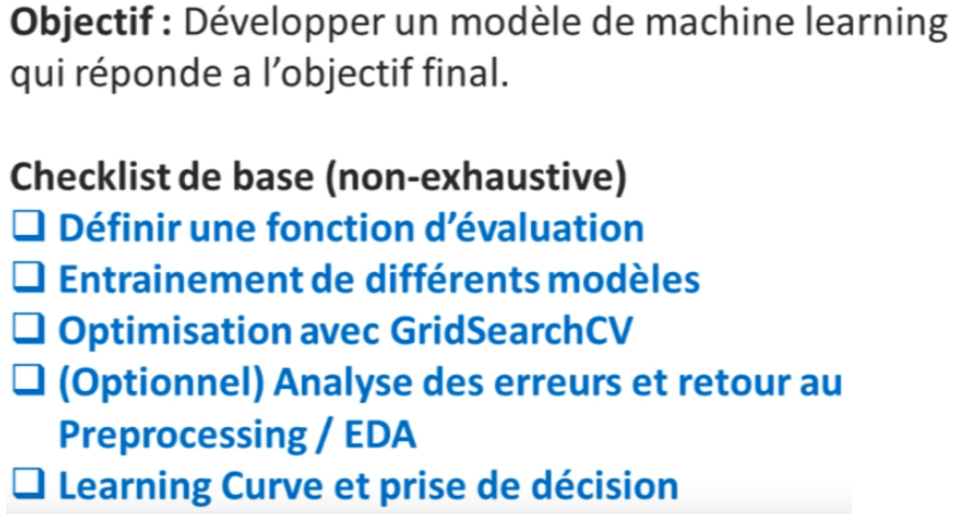

- je vous conseille de mettre en place, dès le départ, un système d'évaluation fiable et reproductible. De cette manière, vous pouvez comparer de façon fiable la performance de différents modèles de machine learning. 

    Ces modèles peuvent même être entraînés sur différentes configurations de vos données. Par la suite, si vous changez légèrement le pré-processing, vous aurez toujours un système d'évaluation fiable qui vous permettra d'affirmer si un modèle est plus performant qu'un autre.

- Ensuite, une fois ce système d'évaluation mis en place, je vous conseille de dresser une liste de modèles de machine learning et d'entraîner chacun d'eux avec ce système. Vous pourrez ainsi sélectionner les modèles les plus performants et les soumettre à un GridSearchCV pour optimiser leurs hyperparamètres. 

- Optionnellement, vous pouvez analyser les erreurs commises par ces modèles afin de retourner aux étapes précédentes, comme l'exploration des données et le pré-processing, pour ajuster vos données et améliorer la performance de vos modèles.

- En fin de checklist, il est essentiel de vérifier la Learning curve de votre modèle, car il est primordial de déterminer si l'ajout de données supplémentaires améliorera réellement sa performance. Terminez donc toujours votre travail par une analyse des courbes d'apprentissage.

Avec ces étapes, je pense que vous avez tout ce qu'il faut pour mener à bien ce projet de data science. 

Je ne vais pas vous cacher que c'est un dataset intéressant avec un niveau de difficulté débutant à intermédiaire. Ce qui sera enrichissant, c'est que ce dataset vous confronte à la réalité : dans la vraie vie, nous sommes souvent confrontés à des données incomplètes avec de nombreuses valeurs manquantes. On ne sait pas toujours comment traiter ces valeurs, mais il est crucial de prendre des décisions. La manière la plus efficace est souvent d'avoir un système d'évaluation, comme je l'ai évoqué, pour évaluer chaque décision prise. Si une décision améliore la performance, gardez-la; sinon, rejetez-la. C'est un processus de test d'hypothèses.

## 3. Exploratory Data Analysis

### 3.1 Intro

L'exploration de données est une étape qui, en apparence, peut sembler très simple. Cependant, elle nous donne parfois du fil à retordre dans la pratique. Pourquoi ? Parce qu'il est facile de se perdre parmi tous les graphiques que l'on peut créer. 

C'est pourquoi je dis toujours : il vaut mieux avancer prudemment en analysant seulement deux ou trois variables intéressantes, plutôt que de reculer en créant une multitude de graphiques et de se perdre totalement dans notre analyse. 

Rappelons-nous que notre objectif est de comprendre les données. Il est préférable de les comprendre, même superficiellement, que de s'embrouiller l'esprit. Sommes-nous d'accord? Super!

Pour cela, je vous avais conseillé deux choses. 
- La première était de prendre des notes, une étape très importante. En général, je prends des notes dans un fichier Word, mais on peut tout aussi bien le faire dans Jupiter, comme nous le ferons. 
- La seconde recommandation était de suivre une checklist basique. Si on parvient à cela, c'est un excellent début, croyez-moi.

Nous allons maintenant examiner notre dataset. Nous commencerons par analyser les formes. Mais avant tout, nous allons créer une copie de notre dataset. 

Alors, c'est parti. Nous allons créer un dataframe "df" qui sera une copie de "data". 

In [4]:
df = data.copy()

### 3.2 Checklist de base

1. Analyse de Forme :
- variable target : SARS-Cov-2 exam result
- lignes et colonnes : (5644, 111)
- types de variables : float64    70, object     37, int64       4, dtype: int64
- Analyse des valeurs manquantes : beaucoup de NaN (moitié des variables > 90% de NaN)
    - 2 groupes de données 
        - 76% concernent $\rightarrow$ Test viral, 
        - 89% concernent $\rightarrow$ taux sanguins

2. Analyse de Fond :
- Visualisation de la target : SARS-Cov-2 exam result
    - 10% de cas positifs 
- Signification des variables : 
     - variables continues standardisées, skewed (asymétriques), test sanguin
    - age quantile : difficile d'interpreter ce graphique, clairement ces données ont été traitées, on pourrait penser 0-5, mais cela pourrait aussi etre une transformation mathématique. On peut pas savoir car la personne qui a mit ce dataset ne le précise nul part. Mais ca n'est pas tres important
    - variable qualitative : binaire (0,1), viral, Rhinovirus qui semble tres élevée
- Relation Variables / Target :
    - target / blood : les taux de Monocytes, Platelets, Leukocytes semblent liés| au covid-19 $\rightarrow$ hypothese a tester
    - target / age : les individus de faible age sont tres peu contaminés ? -> attention on ne connait pas l'age, et on ne sait pas de quand date le dataset (s'il s'agit des enfants on sait que les enfants sont touchés autant que les adultes). En revanche cette variable pourra etre intéressante pour la comparer avec les résultats de tests sanguins
    - target / viral : les doubles maladies sont tres rares. Rhinovirus/Enterovirus positif - covid19 négatif ? -> hypothese a tester ? ntais il est possible que la région est subie une épidémie de ce virus. De plus on peut tres bien avoir 2 virus en meme temps. Tout ca $n$ 'a aucun lien avec le covid-19


### 3.3 Analyse de forme

#### 3.3.1 Variable target

La première étape sera d'identifier notre variable cible.
Alors, c'est assez simple. Ici, c'est clairement la variable "SARS-Cov-2 exam result". 
    
Donc, une fois qu'on l'a identifiée, que fait-on ? On prend des notes pour préciser que c'est notre variable cible. C'est très important de faire ça, croyez-moi.

#### 3.3.2 Lignes et colonnes
La deuxième chose à faire est d'identifier le nombre de lignes et le nombre de colonnes. Pour cela, c'est simple : on écrit "df.shape" et voilà. 

In [5]:
df.shape

(5644, 111)

On connaît le nombre de lignes et le nombre de colonnes. On progresse doucement, mais sûrement.

#### 3.3.3 Types de variables

Ensuite, on a les types de variables. Oui, parce que c'est super utile. Lorsque vous avez un grand dataset, vous voulez savoir où se trouvent les variables qualitatives et les variables quantitatives, entre autres.

Pour cela, on peut utiliser la fonction "dtypes" de pandas. Elle nous indique quels types de valeurs sont présents dans chaque variable de notre dataset. 

In [6]:
df.dtypes

Patient ID                                                object
Patient age quantile                                       int64
SARS-Cov-2 exam result                                    object
Patient addmited to regular ward (1=yes, 0=no)             int64
Patient addmited to semi-intensive unit (1=yes, 0=no)      int64
Patient addmited to intensive care unit (1=yes, 0=no)      int64
Hematocrit                                               float64
Hemoglobin                                               float64
Platelets                                                float64
Mean platelet volume                                     float64
Red blood Cells                                          float64
Lymphocytes                                              float64
Mean corpuscular hemoglobin concentration (MCHC)         float64
Leukocytes                                               float64
Basophils                                                float64
Mean corpuscular hemoglob

Et, petite astuce de pro : si vous voulez afficher tous les résultats, je vous conseille d'utiliser la fonction "set_option" de pandas.

Il serait également intéressant de compter le nombre de types de variables qu'on a à chaque fois. 
 
Pour cela, il faut utiliser la fonction "value_counts", une fonction très importante. On écrit donc ".value_counts", et voilà.

In [7]:
df.dtypes.value_counts()

float64    70
object     37
int64       4
dtype: int64

On voit qu'on a 70 types "float", 37 variables de type "object" et 4 variables de type "int".
Et si on veut, on peut transformer cela en graphique en utilisant ".plot.pie", et cela nous donne un petit graphique.

<Axes: >

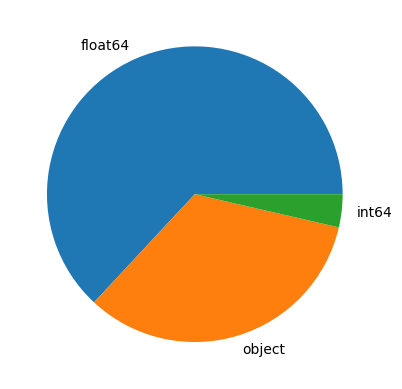

In [8]:
df.dtypes.value_counts().plot.pie()

#### 3.3.4 Analyse des valeurs manquantes

Enfin, sur notre checklist, il faut analyser les valeurs manquantes de notre dataset : Analyse des NaN

C'est la dernière chose à faire pour l'analyse de forme. En effet, lorsqu'on analyse notre dataset, on voit qu'il manque pas mal de valeurs. Cela peut être embêtant. D'ailleurs, pour y voir plus clair, on pourrait afficher toutes les colonnes de ce dataset. 
    
Tout comme avant, on avait pu afficher 111 lignes. Pour ça, au lieu de faire "display.max_rows", on va faire "display.max_columns". 

In [9]:
data.head()

,Patient ID,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Serum Glucose,Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Mycoplasma pneumoniae,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,Neutrophils,Urea,Proteina C reativa mg/dL,Creatinine,Potassium,Sodium,"Influenza B, rapid test","Influenza A, rapid test",Alanine transaminase,Aspartate transaminase,Gamma-glutamyltransferase,Total Bilirubin,Direct Bilirubin,Indirect Bilirubin,Alkaline phosphatase,Ionized calcium,Strepto A,Magnesium,pCO2 (venous blood gas analysis),Hb saturation (venous blood gas analysis),Base excess (venous blood gas analysis),pO2 (venous blood gas analysis),Fio2 (venous blood gas analysis),Total CO2 (venous blood gas analysis),pH (venous blood gas analysis),HCO3 (venous blood gas analysis),Rods #,Segmented,Promyelocytes,Metamyelocytes,Myelocytes,Myeloblasts,Urine - Esterase,Urine - Aspect,Urine - pH,Urine - Hemoglobin,Urine - Bile pigments,Urine - Ketone Bodies,Urine - Nitrite,Urine - Density,Urine - Urobilinogen,Urine - Protein,Urine - Sugar,Urine - Leukocytes,Urine - Crystals,Urine - Red blood cells,Urine - Hyaline cylinders,Urine - Granular cylinders,Urine - Yeasts,Urine - Color,Partial thromboplastin time (PTT),Relationship (Patient/Normal),International normalized ratio (INR),Lactic Dehydrogenase,"Prothrombin time (PT), Activity",Vitamin B12,Creatine phosphokinase (CPK),Ferritin,Arterial Lactic Acid,Lipase dosage,D-Dimer,Albumin,Hb saturation (arterial blood gases),pCO2 (arterial blood gas analysis),Base excess (arterial blood gas analysis),pH (arterial blood gas analysis),Total CO2 (arterial blood gas analysis),HCO3 (arterial blood gas analysis),pO2 (arterial blood gas analysis),Arteiral Fio2,Phosphor,ctO2 (arterial blood gas analysis)
0,44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,126e9dd13932f68,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,-0.140648,not_detected,not_detected,not_detected,not_detected,not_detected,detected,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,-0.619086,1.198059,-0.147895,2.089928,-0.305787,0.862512,negative,negative,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

Donc, si on exécute ça, on a toutes nos colonnes qui sont affichées, et ça, c'est très cool. Et comme on peut le voir, il y a beaucoup de valeurs manquantes.

Ce que j'aime beaucoup faire pour visualiser mes valeurs manquantes, c'est tout simplement de visualiser mon dataset en entier. 

Alors vous allez me dire : "Mais comment tu peux faire ça? Le dataset est géant, on ne va pas afficher 5000 lignes et 111 colonnes!" Et oui, en effet, on ne va pas faire ce genre de choses. 

À la place, on va afficher notre dataset dans une image avec soit la fonction "imshow" de "matplotlib" soit la fonction "heatmap" de "seaborn". 

Pour ça, la première chose qu'on va faire, c'est de prendre notre dataset et d'utiliser la fonction "isna" de pandas. Cette fonction vérifie si une valeur est NaN (c'est-à-dire "Not a Number"). 

In [10]:
df.isna()

,Patient ID,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Serum Glucose,Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Mycoplasma pneumoniae,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,Neutrophils,Urea,Proteina C reativa mg/dL,Creatinine,Potassium,Sodium,"Influenza B, rapid test","Influenza A, rapid test",Alanine transaminase,Aspartate transaminase,Gamma-glutamyltransferase,Total Bilirubin,Direct Bilirubin,Indirect Bilirubin,Alkaline phosphatase,Ionized calcium,Strepto A,Magnesium,pCO2 (venous blood gas analysis),Hb saturation (venous blood gas analysis),Base excess (venous blood gas analysis),pO2 (venous blood gas analysis),Fio2 (venous blood gas analysis),Total CO2 (venous blood gas analysis),pH (venous blood gas analysis),HCO3 (venous blood gas analysis),Rods #,Segmented,Promyelocytes,Metamyelocytes,Myelocytes,Myeloblasts,Urine - Esterase,Urine - Aspect,Urine - pH,Urine - Hemoglobin,Urine - Bile pigments,Urine - Ketone Bodies,Urine - Nitrite,Urine - Density,Urine - Urobilinogen,Urine - Protein,Urine - Sugar,Urine - Leukocytes,Urine - Crystals,Urine - Red blood cells,Urine - Hyaline cylinders,Urine - Granular cylinders,Urine - Yeasts,Urine - Color,Partial thromboplastin time (PTT),Relationship (Patient/Normal),International normalized ratio (INR),Lactic Dehydrogenase,"Prothrombin time (PT), Activity",Vitamin B12,Creatine phosphokinase (CPK),Ferritin,Arterial Lactic Acid,Lipase dosage,D-Dimer,Albumin,Hb saturation (arterial blood gases),pCO2 (arterial blood gas analysis),Base excess (arterial blood gas analysis),pH (arterial blood gas analysis),Total CO2 (arterial blood gas analysis),HCO3 (arterial blood gas analysis),pO2 (arterial blood gas analysis),Arteiral Fio2,Phosphor,ctO2 (arterial blood gas analysis)
0,False,False,False,False,False,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
2,False,False,False,False,False,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True

Si on exécute ça, on a un tableau de booléens avec des "True" et des "False". 

Donc, si on veut afficher tout ça avec "seaborn", c'est simple : on écrit "sns.heatmap" et regardez ce qui se passe quand on exécute la cellule. 

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['figure.max_open_warning'] = 30

<Axes: >

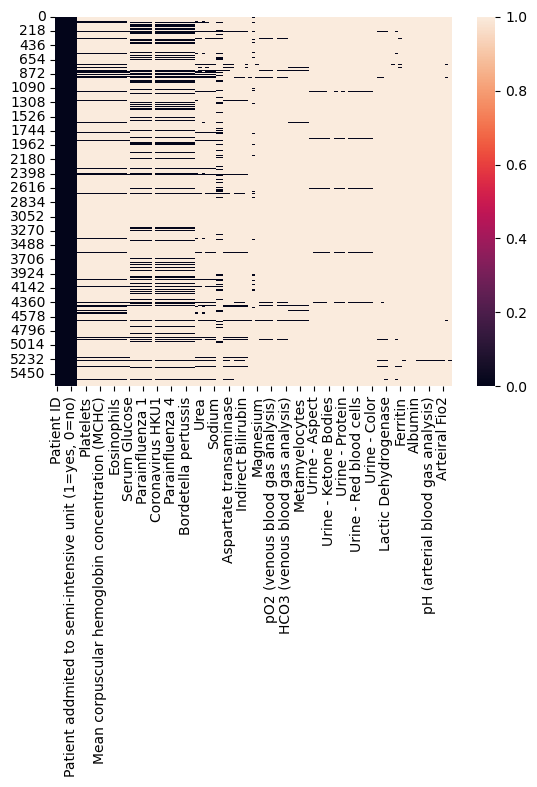

In [12]:
sns.heatmap(df.isna())

On voit tout notre dataset avec toutes ses lignes et toutes ses colonnes : en blanc, là où il y a des valeurs manquantes et en noir, les positions où on a des valeurs.

Pour afficher cette vue un peu plus grande, on va créer une figure de dimension, disons 20x10. 

Ensuite, dans "heatmap", on va éliminer cette couleur de barre en écrivant "cbar=False".

<Axes: >

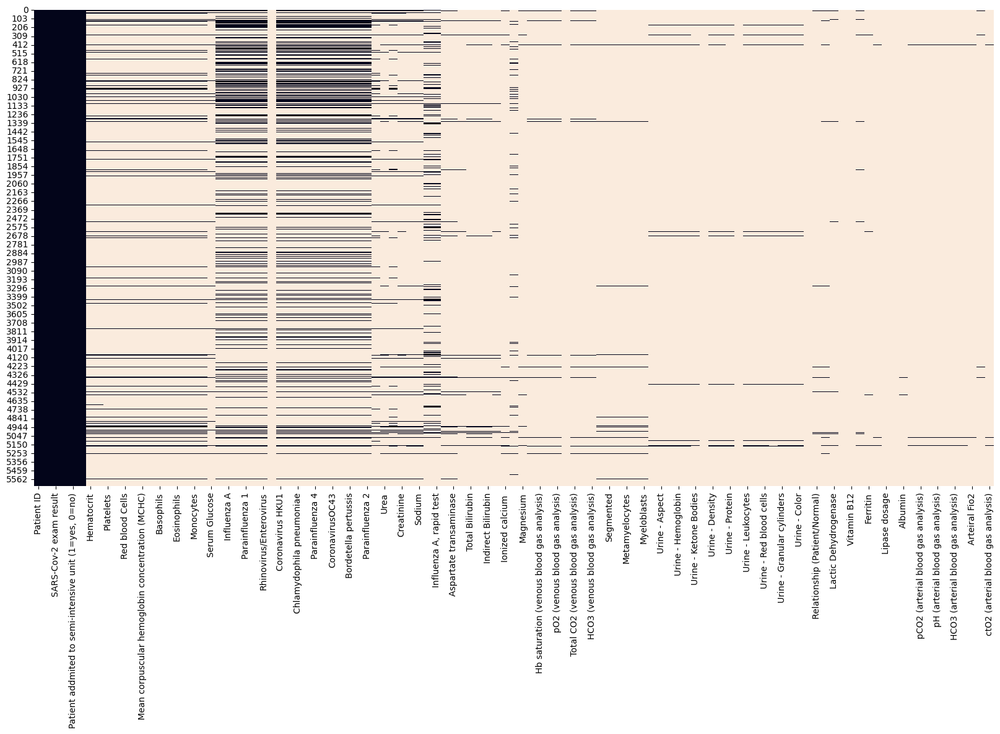

In [13]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(), cbar=False)

Ce qui nous donne le graphique suivant qui est tout de suite beaucoup plus lisible. 

Il est temps d'analyser ce graphique. On voit qu'on a beaucoup de blanc, c'est-à-dire beaucoup de valeurs manquantes. 

Toutes les colonnes qui sont sur la droite, toute cette zone-là, est presque vide. Donc, c'est sûrement une zone qu'on va éliminer lors du pré-processing. 

Ensuite, ce qu'on peut voir, c'est qu'on a quelque chose de très intéressant. On peut voir des lignes. Cela signifie deux choses : 

- la première, c'est que c'est une bonne nouvelle car cela signifie qu'on va pouvoir éliminer quelques variables ou valeurs manquantes avec "dropna". 
- La seconde chose, c'est que ces variables qui forment une ligne ont sans doute un rapport les unes avec les autres. 

Quand vous voyez ça, cela sent le rapport, cela sent la relation. Donc, il faut garder ça à l'esprit.

À présent, si on veut mesurer le pourcentage de valeurs manquantes dans nos différentes colonnes, que va-t-on faire? On va faire "df.isna()", ça nous donne le tableau qu'on avait tout à l'heure, puis on va faire la somme.

In [14]:
df.isna().sum()

Patient ID                                                  0
Patient age quantile                                        0
SARS-Cov-2 exam result                                      0
Patient addmited to regular ward (1=yes, 0=no)              0
Patient addmited to semi-intensive unit (1=yes, 0=no)       0
Patient addmited to intensive care unit (1=yes, 0=no)       0
Hematocrit                                               5041
Hemoglobin                                               5041
Platelets                                                5042
Mean platelet volume                                     5045
Red blood Cells                                          5042
Lymphocytes                                              5042
Mean corpuscular hemoglobin concentration (MCHC)         5042
Leukocytes                                               5042
Basophils                                                5042
Mean corpuscular hemoglobin (MCH)                        5042
Eosinoph

On a ici la somme des valeurs manquantes qu'on retrouve dans toutes nos colonnes. 

Maintenant, qu'est-ce qu'on va faire? On va calculer un pourcentage. Donc, on va diviser cela par le nombre de lignes de notre tableau. 

Donc on fait visié par "df.shape[0]". Cela nous donne un pourcentage. 

In [15]:
df.isna().sum()/df.shape[0]

Patient ID                                               0.000000
Patient age quantile                                     0.000000
SARS-Cov-2 exam result                                   0.000000
Patient addmited to regular ward (1=yes, 0=no)           0.000000
Patient addmited to semi-intensive unit (1=yes, 0=no)    0.000000
Patient addmited to intensive care unit (1=yes, 0=no)    0.000000
Hematocrit                                               0.893161
Hemoglobin                                               0.893161
Platelets                                                0.893338
Mean platelet volume                                     0.893870
Red blood Cells                                          0.893338
Lymphocytes                                              0.893338
Mean corpuscular hemoglobin concentration (MCHC)         0.893338
Leukocytes                                               0.893338
Basophils                                                0.893338
Mean corpu

On voit par exemple que 97% des valeurs de la variable "Alkaline phosphatase" sont manquantes. C'est énorme! Et pour finir, ce qu'on peut faire en général, c'est de trier tout ça dans l'ordre croissant ou décroissant. Pour ça, on utilise la fonction "sort_values". Donc on peut écrire à l'intérieur si on veut avoir un ordre ascendant ou descendant en écrivant "ascending=True" ou "False".

In [16]:
(df.isna().sum()/df.shape[0]).sort_values(ascending=True)

Patient ID                                               0.000000
Patient age quantile                                     0.000000
SARS-Cov-2 exam result                                   0.000000
Patient addmited to regular ward (1=yes, 0=no)           0.000000
Patient addmited to semi-intensive unit (1=yes, 0=no)    0.000000
Patient addmited to intensive care unit (1=yes, 0=no)    0.000000
Influenza B                                              0.760099
Respiratory Syncytial Virus                              0.760099
Influenza A                                              0.760099
Rhinovirus/Enterovirus                                   0.760454
Inf A H1N1 2009                                          0.760454
CoronavirusOC43                                          0.760454
Coronavirus229E                                          0.760454
Parainfluenza 4                                          0.760454
Adenovirus                                               0.760454
Chlamydoph

Ce qu'on peut voir, c'est que "patient_id", "patient_age", etc., ce sont des variables dans lesquelles il n'y a aucune valeur manquante. Donc, il s'agit de nos premières variables, tout à gauche de notre dataset.
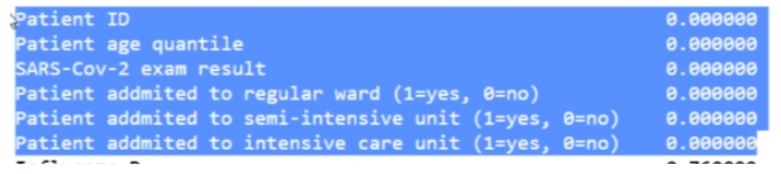

Ensuite, on peut voir qu'on a un deuxième groupe de variables qui ont toutes 76% de valeurs manquantes. Très intéressant.
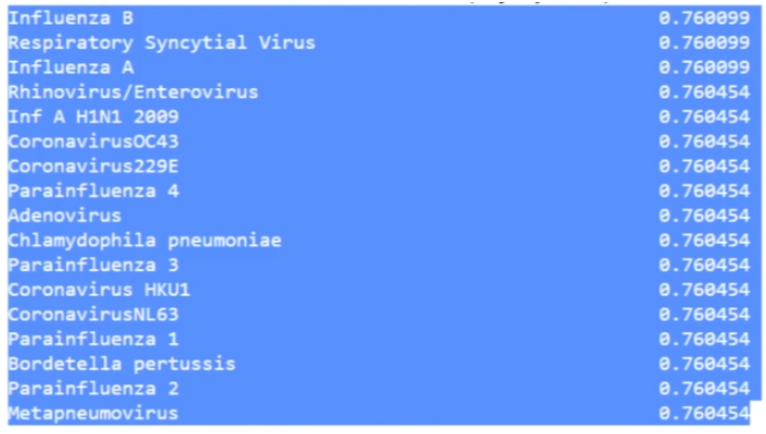

Ensuite, on voit qu'on a des variables qui sont de 89% jusqu'à 90%. Là encore, il s'agit d'une ligne, c'est clair. Toutes ces variables sont à 89%.
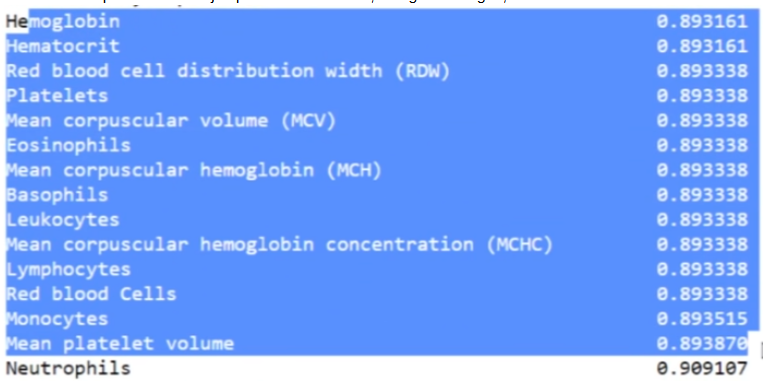

Dans le reste de notre tableau, il y a quelques variables qui sont toutes à 97% de valeurs manquantes, mais la grande majorité de nos variables est à 99%. C'est quand même énorme.

Ce que nous allons faire pour la suite de cette analyse, c'est tout simplement d'éliminer toutes ces variables. 
Peut-être même que nous allons éliminer toutes les variables qui ont plus de 90% de valeurs manquantes. 

En plus, cela va nous permettre de nous focaliser sur ces deux groupes de données que nous pouvons identifier : le groupe des variables à 89% et le groupe des variables à 76%. Car notre intuition nous dit qu'il y a quelque chose à observer avec ces variables. 

Donc, en conclusion sur cette analyse des valeurs manquantes, nous avons pu constater qu'il y a beaucoup de NaN. 

Qu'avons-nous également remarqué ? Eh bien, il y a deux groupes de données très distincts dans notre dataset, et nous avons pu les identifier grâce à l'analyse des valeurs manquantes. 

C'est assez surprenant. En fait, en effectuant quelques recherches sur internet, on se rend compte que le groupe où il y a 76% de valeurs manquantes correspond à un groupe de tests pour différentes bactéries et virus. 

Tandis que les variables qui ont 89% de valeurs manquantes sont, en réalité, des variables liées aux taux de globules blancs, de globules rouges et ce genre de choses. 

Avec cela, nous avons terminé notre analyse de forme.

### 3.4 Analyse de fond (Préparation des données)

Après notre première analyse de forme, nous allons maintenant passer à l'analyse de fond. 

#### 3.4.1 Nettoyer le dataset

Avant toute chose, nous allons un peu nettoyer notre dataset. Nous commencerons par éliminer les colonnes qui sont inutiles : celles qui sont complètement remplies de vides, comme ces colonnes dans lesquelles il y a 100% de valeurs manquantes. Mais il est possible que nous éliminions aussi toutes les colonnes ayant jusqu'à 90% de valeurs manquantes. 

Pour éliminer avec une seule ligne de code toutes les données où il y a plus de 90% de valeurs manquantes, nous allons utiliser "df.isna().sum() / df.shape[0]". Cela nous donne notre pourcentage. 
    
Ensuite, nous utiliserons un filtrage en sélectionnant toutes les valeurs qui sont inférieures à 0,9. Cela nous donnera un tableau booléen que nous réinjecterons dans notre dataframe.

In [17]:
(df.isna().sum()/df.shape[0]).sort_values(ascending=True) < 0.9

Patient ID                                                True
Patient age quantile                                      True
SARS-Cov-2 exam result                                    True
Patient addmited to regular ward (1=yes, 0=no)            True
Patient addmited to semi-intensive unit (1=yes, 0=no)     True
Patient addmited to intensive care unit (1=yes, 0=no)     True
Influenza B                                               True
Respiratory Syncytial Virus                               True
Influenza A                                               True
Rhinovirus/Enterovirus                                    True
Inf A H1N1 2009                                           True
CoronavirusOC43                                           True
Coronavirus229E                                           True
Parainfluenza 4                                           True
Adenovirus                                                True
Chlamydophila pneumoniae                               

Ce que nous ferons ensuite, c'est utiliser "df.columns" pour identifier toutes les colonnes où, en effet, il y a moins de 90% de valeurs manquantes.

In [18]:
df.columns[(df.isna().sum()/df.shape[0]).sort_values(ascending=True) < 0.9]

Index(['Patient ID', 'Patient age quantile', 'SARS-Cov-2 exam result',
       'Patient addmited to regular ward (1=yes, 0=no)',
       'Patient addmited to semi-intensive unit (1=yes, 0=no)',
       'Patient addmited to intensive care unit (1=yes, 0=no)', 'Hematocrit',
       'Hemoglobin', 'Platelets', 'Mean platelet volume ', 'Red blood Cells',
       'Lymphocytes', 'Mean corpuscular hemoglobin concentration (MCHC)',
       'Leukocytes', 'Basophils', 'Mean corpuscular hemoglobin (MCH)',
       'Eosinophils', 'Mean corpuscular volume (MCV)', 'Monocytes',
       'Red blood cell distribution width (RDW)', 'Serum Glucose',
       'Respiratory Syncytial Virus', 'Influenza A', 'Influenza B',
       'Parainfluenza 1', 'CoronavirusNL63', 'Rhinovirus/Enterovirus',
       'Mycoplasma pneumoniae', 'Coronavirus HKU1', 'Parainfluenza 3',
       'Chlamydophila pneumoniae', 'Adenovirus', 'Parainfluenza 4',
       'Coronavirus229E', 'CoronavirusOC43', 'Inf A H1N1 2009',
       'Bordetella pertussis',

Une fois identifiées, nous les passerons dans notre nouveau dataframe en utilisant une affectation. 

In [19]:
df[df.columns[(df.isna().sum()/df.shape[0]).sort_values(ascending=True) < 0.9]]

,Patient ID,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Serum Glucose,Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Mycoplasma pneumoniae,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2
0,44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,126e9dd13932f68,17,negative,0,0,0,0.236515,-0.022340,-0.517413,0.010677,0.102004,0.318366,-0.950790,-0.094610,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,-0.140648,not_detected,not_detected,not_detected,not_detected,not_detected,detected,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected
2,a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,f7d619a94f97c45,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,d9e41465789c2b5,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5639,ae66feb9e4dc3a0,3,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5640,517c2834024f3ea,17,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5641,5c57d6037fe266d,4,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5642,c20c44766f28291,10,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Ainsi, nous sommes passés de 111 colonnes à 39 colonnes. 

Bien entendu, il ne faut pas oublier d'enregistrer cela dans notre dataframe en l'écrivant comme étant égal à ce résultat. 

In [20]:
#df = df[df.columns[(df.isna().sum()/df.shape[0]).sort_values(ascending=True) < 0.9]]
df = df[df.columns[df.isna().sum()/df.shape[0] <0.9]]
df

,Patient ID,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
0,44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,126e9dd13932f68,17,negative,0,0,0,0.236515,-0.022340,-0.517413,0.010677,0.102004,0.318366,-0.950790,-0.094610,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative
2,a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,f7d619a94f97c45,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,d9e41465789c2b5,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5639,ae66feb9e4dc3a0,3,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5640,517c2834024f3ea,17,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5641,5c57d6037fe266d,4,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5642,c20c44766f28291,10,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Si nous affichons ce tableau avec notre fonction heatmap, comme précédemment, nous obtiendrons un tableau des valeurs manquantes.

<Axes: >

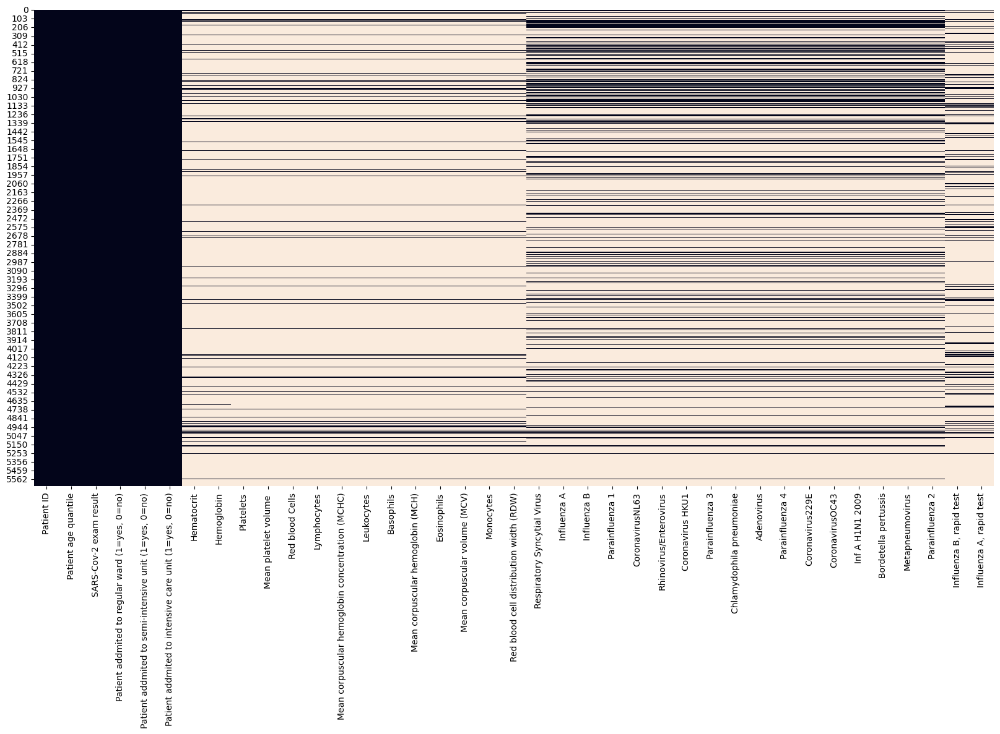

In [21]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(), cbar=False)

Nous avons bien éliminé les colonnes que nous estimions inutiles. Désormais, nous avons quelque chose de propre sur lequel effectuer notre analyse de fond. 

Cependant, il se pourrait qu'il y ait encore une colonne à éliminer, celle nommée "patient_id", car avoir ce numéro pour chaque patient ne nous sera d'aucune utilité. 

Pour rappel, pour éliminer une colonne d'un dataframe, il suffit d'utiliser la fonction "drop" avec l'argument "axis=1". 

In [22]:
df = df.drop('Patient ID', axis=1)

In [23]:
df.head()

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
0,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative
2,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN


Voilà, la colonne "patient_id" a été supprimée. Parfait!

#### 3.4.2 Analyse Target.

Maintenant que nous avons nettoyé et préparé notre dataset, nous allons pouvoir commencer par la visualisation de la target. 

Notre target, que nous avions identifié, est "SARS-CoV-2 exam result". 
    
Vous voyez aussi l'intérêt de noter les choses : cela nous permet de faire des copier-coller, d'être plus rapides et plus productifs. 
    
Que voulons-nous faire avec cela? Eh bien, nous souhaitons commencer par compter le nombre de tests, le nombre de cas positifs et le nombre de cas négatifs. 
    
Encore une fois, nous utilisons "value_counts", une fonction très utile de Pandas.  

In [24]:
df['SARS-Cov-2 exam result'].value_counts()

negative    5086
positive     558
Name: SARS-Cov-2 exam result, dtype: int64

Que constatons-nous? Il semble que nous ayons 5 000 cas négatifs et 500 cas positifs. À vue d'œil, nous pouvons affirmer que nos classes ne sont pas équilibrées pour ce problème. 
    
Il faudra donc sûrement utiliser une métrique comme le score F1, la sensibilité ou la précision. 
  
Nous allons consigner cela dans notre rapport, indiquant qu'il y a 10% de cas positifs et le reste, ce sont simplement des cas négatifs. D'ailleurs, petite astuce, si vous souhaitez afficher tous ces résultats en pourcentage, utilisez "normalize=True" à l'intérieur de "value_counts".


In [25]:
df['SARS-Cov-2 exam result'].value_counts(normalize=True)

negative    0.901134
positive    0.098866
Name: SARS-Cov-2 exam result, dtype: float64

#### 3.4.3 Analyse des Variables Continues

À présent, sur notre checklist, il faut comprendre la signification de nos variables, nos différentes variables. 

Donc, c'est une autre chose très importante à faire lorsqu'on fait l'exploration de nos données. C'est de tracer les histogrammes de nos valeurs continues. 

Pour cela, petite astuce : on va créer une boucle for en sélectionnant toutes les colonnes qui sont de type, par exemple, float, dans notre data. 

Donc on va faire "for col in df.select_dtypes". 

Super astuce de pandas dans laquelle on va pouvoir choisir un type. 

À quoi ça nous a servi au début de faire l'analyse de forme ? Eh bien, de pouvoir identifier les différents types que l'on a. 

Donc, on a des float64, on peut tout simplement écrire float. 

Qu'est-ce qu'on va faire avec ça ? On va créer des histogrammes. On va observer la répartition, la distribution des données pour chacune de ces colonnes. 

Pour cela, on peut utiliser Matplotlib, mais on peut aussi utiliser Seaborn que j'aime beaucoup. 

Donc, on va écrire "sns.histplot". Pourquoi "histplot" ? Pour "distribution plot", une courbe de distribution. 

Et donc, à chaque fois, on va y faire passer la colonne de notre dataframe. 

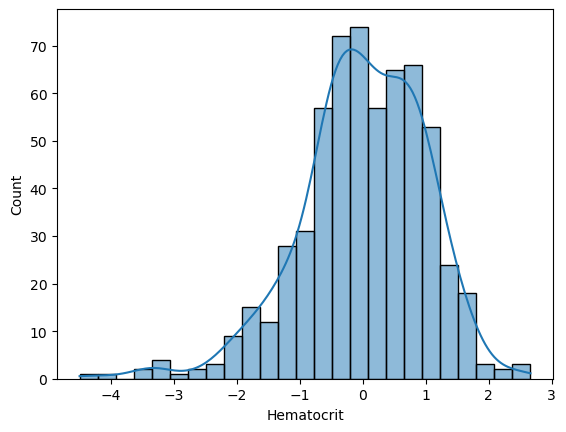

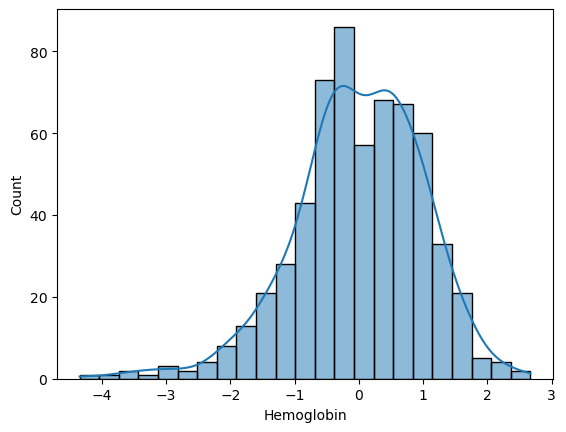

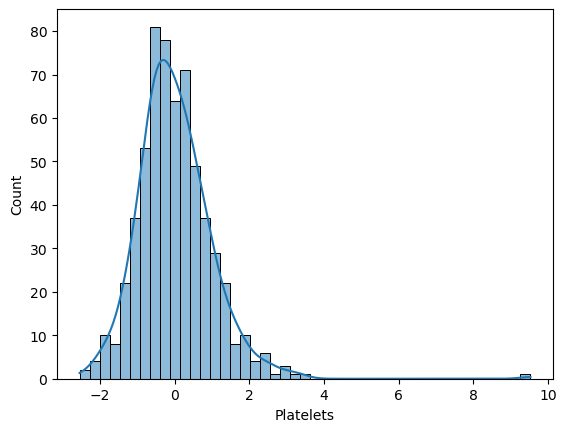

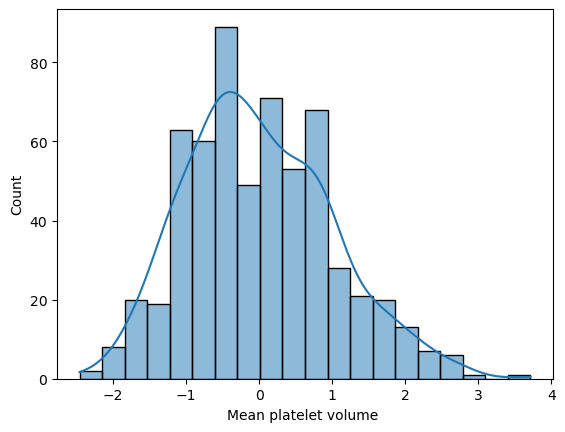

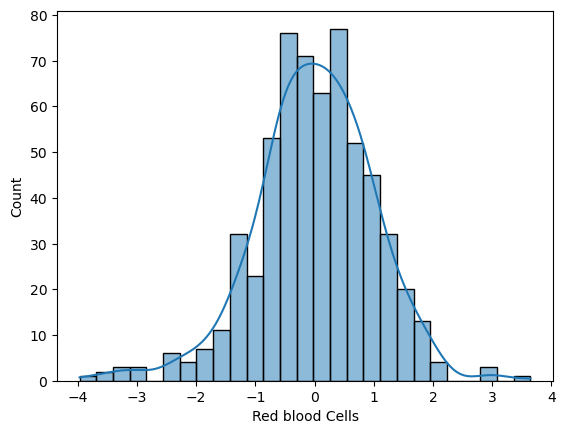

...

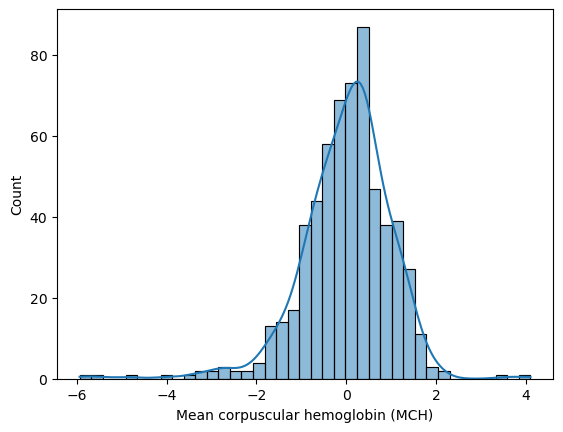

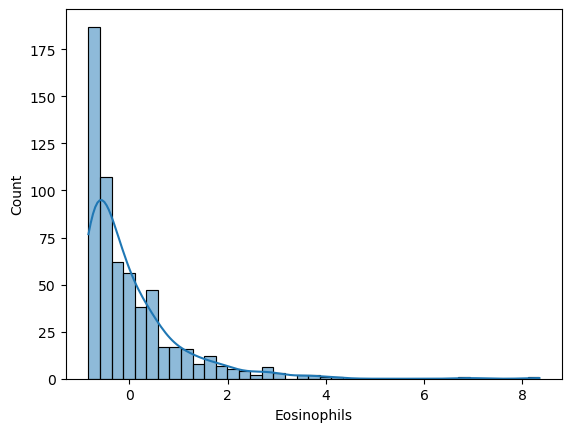

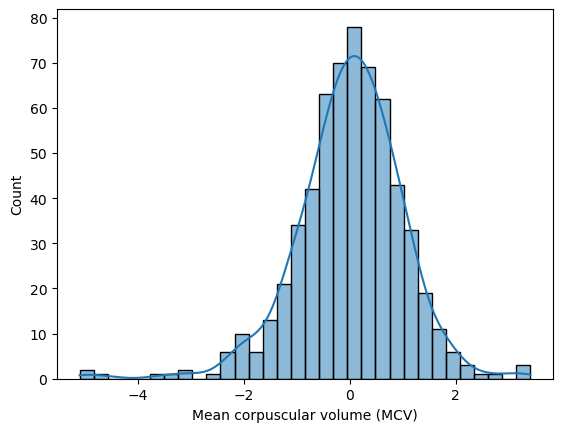

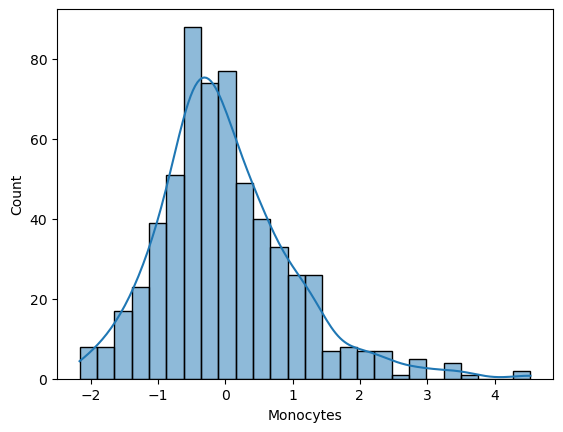

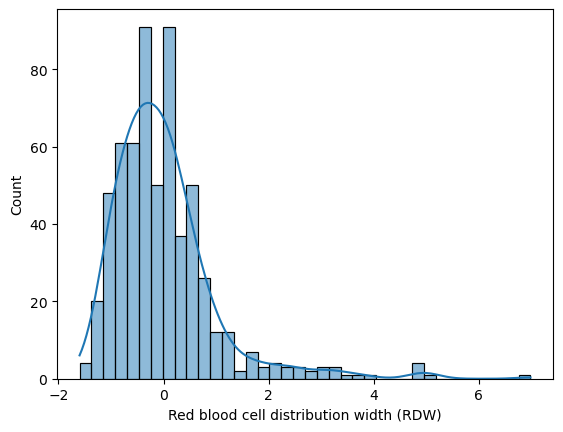

In [26]:
for col in df.select_dtypes('float'):
    plt.figure()
    sns.histplot(df[col], kde=True)

Et donc, on obtient la distribution de nos différentes variables. 
- La première chose qu'on voit, c'est que toutes nos courbes sont centrées en 0 et elles ont l'air d'avoir un écart-type égal à 1. Ce qui nous laisse immédiatement comprendre que ces données ont été standardisées. C'est important à savoir. 
- Maintenant, on peut aussi voir que pas mal de ces variables suivent une distribution normale, mais pas toutes. Là, on a des distributions asymétriques, c'est quelque chose d'intéressant. 

#### 3.4.4 Analyse du quantile "Âge"

Nous allons travailler sur une autre variable que nous n'avons pas encore examinée jusqu'à présent : "Patient age quantile". Cela va être intéressant. 

Comme précédemment, nous pouvons commencer simplement par refaire un "hisplot" de cette variable. 

<Axes: xlabel='Patient age quantile', ylabel='Count'>

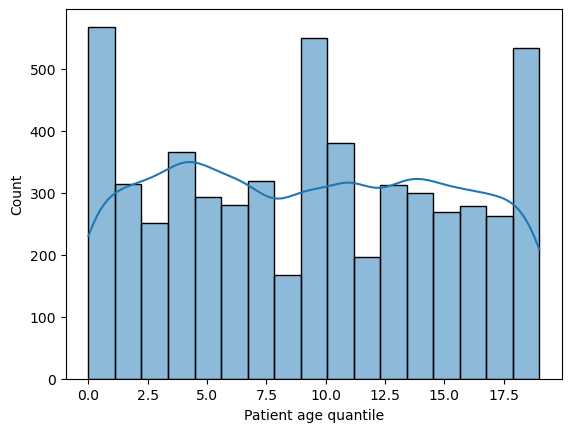

In [27]:
sns.histplot(df['Patient age quantile'], kde=True)

Et là, nous obtenons quelque chose d'assez intéressant. 

Cela peut sembler curieux au premier abord. Quelles sont ces valeurs ? Pourquoi cela va-t-il de zéro jusqu'à 19 ou 20 ? Pourquoi la répartition ressemble-t-elle à ceci ? 

Eh bien, malheureusement, la personne qui a posté ce dataset sur Kaggle n'a laissé aucune information au sujet de cette variable. Tout ce que nous pouvons faire, c'est émettre des hypothèses. Nous n'aurons jamais la réponse absolue. Nous pourrions supposer que, étant donné que l'âge d'un individu varie généralement de zéro à 100 ans, il s'agit peut-être de tranches d'âge. 

Ainsi, zéro correspondrait aux personnes âgées de 0 à 5 ans, 1 à celles de 5 à 10 ans, 2 de 10 à 15 ans, etc. 

Mais cela n'est qu'une hypothèse. Nous ne pouvons pas savoir avec certitude si c'est le cas, ou si cette variable a été mathématiquement transformée, par exemple quantifiée. C'est tout à fait possible. Nous ne pouvons pas le savoir. 

Concernant "Patient age quantile", nous pouvons conclure qu'il est difficile d'interpréter ce graphique. Il est évident que les données ont été modifiées, mais la personne qui a mis en ligne le dataset ne l'a précisé nulle part. 

Cependant, ce n'est pas très important. À ce stade, nous avons visualisé des données continues et nous avons également observé "Patient age quantile", car ils n'étaient pas inclus dans les floats.

#### 3.4.5 Analyse des Variables Discrètes : qualitatives

À ce stade, nous avons visualisé des données continues, et nous avons également observé l'âge quantile, puisqu'il n'était pas intégré dans les floats. 

Il nous reste maintenant à visualiser les variables catégorielles, donc de type object. 

La question que vous vous posez peut-être est : comment visualise-t-on des variables qualitatives ou des variables catégorielles ? Eh bien, ce que je vous conseille de faire, c'est de commencer par simplement vérifier les différentes catégories présentes dans chaque variable. 

Par exemple, pour notre variable "target", il y a deux catégories : la catégorie "positif" et la catégorie "négatif". Pour visualiser tout ça, nous pourrions utiliser value_counts, mais je préfère la fonction np.unique. 
Cette fonction est aussi disponible dans Pandas. 

À titre d'exemple, si on utilise cette fonction sur notre target, cela nous retourne un tableau qui précise les deux catégories présentes dans cette variable. 

In [28]:
df['SARS-Cov-2 exam result'].unique()

array(['negative', 'positive'], dtype=object)

In [29]:
for col in df.select_dtypes('object'):
    print(f'{col :-<50} {df[col].unique()}') ## permet de créer un système de marge

SARS-Cov-2 exam result---------------------------- ['negative' 'positive']
Respiratory Syncytial Virus----------------------- [nan 'not_detected' 'detected']
Influenza A--------------------------------------- [nan 'not_detected' 'detected']
Influenza B--------------------------------------- [nan 'not_detected' 'detected']
Parainfluenza 1----------------------------------- [nan 'not_detected' 'detected']
CoronavirusNL63----------------------------------- [nan 'not_detected' 'detected']
Rhinovirus/Enterovirus---------------------------- [nan 'detected' 'not_detected']
Coronavirus HKU1---------------------------------- [nan 'not_detected' 'detected']
Parainfluenza 3----------------------------------- [nan 'not_detected' 'detected']
Chlamydophila pneumoniae-------------------------- [nan 'not_detected' 'detected']
Adenovirus---------------------------------------- [nan 'not_detected' 'detected']
Parainfluenza 4----------------------------------- [nan 'not_detected' 'detected']
Coronavirus2

En analysant les variables, nous constatons que ce sont principalement des variables binaires. 

Seulement une variable tout en bas possède une seule valeur. Cette variable, en l'occurrence, ne nous sera d'aucune utilité. 

- La première étape lors de l'analyse des variables qualitatives est de déterminer les différentes catégories présentes dans chaque variable. C'est très important. 
- Ensuite, nous pouvons compter le nombre de valeurs présentes dans chaque catégorie. 

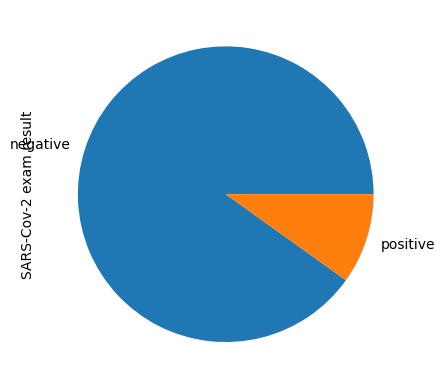

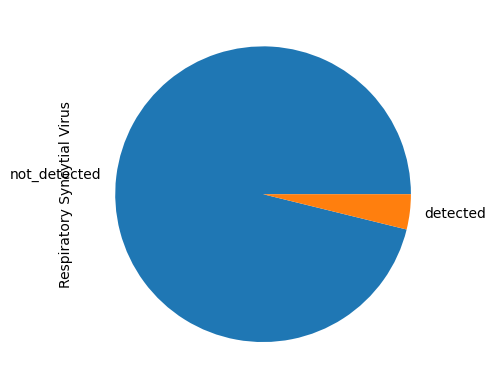

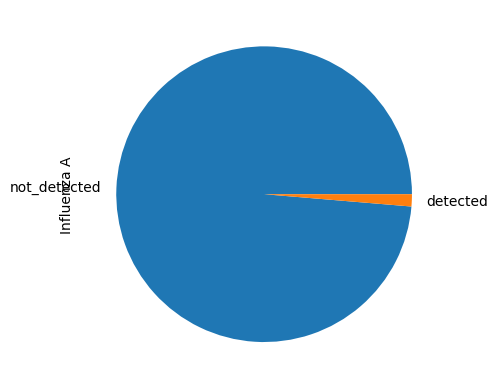

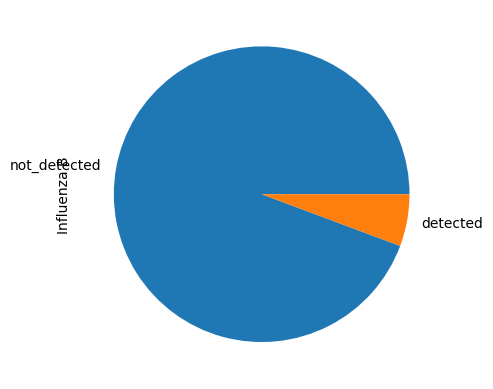

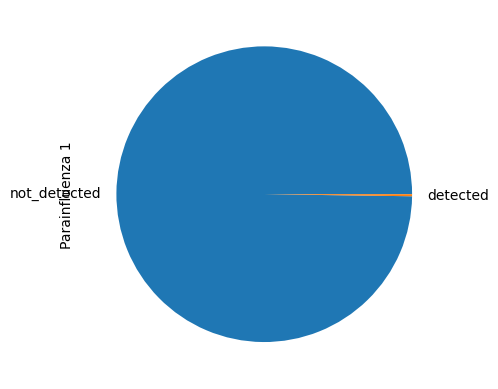

...

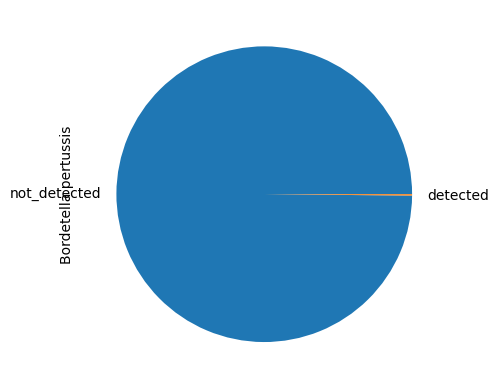

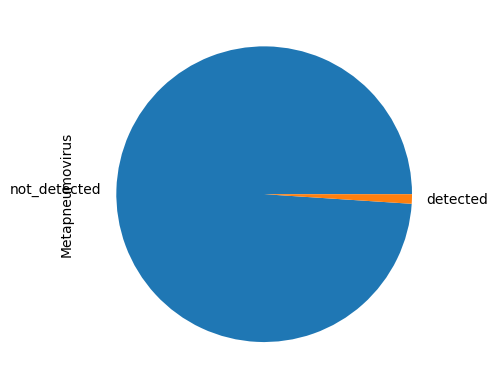

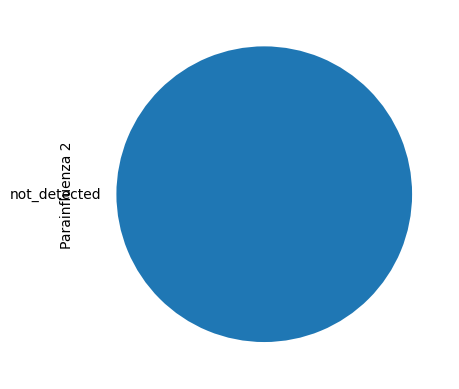

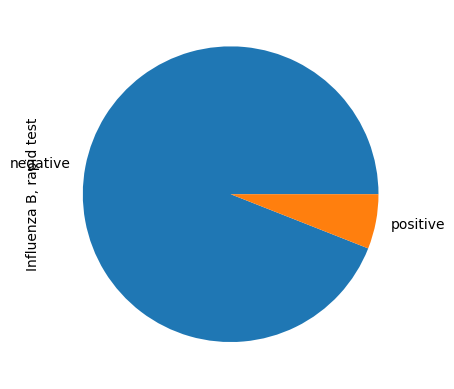

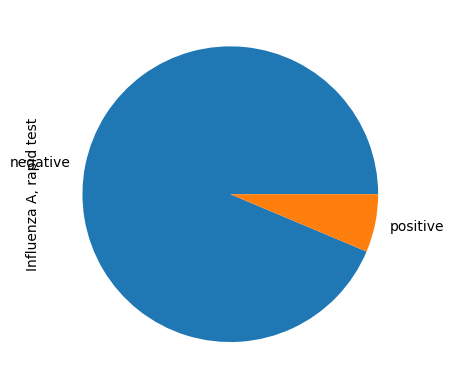

In [30]:
for col in df.select_dtypes('object'):
    plt.figure()
    df[col].value_counts().plot.pie()

En affichant ces données sous forme de graphiques "camembert", nous pouvons observer que la majorité des tests viraux sont négatifs, à l'exception notable du rhinovirus et de l'entérovirus. 

En conclusion, pour les variables qualitatives, elles sont principalement binaires. Le rhinovirus est particulièrement prévalent.

Cela conclut notre analyse des variables discrètes. Nous avons examiné à la fois nos variables continues et qualitatives. 

Je n'ai pas encore analysé certaines variables telles que si le patient est admis en soins réguliers, semi-intensifs, ou en soins intensifs. 

Je réserve cette analyse pour une section ultérieure, plus détaillée. En attendant, il nous reste une dernière étape à compléter sur notre liste de vérification.

#### 3.4.6 Relation variables/target

**Création de sous-ensembles**

L'objectif principal est de visualiser la relation entre nos variables et notre target. Étant donné qu'ici on a deux groupes d'individus (les individus positifs et les individus négatifs), je vais commencer par créer des sous-ensembles "positifs" et "négatifs" pour faciliter l'analyse ultérieure. 

Pour faire ça avec Pandas, en général, on utilise la technique du "boolean indexing". Si on sélectionne notre colonne "score résulte" et qu'on veut tous les cas qui sont positifs, on écrit comme ceci : on fait du "boolean indexing". 

Et ce que l'on fait ensuite, c'est d'intégrer cette condition dans notre dataframe. 

C'est toujours la même technique que l'on utilise avec les fonctions quand celle-ci est vérifiée. 

In [31]:
df[df['SARS-Cov-2 exam result'] == 'positive']

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
67,7,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
284,16,positive,1,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN
513,10,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN
568,2,positive,0,0,0,0.991838,0.792188,-0.341548,1.469188,1.653476,-0.048383,-0.452899,-0.420197,1.303529,-1.442245,-0.498393,-1.396114,1.933339,0.967144,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN
676,15,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5632,16,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5633,4,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5634,15,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5639,3,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [32]:
df[df['SARS-Cov-2 exam result'] == 'negative']

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
0,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative
2,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5637,12,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5638,14,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5640,17,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5641,4,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


À la fin de cette étape, on obtient un dataframe avec seulement 558 lignes. 

On va nommer ce dataframe "positive_df" et on va reproduire la même démarche pour obtenir un dataframe "negative_df".

In [33]:
positive_df = df[df['SARS-Cov-2 exam result'] == 'positive']

negative_df = df[df['SARS-Cov-2 exam result'] == 'negative']

**Création des ensembles Blood et viral**

Maintenant, après avoir fait ça, on pourrait se demander pourquoi ne pas créer des sous-ensembles "blood" et "virales", puisqu'on avait clairement identifié dès le début ces deux catégories de variables. 

Alors, allons-y! De plus, on peut faire cela en utilisant simplement des calculs basés sur le nombre de valeurs manquantes qu'on a dans chaque variable. Puisqu'on avait identifié que "blood" avait en général 89% de variables avec des valeurs manquantes et "virales" était aux alentours de 76%.

Vous vous rappelez qu'auparavant on avait calculé le taux de valeurs manquantes avec une certaine expression. Eh bien, on va enregistrer ce résultat dans une variable qui s'appelle "missing_rates". 

In [34]:
missing_rate = df.isna().sum()/df.shape[0]

Ainsi, on peut filtrer notre dataframe en écrivant, par exemple, qu'on veut tous les cas où "missing_rates" sont inférieurs à 0,9 mais également tous les cas où "missing_rates" sont supérieurs à 0,88. 

In [35]:
(missing_rate < 0.9) & (missing_rate > 0.88)

Patient age quantile                                     False
SARS-Cov-2 exam result                                   False
Patient addmited to regular ward (1=yes, 0=no)           False
Patient addmited to semi-intensive unit (1=yes, 0=no)    False
Patient addmited to intensive care unit (1=yes, 0=no)    False
Hematocrit                                                True
Hemoglobin                                                True
Platelets                                                 True
Mean platelet volume                                      True
Red blood Cells                                           True
Lymphocytes                                               True
Mean corpuscular hemoglobin concentration (MCHC)          True
Leukocytes                                                True
Basophils                                                 True
Mean corpuscular hemoglobin (MCH)                         True
Eosinophils                                            

Avec cette technique, on obtient la liste de colonnes suivante, qui correspond à toutes nos colonnes de type tests sanguins. 

Nous allons donc créer une variable "blood_columns" qui équivaut à ces colonnes. 

Ensuite, on peut faire la même chose pour une autre variable "viral_columns", mais cette fois avec des taux différents, c'est-à-dire inférieurs à 0,88 et supérieurs à 0,75.

In [36]:
blood_columns = df.columns[(missing_rate < 0.9) & (missing_rate >0.88)]

viral_columns = df.columns[(missing_rate < 0.88) & (missing_rate > 0.75)]

#### 3.4.7 Analyse Target / Variables Blood

Maintenant que nous avons créé ces sous-ensembles, nous allons pouvoir visualiser les relations entre la target et les variables de façon ultra-efficace et rapide. 

Vous allez voir. Nous commencerons par visualiser la relation entre la target et le sang. 

Pour cela, nous créerons une boucle for, comme précédemment. 

Nous utiliserons sns.histplot, un diagramme de distribution, mais nous séparerons les cas positifs des cas négatifs. 

Nous ferons un plot de positive_df dans lequel nous sélectionnerons notre colonne, et nous ajouterons un label indiquant que ce sont des cas positifs. 

Nous copierons ensuite cette ligne pour les cas négatifs. Après avoir ajouté une figure et une légende, nous obtiendrons les graphiques suivants.

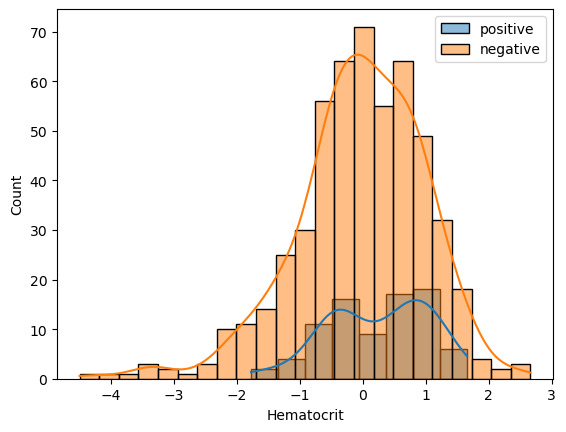

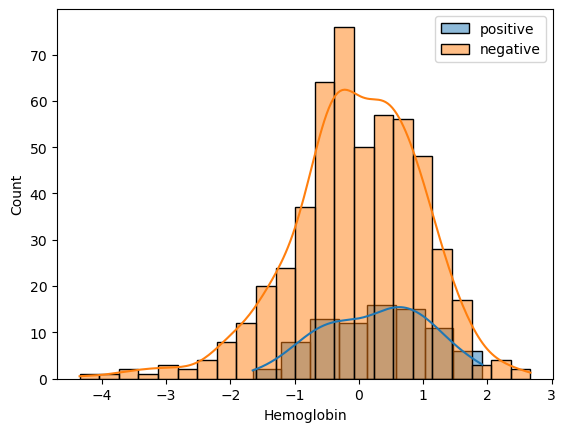

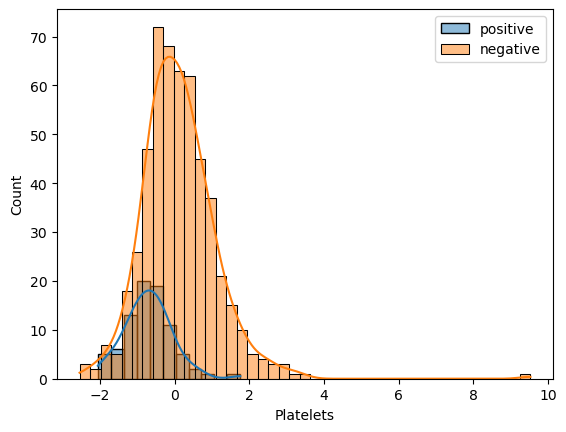

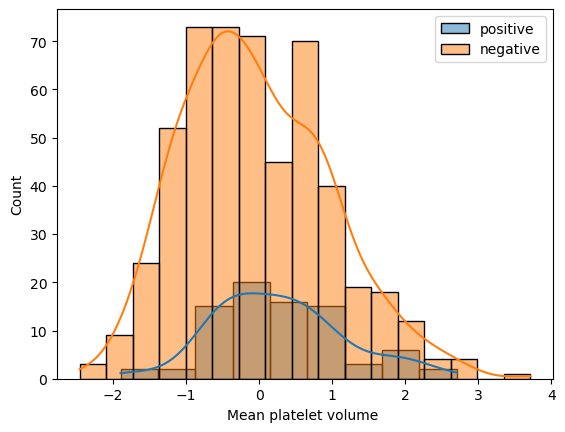

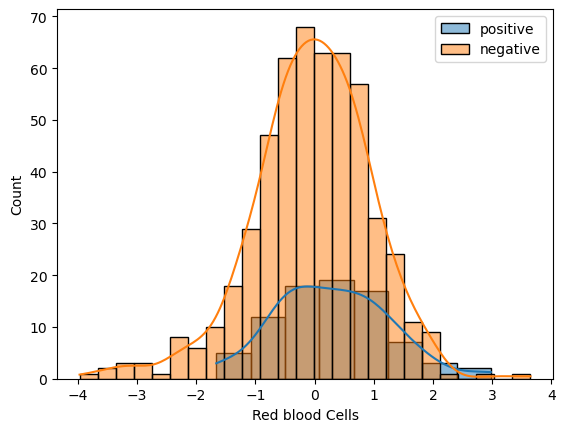

...

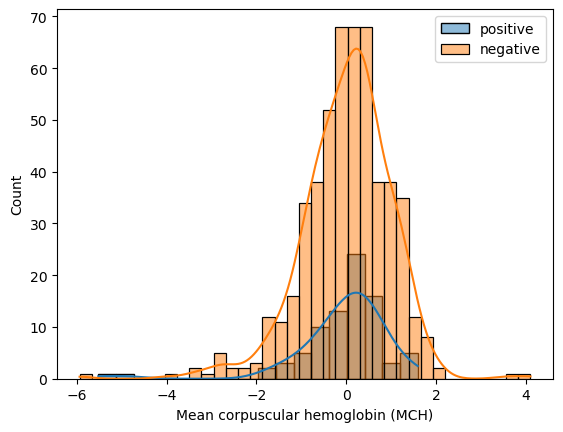

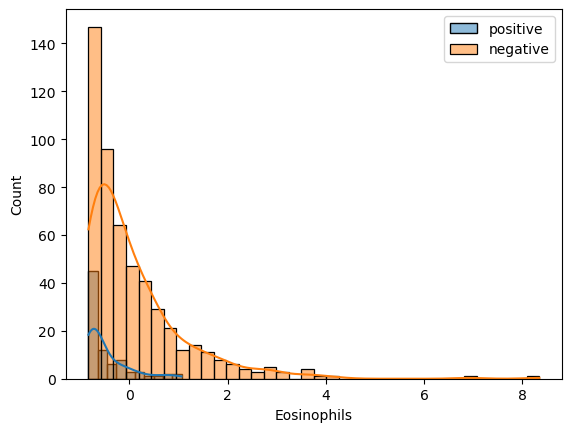

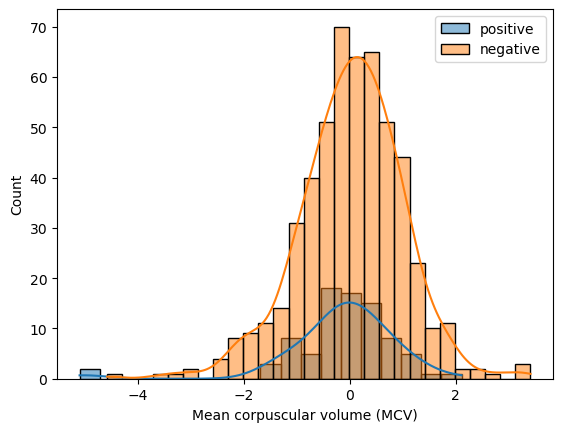

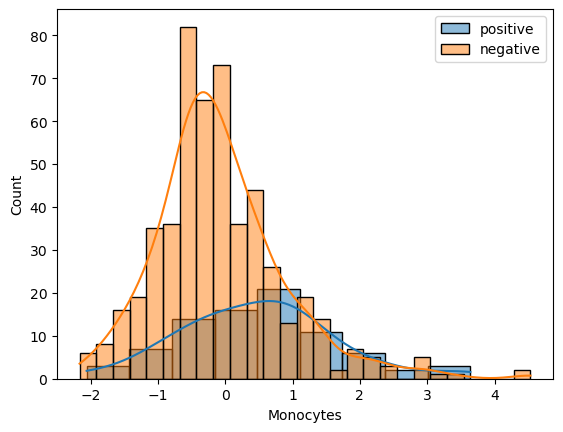

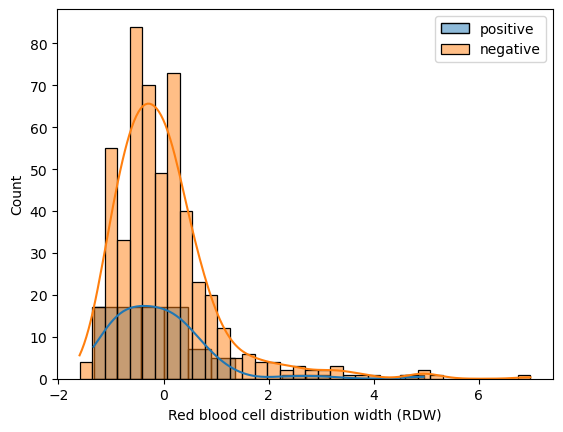

In [37]:
for col in blood_columns:
    plt.figure()
    sns.histplot(positive_df[col], label='positive', kde=True)
    sns.histplot(negative_df[col], label='negative', kde=True)
    plt.legend()

Là, cela devient intéressant. Nous pouvons observer, variable par variable, s'il y a une différence entre les cas positifs et négatifs. 

Par exemple, sur certains graphiques, nous ne voyons rien de spécial, mais sur d'autres, nous commençons à observer des différences. 

En prenant des notes, nous remarquons que les personnes atteintes du coronavirus, les cas positifs, semblent avoir des taux de Platelets très différents de ceux qui sont négatifs. C'est une observation intéressante. Si nous voulons confirmer cette observation, il nous faudra la transformer en hypothèse et la tester. C'est quelque chose que nous ferons plus tard en détail. 

Pour l'instant, dans nos notes, nous écrirons qu'il semble y avoir une différence concernant les plaquettes et que nous devons tester cette hypothèse.

Ensuite, en examinant les athlètes, le volume, les red blood cells, et les lymphocytes, nous trouvons des observations similaires. En particulier, pour les leucocytes et les monocytes, nous voyons également une différence. La conclusion de cette partie est qu'il semble que les taux de monocytes, de plaquettes, et de leucocytes soient liés au COVID-19. Nous testerons cette hypothèse plus tard.

Ce sont les premières conclusions intéressantes de cette analyse approfondie. Ensuite, nous tenterons de visualiser la relation entre...

#### 3.4.8 Analyse Target / Age

Pour analyser la relation entre la target et l'âge, nous pourrions reprendre le code que nous avons déjà établi. 

Cependant, je vais vous présenter une autre fonction de Seaborn très utile, une fonction que vous devriez ajouter à votre boîte à outils de data analyst : sns.catplot. 

Si vous avez un doute sur comment l'utiliser dans Jupyter, utilisez simplement Shift + Tab, et vous verrez comment s'en servir. 

Donc, il faut préciser x, y et data. Nous allons définir x comme étant la colonne 'age', y comme la colonne 'exam_result', et pour data, nous prendrons le dataframe complet, df. 

<Axes: xlabel='Patient age quantile', ylabel='count'>

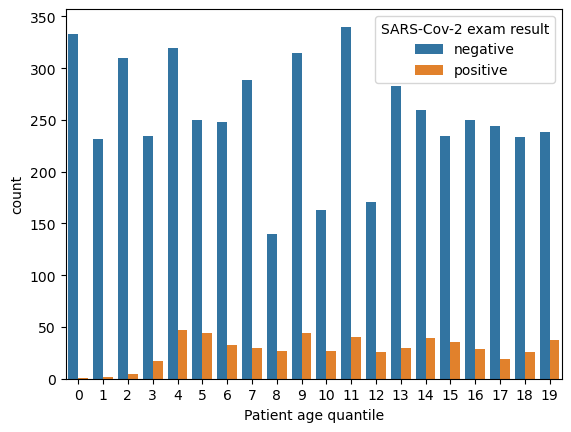

In [38]:
sns.countplot(x='Patient age quantile', hue='SARS-Cov-2 exam result', data=df)

 En exécutant cela, nous obtenons un graphique où nous comptons le nombre d'apparitions de chaque patient en fonction de son âge pour les résultats positifs et négatifs. Retenez cette fonction, elle est très pratique.

Que nous révèle ce graphique? Il suggère quelque chose de perturbant : il semble que l'âge soit lié à la probabilité d'être positif ou négatif au coronavirus. Cependant, nous ne connaissons pas vraiment la variable 'age', et nous ne savons pas exactement ce qu'elle représente. 

Nous avons seulement émis des hypothèses. Toute décision basée sur ces observations serait risquée. Par exemple, il serait erroné de conclure que les catégories 0, 1, 2, 3, 4 représentent des individus de moins de 20 ans. 

De plus, il serait incorrect de dire que les enfants ou les mineurs ne sont pas affectés par le coronavirus. Nous savons depuis un moment que les mineurs peuvent aussi être infectés par ce virus. L'âge n'a pas d'importance en soi.

Pourquoi alors observe-t-on moins de patients dans les catégories d'âge 0, 1, 2, 3 par rapport aux autres catégories sur ce graphique? Nous ne pouvons pas l'affirmer avec certitude. La moindre supposition serait risquée. Cependant, cela ne signifie pas que nous devons écarter cette variable. Elle pourrait être utile, et nous le verrons lors de l'analyse plus détaillée. 

Nous avons donc ajouté à nos notes ce que nous venons d'observer concernant la relation entre la target et l'âge.

#### 3.4.8 Analyse Target / Viral


Maintenant, nous allons conclure cette analyse basique en examinant la relation qu'il y a entre notre target et les variables qualitatives, c'est-à-dire les tests viraux. 

Est-ce que l'individu a telle ou telle maladie ? Pour cela, lorsque nous souhaitons comparer deux catégories (car notre target est une catégorie et nos tests viraux le sont également), nous utilisons en statistiques ce qu'on appelle une "cross tab". 

C'est le nom utilisé dans pandas, et c'est un outil essentiel à ajouter dans votre boîte à outils de data scientist. 

Vous tapez pd.crosstab et à l'intérieur, vous définissez les deux variables qualitatives que vous voulez comparer. Par exemple, on peut vouloir comparer notre target avec le virus "influenza A".

In [39]:
pd.crosstab(df['SARS-Cov-2 exam result'], df['Influenza A'])

Influenza A,detected,not_detected
SARS-Cov-2 exam result,,
negative,18,1224
positive,0,112


Cela nous donne la table suivante où l'on peut observer les croisements pour les cas positifs et négatifs des deux virus. Par exemple, 18 personnes contaminées par l'influenza A sont négatives pour le coronavirus.

Pour automatiser ce processus, nous pouvons créer une boucle "for" qui parcourt les différentes variables dans viral_cols. 

Nous créons une crosstab pour chaque colonne et utilisons sns.heatmap pour visualiser les résultats. 

J'ai ajouté des annotations à la heatmap pour afficher les nombres et j'ai souhaité afficher ces nombres en entier.

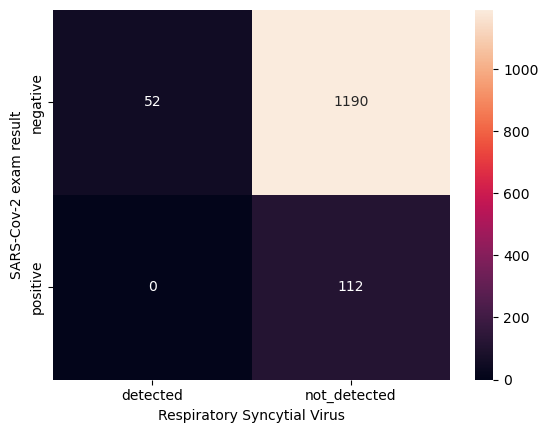

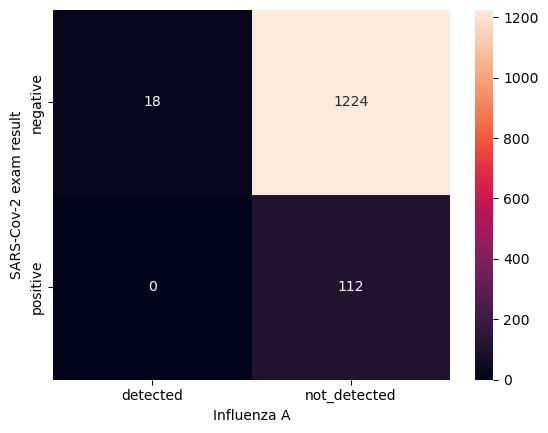

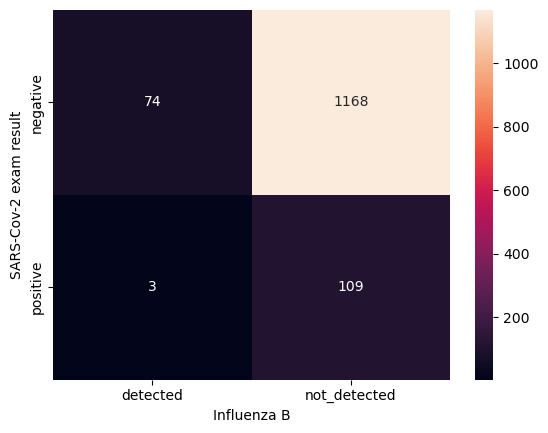

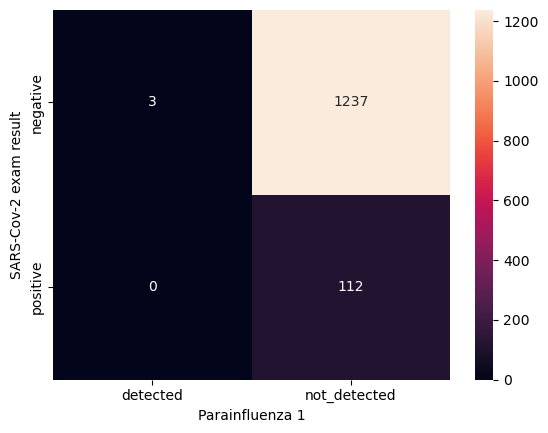

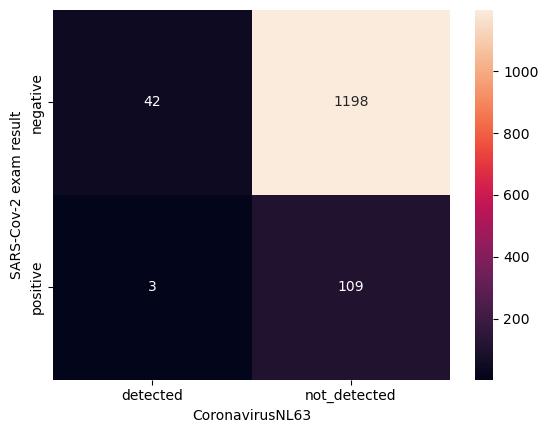

...

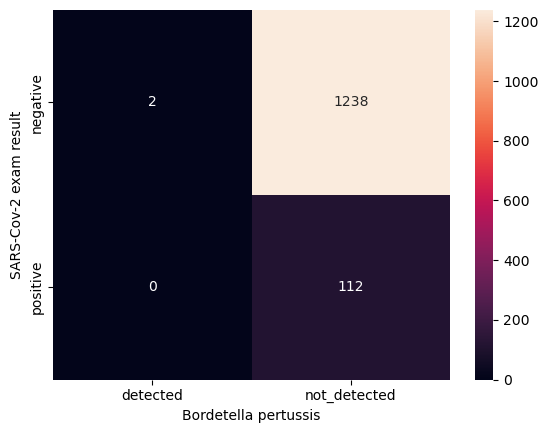

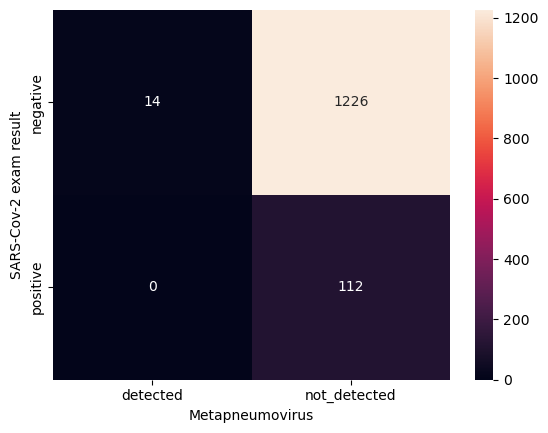

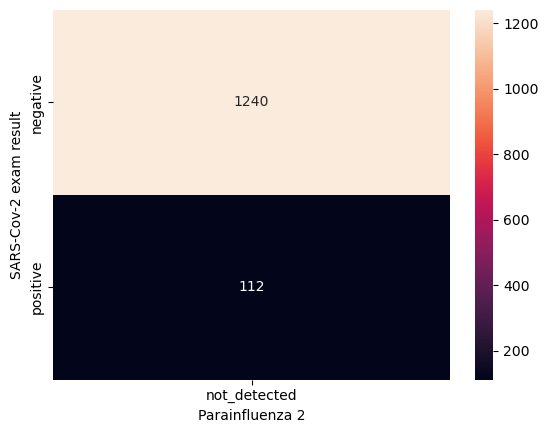

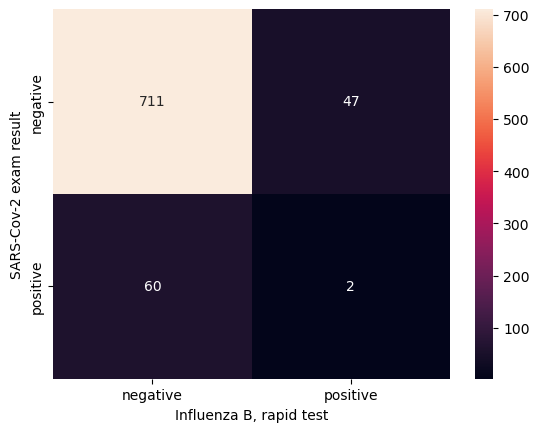

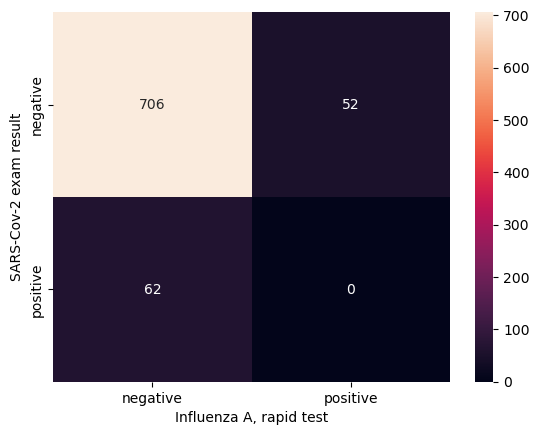

In [40]:
for col in viral_columns:
    plt.figure()
    sns.heatmap(pd.crosstab(df['SARS-Cov-2 exam result'], df[col]), annot=True, fmt='d')

En analysant nos crosstabs, nous observons, sans grande surprise, que très peu de personnes ont deux virus en même temps, bien que ce ne soit pas biologiquement impossible. 

Par contre, il y a quelque chose de curieux concernant le rhinovirus : de nombreuses personnes qui sont venues à l'hôpital avec le rhinovirus n'ont pas le coronavirus. Pourtant, il ne faut pas se précipiter à conclure que si on a le rhinovirus, on ne peut pas avoir le coronavirus. Il se pourrait que le rhinovirus soit simplement plus courant dans la région concernée.

Nous devons éviter de tirer des conclusions hâtives. Par exemple, nous avons une variable où il n'y a qu'une seule valeur, celle-ci sera donc éliminée d'office. En résumé, il est important de noter que les doubles infections sont rares et, même si le rhinovirus est courant dans l'hôpital étudié, cela ne signifie pas qu'il y a un lien avec le coronavirus. Il est possible d'avoir plusieurs épidémies en même temps sans qu'elles soient liées. Il ne faut pas faire de conclusions fallacieuses. 

Même s'il y a une hypothèse à tester, je n'ai pas l'intention de le faire à ce stade. Il est essentiel de rester pragmatique.

### 3.4 Conclusions de base

Donc, en conclusion de cette analyse initiale, nous avons pu constater qu'il manque beaucoup de données. Dans le meilleur des cas, nous allons pouvoir garder seulement 10 à 20% de notre dataset. 

Nous avons pu identifier notre target, réaliser l'analyse de forme, et distinguer deux groupes de données très utiles. 

Nous avons remarqué qu'il y a seulement environ 10% de cas positifs dans notre dataset. 

De plus, nous avons effectué une série d'analyses très intéressantes sur nos différentes variables. Cette analyse nous a permis de constater qu'il y a peu de variables qui nous permettront de réellement différencier les gens qui ont le COVID-19 de ceux qui ne l'ont pas. 

Cependant, ce n'est pas une raison pour abandonner le projet. Nous avons un objectif et nous irons jusqu'au bout. 

Si nous pensons qu'il est trop complexe de prédire le COVID-19 avec les données cliniques dont nous disposons, eh bien, nous irons jusqu'au bout pour démontrer pourquoi c'est trop complexe. 

Nous essaierons de comprendre ce qui ne va pas, ce qu'il faudrait ajouter, s'il nous faut davantage de données ou si notre modèle sera en overfitting. 

C'est cela le machine learning. Honnêtement, c'est l'une des choses les plus importantes que vous devez retenir. 

### 3.5 Analyse plus détaillée

Dans cette analyse un peu plus détaillée, nous allons nous intéresser à la relation entre variables. 

Ce que nous avions fait jusqu'à présent, c'était d'analyser les variables elles-mêmes, voir leur distribution, ce genre de choses. 

Ensuite, l'étape suivante est d'analyser les relations target-variable. 

Puis, généralement, l'étape supérieure est d'analyser les relations entre nos différentes variables. 
Mais nous ne faisons pas ça n'importe comment. Nous allons le faire par catégorie. 

Ainsi, 

- nous commencerons par visualiser les relations entre nos différentes variables de taux sanguin. 

- Ensuite, nous visualiserons les relations entre ces variables et l'âge des individus. Nous essaierons, par exemple, de voir si, au fur et à mesure qu'un individu vieillit, certains taux, comme ceux de globules blancs ou de je ne sais quoi, diminuent ou augmentent. Cela pourrait être intéressant. 

    Nous tenterons de voir s'il y a des éléments intéressants au sein des variables virales, et ainsi de suite. 
    Nous testerons différentes idées et essayerons d'explorer notre dataset, de trouver des idées, de visualiser certaines données. 

- Ensuite, nous procéderons à une analyse un peu plus approfondie des valeurs en compte de notre dataset. 

- Et pour finir, nous testerons quelques hypothèses, comme par exemple, si les individus atteints du COVID-19 ont des taux de leucocytes, monocytes et plaquettes significativement différents de ceux qui n'ont pas le COVID-19. C'est quelque chose que nous avions observé précédemment sur ces graphiques. À l'époque, nous disions : "Wow, c'est fou ! Les leucocytes sont très différents." Mais sont-ils réellement significativement différents? 

Nous allons le tester avec un test statistique. Je vous propose de commencer par les relations liées aux données sanguines. 

Est-ce que vous vous souvenez de la fonction magique de Seaborn appelée "pairplot" ? Nous allons l'utiliser.

#### 3.5.1 Check list

**Analyse plus détaillée**
- **Relation Variables / Variables** : 
    - blood_data / blood_data : certaines variables sont tres corrélées : +0.9 (a suveiller plus tard)
    - blood_data / age : tres faible corrélation entre age et taux sanguin.
    - viral / viral : influenza rapid test donne de mauvais résultats, il fauda peut-etre la laisser tomber
    - relation maladie / blood data : Les taux sanguins entre malades et covid-19 sont différents
    - relation hospitalisation / blood : intéressant dans le cas ou on voudrait prédire dans quelle service un patient devrait aller
    - relation hospitalisation / blood :
- **NaN analyse** : viral : 1350(92 / 8), blood : 600(87 / 13), both : 90

**Hypotheses nulle H(0) :**
- Les individus atteints du covid-19 ont des taux de Leukocytes, Monocytes, Platelets significativement différents
- Les individus atteints d'une quelconque maladie ont des taux significativement différents

#### 3.5.2 Matrice de corrélation (Variables Sanguines)

Souvenez-vous, cette fonction est vraiment magnifique. 

Le problème, c'est que beaucoup de gens tentent de l'utiliser dès le début d'un projet data en se disant : "Ok, je lance cette 'pairplot' directement". 

ais non, cela ne peut pas fonctionner ainsi. Si vous voulez utiliser "pairplot", il faut filtrer votre dataset, exactement comme nous l'avons fait ici avec des données de taux sanguins. Ce sera parfait avec "pairplot". Lorsque nous lançons sns.pairplot, nous obtenons un graphique très intéressant.

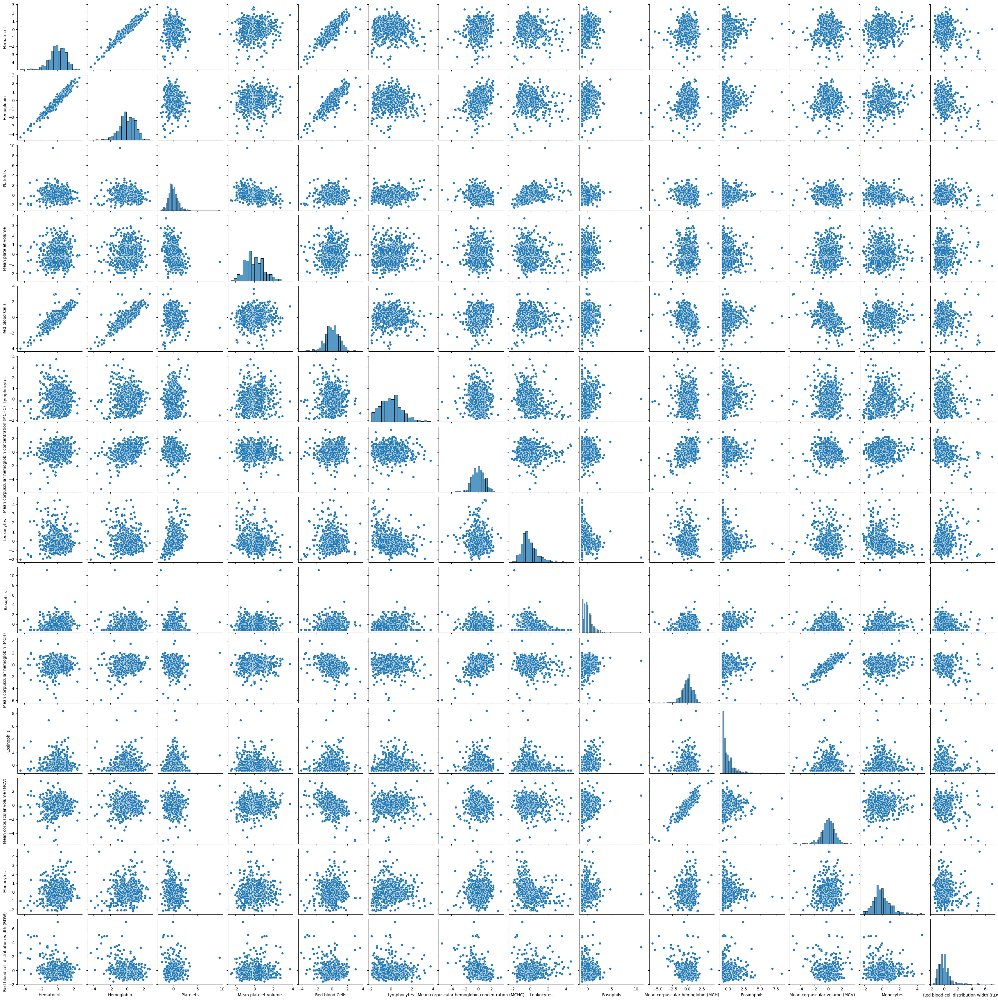

In [41]:
sns.pairplot(df[blood_columns])

Ce graphique pourrait être analysé pendant des heures, mais je vous rassure, nous ne le ferons pas. 

Ce que nous pouvons observer, ce sont les relations linéaires entre certaines variables, comme par exemple les variables d'hémoglobine situées tout en haut. 

Cependant, je vais vous montrer une manière bien plus rapide d'analyser ce graphique : en utilisant une heatmap qui affiche la matrice de corrélation. 

<Axes: >

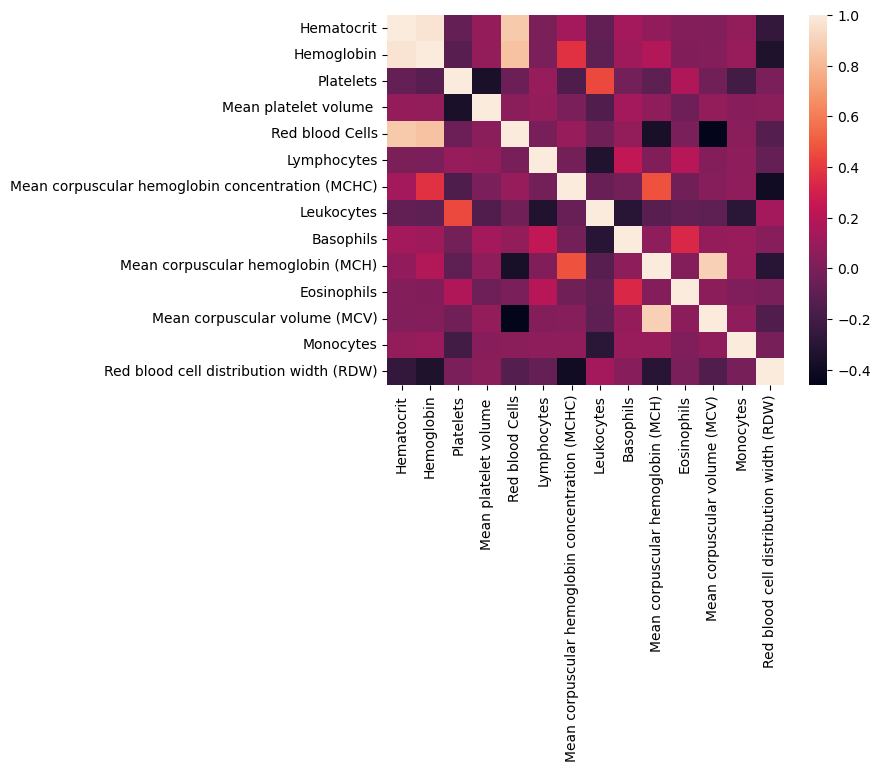

In [42]:
sns.heatmap(df[blood_columns].corr())

La fonction corr est extrêmement utile. Elle nous montre précisément le tableau avec les corrélations. Plus une corrélation est proche de 1, plus les deux variables évoluent positivement ensemble. Par exemple, l'hémoglobine et l'hématocrite (je ne sais pas ce que c'est exactement) sont fortement corrélés. 

A ce stade, nous ne prenons pas de décisions. Nous collectons simplement des informations pour prendre des décisions ultérieurement.

Il existe une autre fonction de Seaborn très utile : "clustermap". 

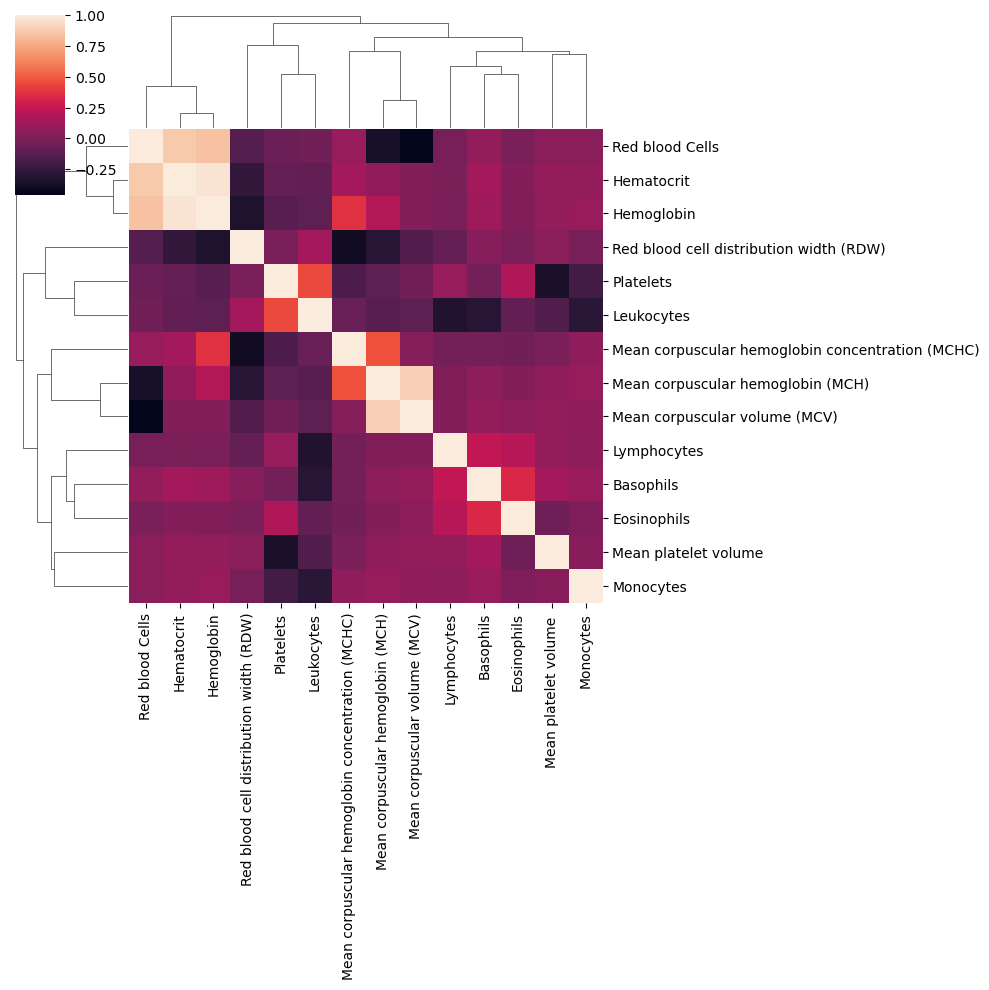

In [43]:
sns.clustermap(df[blood_columns].corr())

Elle regroupe vos variables et les organise pour créer des clusters. 

Nous pouvons observer que certaines variables sont très corrélées entre elles. 

Bien que nous ne puissions pas encore déterminer comment cette information nous sera utile, c'est un élément crucial pour la prise de décision, en particulier lors de la modélisation. Dans nos notes, nous pouvons noter que certaines variables ont une corrélation supérieure à 0,92, ce qui est à surveiller pour la suite. 

Ces informations sont très précieuses.

#### 3.5.4 Relation Blood / Age

Examinons la relation qu'il y a entre le sang et l'âge de l'individu. Pour ce faire, tout comme précédemment, nous allons créer une boucle : for columns in blood_columns. Nous allons ensuite utiliser une nouvelle fonction de Seaborn, que nous n'avons pas encore abordée dans cette formation : la fonction lmplot. 

Cette dernière nous permet de visualiser des courbes de régression dans des nuages de points. 

Nous utiliserons cette fonction pour afficher, en abscisse, l'âge d'un patient et, en ordonnée, la variable de sang concernée. En distinction, nous utiliserons les cas positifs et les cas négatifs au coronavirus, le tout basé sur notre dataset.

<Figure size 640x480 with 0 Axes>

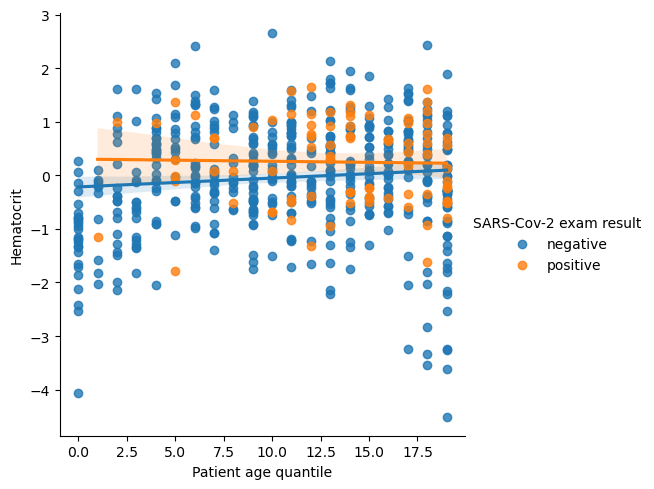

<Figure size 640x480 with 0 Axes>

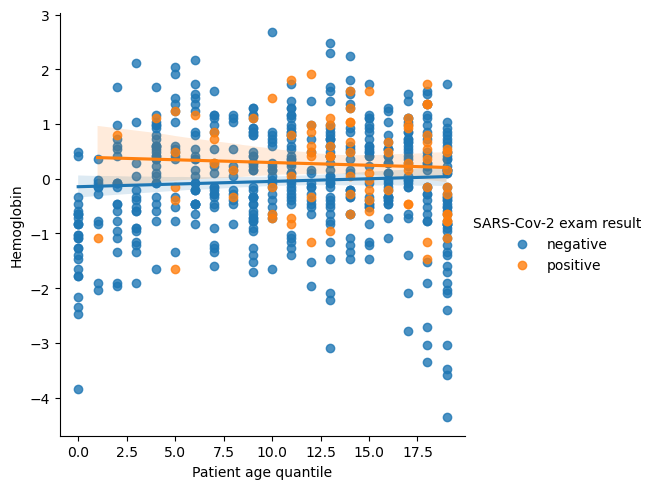

<Figure size 640x480 with 0 Axes>

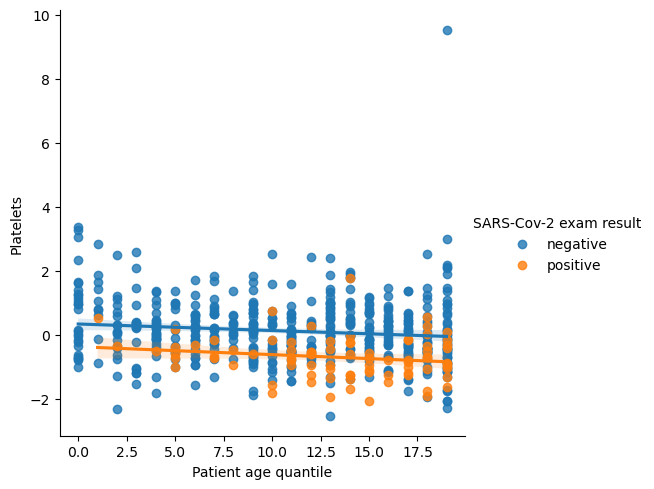

<Figure size 640x480 with 0 Axes>

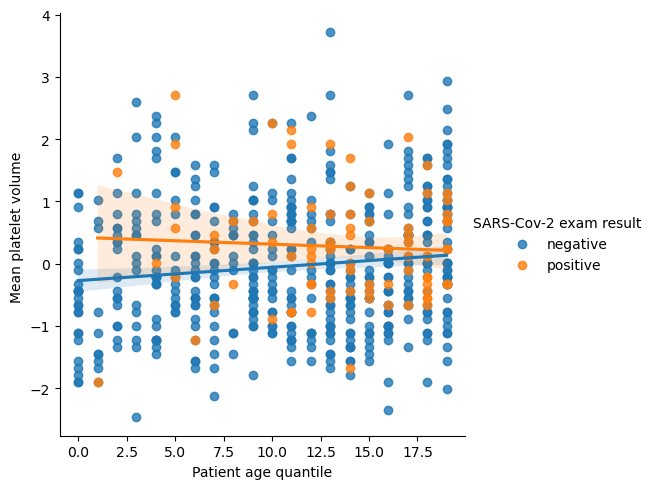

<Figure size 640x480 with 0 Axes>

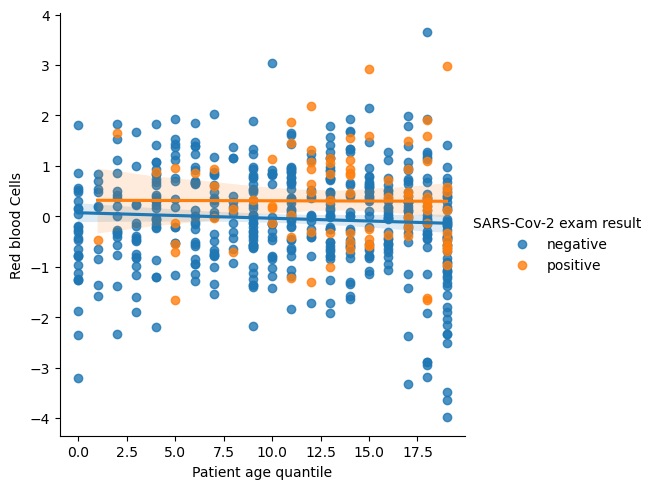

<Figure size 640x480 with 0 Axes>

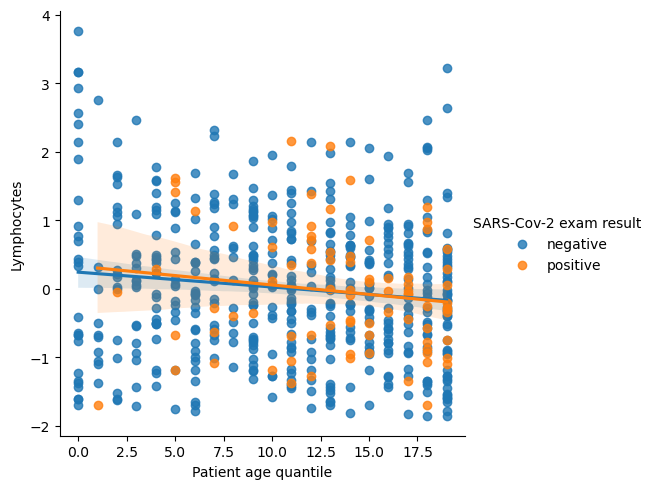

<Figure size 640x480 with 0 Axes>

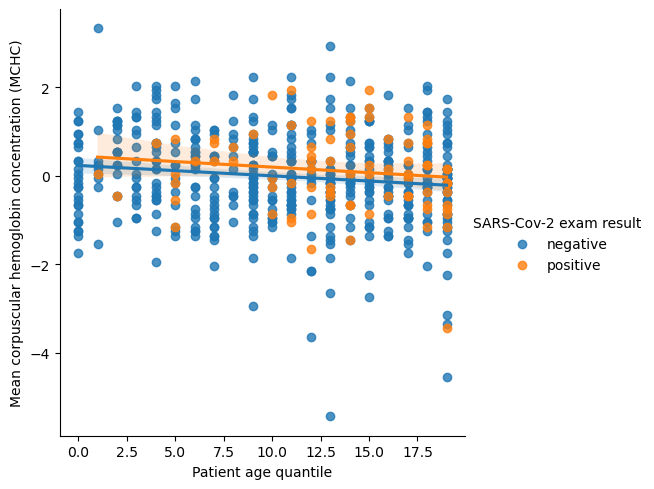

<Figure size 640x480 with 0 Axes>

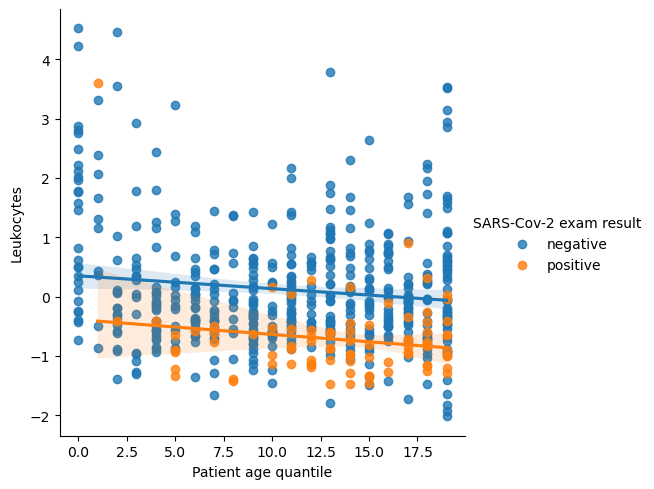

<Figure size 640x480 with 0 Axes>

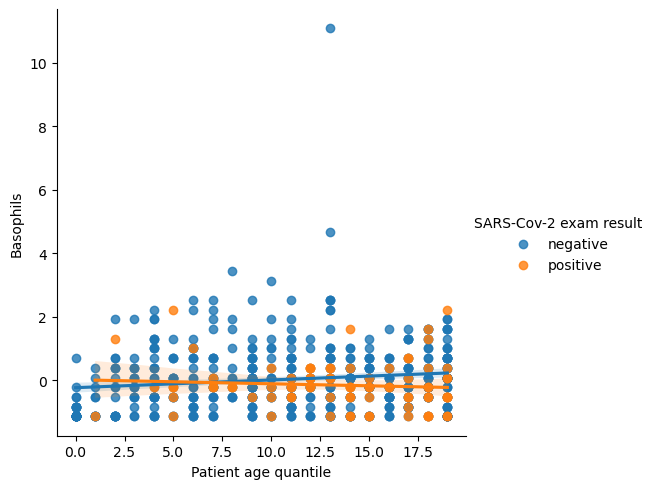

<Figure size 640x480 with 0 Axes>

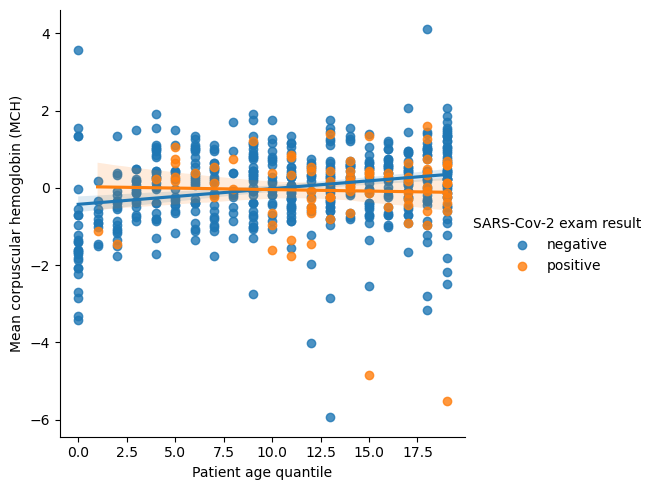

<Figure size 640x480 with 0 Axes>

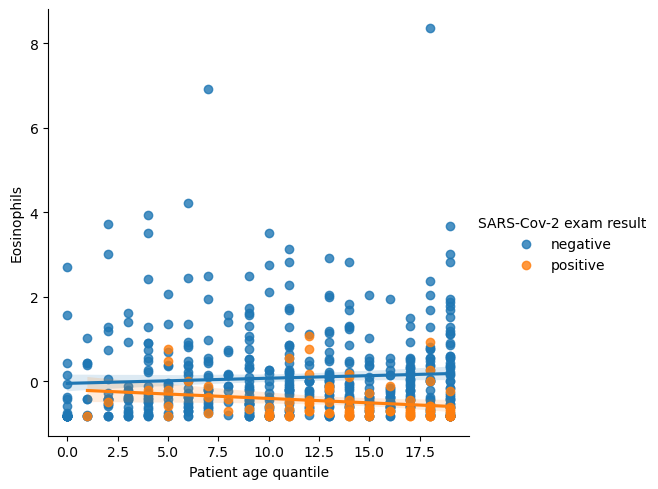

<Figure size 640x480 with 0 Axes>

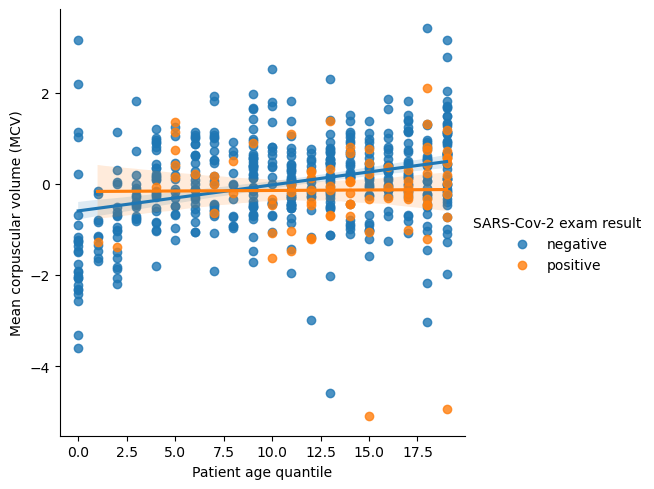

<Figure size 640x480 with 0 Axes>

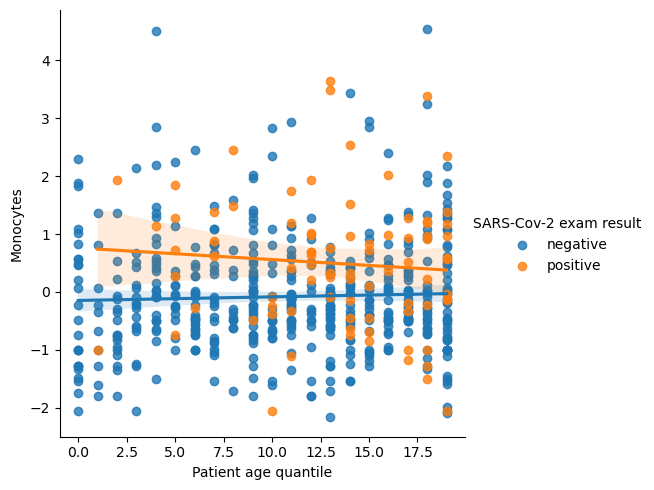

<Figure size 640x480 with 0 Axes>

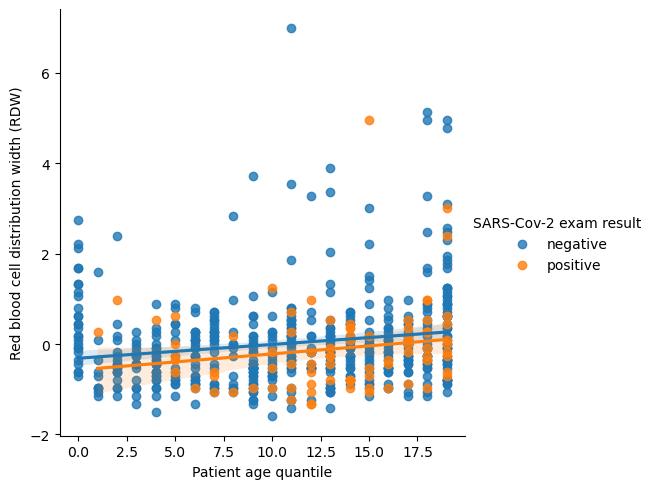

In [44]:
for col in blood_columns:
    plt.figure()
    sns.lmplot(x='Patient age quantile', y=col, hue='SARS-Cov-2 exam result', data=df)

En exécutant ce code, nous obtenons les graphiques suivants. 

La première chose à constater est que nos deux droites de régression ne sont pas superposées. Il y a également quelques valeurs aberrantes. 

Ce que nous souhaitions vérifier était la présence d'une relation linéaire entre l'âge et certains taux sanguins. Cependant, au vu des différents graphiques, il semble que cette relation est quasiment inexistante. Certes, il y a des tendances, comme avec la MCV (dont je ne connais toujours pas la définition) et le volume sanguin en fonction de l'âge, mais elles semblent très faibles.

Pour vérifier cela, nous pourrions tracer une matrice de covariance. Toutefois, plutôt que de le faire pour la matrice entière, nous allons simplement examiner la corrélation entre l'âge et les différentes variables sanguines. 

En utilisant la fonction de corrélation sur notre dataset, nous obtenons une matrice de corrélation pour toutes les variables quantitatives. 

In [45]:
df.corr(numeric_only=True)

,Patient age quantile,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW)
Patient age quantile,1.000000,0.046166,0.015736,-0.035772,0.096808,0.060320,-0.158683,0.119449,-0.037510,-0.125935,-0.124671,-0.166386,0.107525,0.197394,0.022085,0.281655,0.050962,0.166429
"Patient addmited to regular ward (1=yes, 0=no)",0.046166,1.000000,-0.011264,-0.010192,-0.087241,-0.091867,-0.183091,-0.013134,-0.053143,-0.095313,-0.034642,-0.103005,0.031833,-0.050703,-0.085636,-0.039326,-0.000354,0.102160
"Patient addmited to semi-intensive unit (1=yes, 0=no)",0.015736,-0.011264,1.000000,-0.008087,-0.182215,-0.177142,0.006966,-0.023475,-0.137951,-0.110574,-0.023390,0.138304,-0.132984,-0.054479,-0.089780,-0.050871,-0.037916,0.092406
"Patient addmited to intensive care unit (1=yes, 0=no)",-0.035772,-0.010192,-0.008087,1.000000,-0.183850,-0.178878,0.125953,-0.073511,-0.120659,-0.109867,-0.036227,0.271681,-0.121429,-0.090487,-0.088586,-0.078215,-0.103629,0.193560
Hematocrit,0.096808,-0.087241,-0.182215,-0.183850,1.000000,0.968447,-0.082296,0.083580,0.872987,0.002035,0.130771,-0.089937,0.129268,0.075216,0.029781,0.025161,0.082361,-0.264708
Hemoglobin,0.060320,-0.091867,-0.177142,-0.178878,0.968447,1.000000,-0.120150,0.078816,0.841420,-0.004105,0.371708,-0.102375,0.116389,0.184883,0.018618,0.027679,0.094586,-0.342426
Platelets,-0.158683,-0.183091,0.006966,0.125953,-0.082296,-0.120150,1.000000,-0.356332,-0.054561,0.090607,-0.159397,0.443056,-0.025990,-0.101245,0.169453,-0.033844,-0.200660,-0.008222
Mean platelet volume,0.119449,-0.013134,-0.023475,-0.073511,0.083580,0.078816,-0.356332,1.000000,0.043419,0.079060,-0.004011,-0.154643,0.128630,0.069457,-0.046539,0.078026,0.038380,0.045468
Red blood Cells,-0.037510,-0.053143,-0.137951,-0.120659,0.872987,0.841420,-0.054561,0.043419,1.000000,-0.009843,0.090073,-0.036159,0.079362,-0.367077,-0.004408,-0.458531,0.045172,-0.138071
Lymphocytes,-0.125935,-0.095313,-0.110574,-0.109867,0.002035,-0.004105,0.090607,0.079060,-0.009843,1.000000,-0.027979,-0.330536,0.234675,0.014736,0.199562,0.026927,0.065313,-0.079711


Nous filtrerons cette matrice pour ne sélectionner que la variable de l'âge, en utilisant sort_values. 

In [46]:
df.corr(numeric_only=True)['Patient age quantile'].sort_values()

Leukocytes                                              -0.166386
Platelets                                               -0.158683
Lymphocytes                                             -0.125935
Mean corpuscular hemoglobin concentration (MCHC)        -0.124671
Red blood Cells                                         -0.037510
Patient addmited to intensive care unit (1=yes, 0=no)   -0.035772
Patient addmited to semi-intensive unit (1=yes, 0=no)    0.015736
Eosinophils                                              0.022085
Patient addmited to regular ward (1=yes, 0=no)           0.046166
Monocytes                                                0.050962
Hemoglobin                                               0.060320
Hematocrit                                               0.096808
Basophils                                                0.107525
Mean platelet volume                                     0.119449
Red blood cell distribution width (RDW)                  0.166429
Mean corpu

Nous constatons que les coefficients de corrélation les plus élevés atteignent à peine 0,28. C'est une corrélation très faible, rendant inutile toute hypothèse suggérant que l'âge pourrait influencer, par exemple, le taux de globules blancs.

Néanmoins, ces variables pourraient s'avérer utiles lors de notre modélisation. 

Encore une fois, notre objectif est de collecter des informations pour comprendre les relations et les forces entre les différentes variables. Pour conclure, nous observons une très faible corrélation entre l'âge et les taux sanguins. Bien que ces deux variables auraient pu être utilisées conjointement dans une phase de modélisation, la relation n'est malheureusement pas aussi forte que nous l'aurions espéré.

#### 3.5.5 Analyse des Données Virales:

À présent, nous allons nous intéresser à la relation entre les variables virales. 

**Relation entre influenza et rapid test**

Si tout à l'heure nous avions une grande table, cette fois-ci, nous pourrions utiliser ce qu'on appelle un graphique mosaïque. On en trouve dans le package "statsmodels", mais nous n'irons pas aussi loin. 

Ce que nous allons simplement faire, c'est nous pencher sur cette variable "rapide test" pour l'influenza A et B. C'est un peu étrange. Pourquoi aurions-nous un "rapide test" en plus d'avoir un influenza A et un influenza B? C'est précisément ce que nous allons essayer de visualiser maintenant dans cette analyse.

Ainsi, très simplement, nous allons effectuer une tabulation croisée pour l'influenza A et les tests rapides, ainsi que pour l'influenza B. 

In [47]:
df.head()

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
0,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative
2,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN


In [48]:
pd.crosstab(df['Influenza A'], df['Influenza A, rapid test'])

"Influenza A, rapid test",negative,positive
Influenza A,,
detected,2,4
not_detected,245,15


In [49]:
pd.crosstab(df['Influenza B'], df['Influenza B, rapid test'])

"Influenza B, rapid test",negative,positive
Influenza B,,
detected,18,11
not_detected,233,4


Et immédiatement, nous remarquons quelque chose. Il y a 15 cas détectés comme positifs uniquement au "rapide test" alors que pour l'influenza A, c'était en réalité des cas négatifs. C'est intéressant. Et c'est d'autant plus intéressant que lorsque nous faisons une recherche sur la sensibilité de ces tests sur Internet, nous constatons que ces tests ont une très mauvaise sensibilité. En d'autres termes, ils sont très peu fiables.
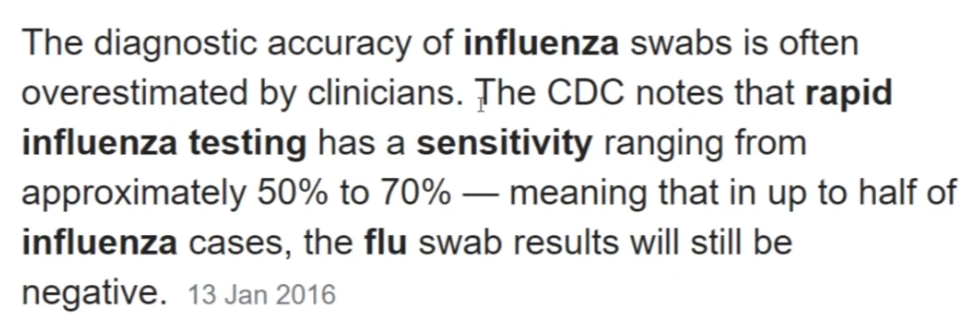

Voilà une nouvelle chose à inscrire dans nos notes. C'est une nouvelle information, une nouvelle pièce de notre puzzle. 

Pour l'instant, nous ne prenons pas de décision, mais nous pourrons nous référer à ce document plus tard lorsque nous effectuerons du prétraitement et de la modélisation. En rappelant que le "rapide test" ne nous donne pas de bons résultats et est même reconnu comme étant peu fiable. Donc, peut-être que nous ne l'utiliserons pas. 

#### 3.5.6 Analyse de la vitalité / Variables sanguines

Nous allons étudier la relation entre la présence de maladies, y compris le rhinovirus, et les taux de globules blancs et rouges présents dans le sang. 

Pour ce faire, nous commençons par créer une nouvelle variable nommée "est_malade", qui indiquera si un patient présente l'une des maladies énumérées, à l'exception du COVID. 

Pour cela, nous sélectionnons notre jeu de données "dataset_viral_col" et excluons les deux dernières colonnes correspondant aux tests rapides A et B. 

Puis, nous marquons les valeurs égales à "detected". Cela nous donne un tableau booléen. 

In [50]:
df[viral_columns[:-2]] == 'detected'

,Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5639,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5640,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5641,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5642,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


Ensuite, nous sommons ce tableau, en le faisant par colonne, pour obtenir le total de patients testés positifs pour une ou plusieurs maladies. 

<Axes: >

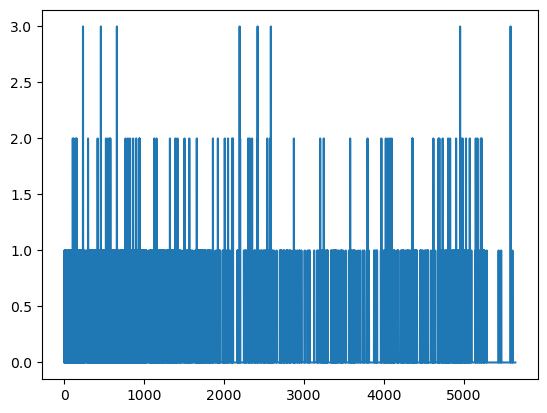

In [51]:
np.sum(df[viral_columns[:-2]] == 'detected', axis=1).plot()

En effet, un patient peut être testé positif pour plusieurs maladies simultanément. En analysant les données, nous constatons que certains patients ont été testés positifs pour trois maladies à la fois. Il ne s'agit pas nécessairement de dire qu'ils ont trois maladies, mais ils ont été testés positifs pour ces trois maladies, ce qui est intéressant.

Nous nous intéressons ensuite aux cas où le total est supérieur ou égal à 1, ce qui indique que le patient a été testé positif pour au moins une maladie. Nous ajoutons ensuite cette information à notre jeu de données dataset sous la forme d'une nouvelle colonne "est_malade".

In [52]:
df['est malade'] = np.sum(df[viral_columns[:-2]] == 'detected', axis=1) >= 1
df.head()

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test",est malade
0,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
1,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative,True
2,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
3,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN,True


Pour visualiser la relation entre "est_malade" et les différents tests sanguins, nous suivons la même méthodologie que précédemment, en créant des sous-ensembles pour les valeurs positives et négatives de "est_malade". 

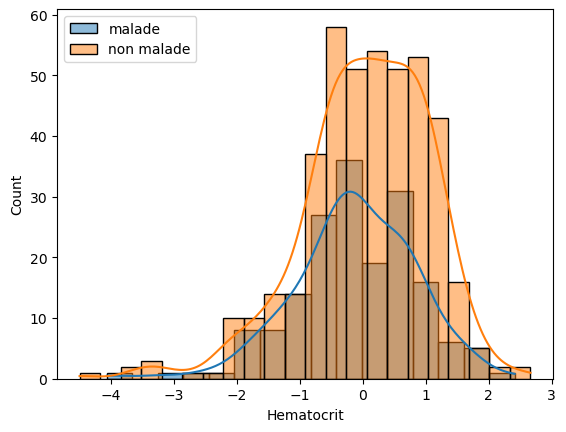

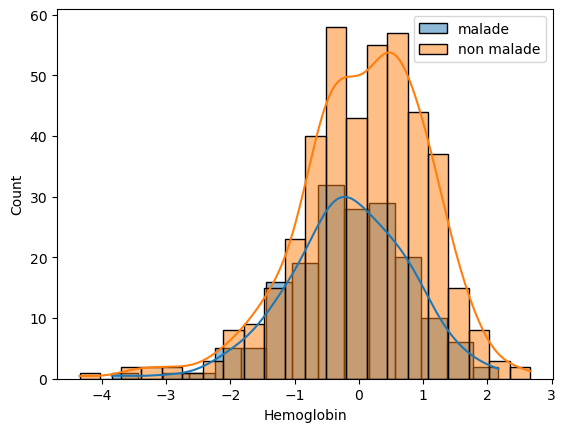

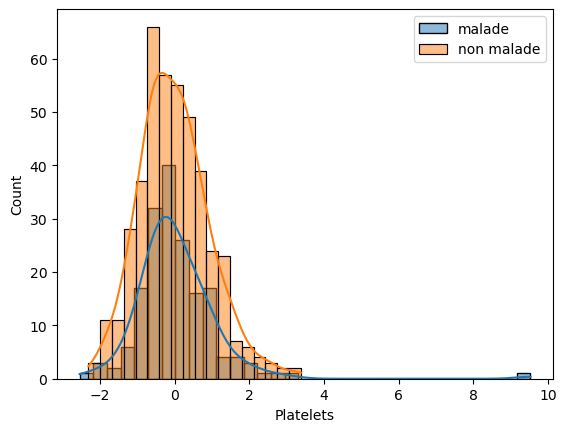

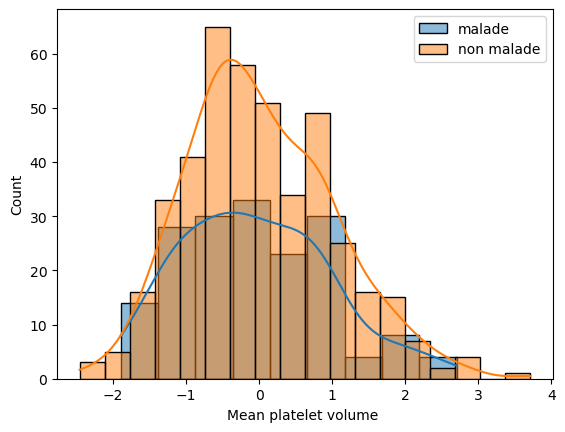

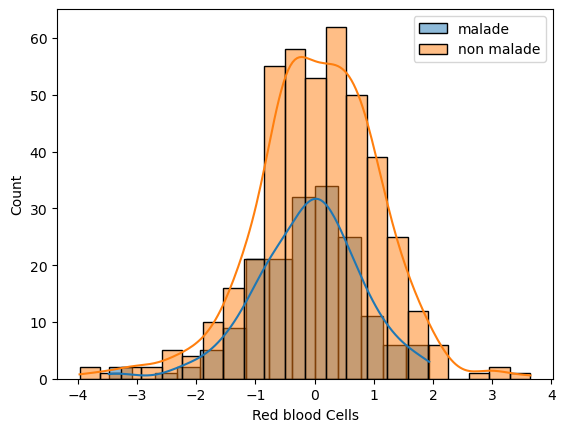

...

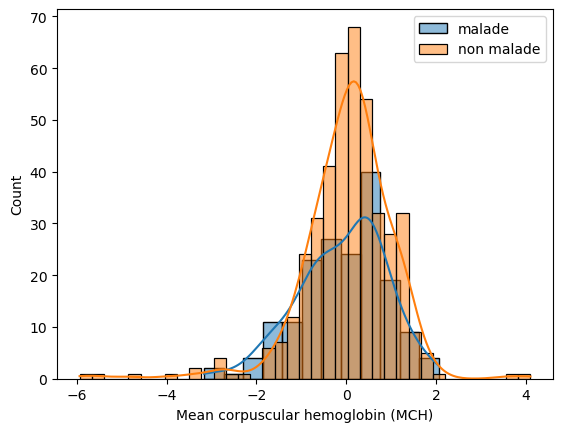

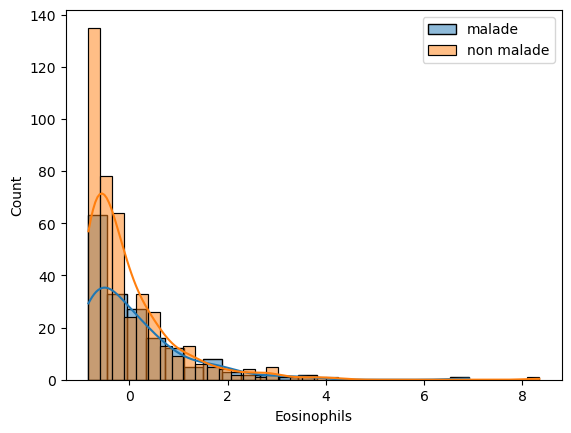

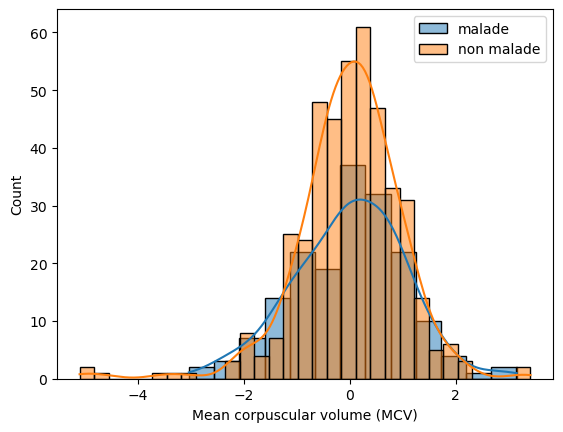

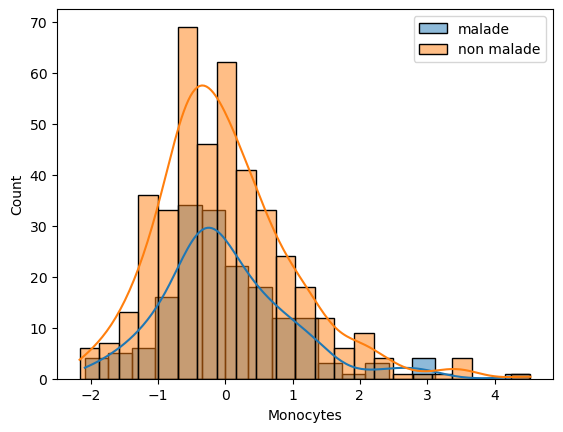

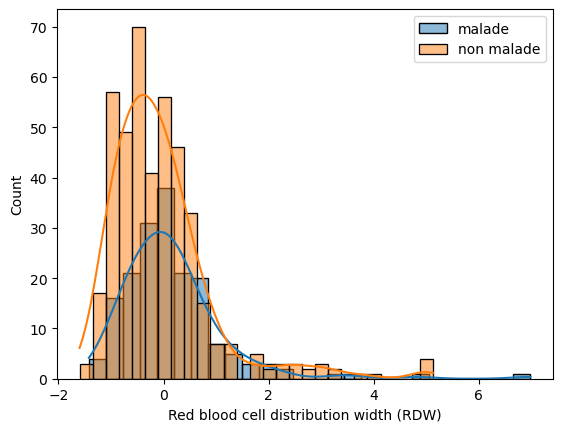

In [53]:
malade_df = df[df['est malade'] == True]
non_malade_df = df[df['est malade'] == False]

for col in blood_columns:
    plt.figure()
    sns.histplot(malade_df[col], label='malade', kde=True)
    sns.histplot(non_malade_df[col], label='non malade',kde=True)
    plt.legend()

Cela nous donne le même graphique que tout à l'heure, mais pas pour le coronavirus, mais pour d'autres maladies respiratoires. 

Maintenant, nous allons essayer de voir si, contrairement au cas du virus courant où les monocytes et les leucocytes étaient très différents, nous observons les mêmes différences ici ou s'il y aura d'autres différences. Cela pourrait être intéressant. 

Analysons donc ces graphiques. Pour l'hémoglobine, c'est à peu près la même chose avec une légère différence, mais honnêtement, sur un petit test, cela ne donnera rien. 

Pour les plaquettes, c'est intéressant. Si vous vous souvenez, nous avions observé un grand décalage entre nos deux courbes précédemment. Or ici, il n'y en a pas du tout ; les deux courbes sont parfaitement alignées. 

Un test de Student nous indiquerait sans doute que les deux groupes ont la même moyenne, qu'il n'y a pas de différence significative. 

Pour ce qui est des lymphocytes, ils sont différents, ce qui est remarquable. Nous n'avions pas observé une telle différence pour les lymphocytes en comparaison avec le COVID. 

Si nous nous rappelons bien, nous avions simplement remarqué des différences pour les monocytes, leucocytes et plaquettes. 

Il ne faut donc pas oublier de prendre des notes à ce sujet. 

Nous pouvons observer que les taux sanguins entre les patients malades et ceux atteints de COVID-19 sont différents, mais c'est seulement une observation préliminaire. 

Il serait nécessaire de valider cette observation avec un test d'hypothèse, et c'est ce que nous comptons faire prochainement avec des tests statistiques. Tout cela est bien compris. Maintenant, nous allons continuer.

#### 3.5.7 Analyse Statut Hospitalisation

Essayons de visualiser une chose intéressante : la relation entre l'hospitalisation et les tests sanguins, ou si une personne est malade ou non. 

Comme vous le savez, dans notre dataset, nous avons trois variables : patients admis au service de surveillance, semi-intensif, et soins intensifs. Jusqu'à présent, nous n'y avons pas touché. 

In [54]:
def hospitalisation(df):
    if df['Patient addmited to regular ward (1=yes, 0=no)'] == 1:
        return 'surveillance'
    elif df['Patient addmited to semi-intensive unit (1=yes, 0=no)'] == 1:
        return 'soins semi-intensives'
    elif df['Patient addmited to intensive care unit (1=yes, 0=no)'] == 1:
        return 'soins intensifs'
    else:
        return 'inconnu'

Ce que nous allons faire, c'est créer une nouvelle variable, par exemple "statut", dans notre dataset. Elle sera égale au résultat de la fonction apply(), qui est une fonction essentielle de pandas. 

Nous allons utiliser une fonction que nous avons créée def hospitalisation(df, pour mettre dans "statut" l'un des états suivants : surveillance, semi-intensif, soin intensif,  en fonction des résultats que nous avons dans nos colonnes "patients admis". 

Si cette colonne est égale à 1, alors c'est "surveillance", sinon c'est "soins intensifs", sinon "semi-intensif". S'il n'y a rien, alors on met "état inconnu". C'est aussi simple que ça.

In [55]:
df['statut'] = df.apply(hospitalisation, axis=1)
df

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test",est malade,statut
0,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,inconnu
1,17,negative,0,0,0,0.236515,-0.022340,-0.517413,0.010677,0.102004,0.318366,-0.950790,-0.094610,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative,True,inconnu
2,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,inconnu
3,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,inconnu
4,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN,True,inconnu
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5639,3,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,inconnu
5640,17,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,inconnu
5641,4,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,inconnu
5642,10,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,inconnu


Ce que nous faisons ensuite, c'est utiliser cette fonction "hospitalisation" avec la méthode "apply" de pandas. Nous l'appliquons sur "df". 

Maintenant, pour afficher la relation entre les taux sanguins des individus et les services hospitaliers où ils sont admis, nous allons rédiger une boucle "for". 

Cependant, attention, cette fois-ci, dans cette boucle, nous allons créer une figure. Sur cette figure, nous ajouterons à chaque fois différents graphiques histplot. 

Nous itérerons à travers les différentes catégories de statut. Pour ce faire, nous utilisons la fonction que nous avons déjà rencontrée plusieurs fois : la fonction "unique". Ainsi, nous aurons les statuts "inconnu", "soins intensifs", "semi-intensif" et "surveillance".

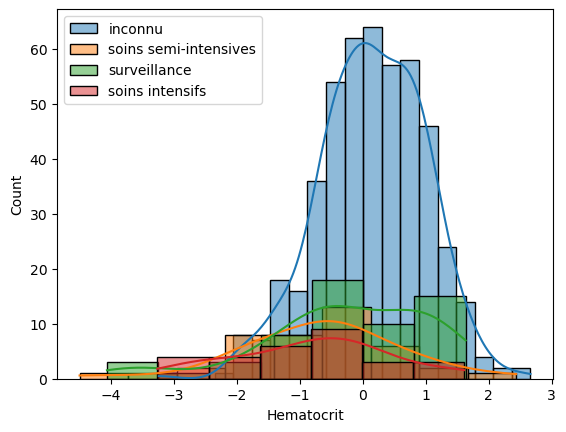

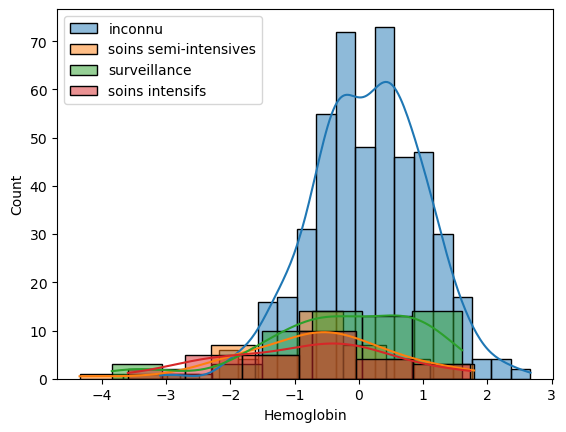

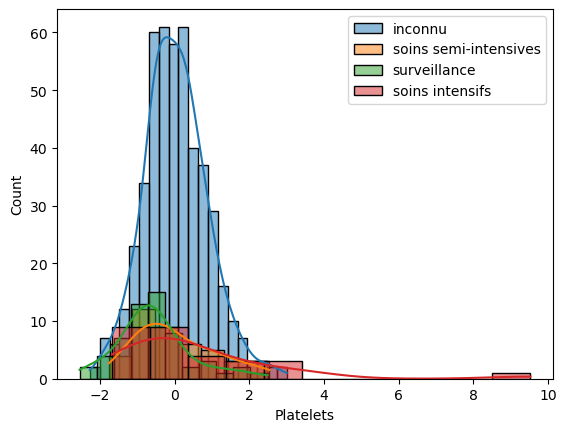

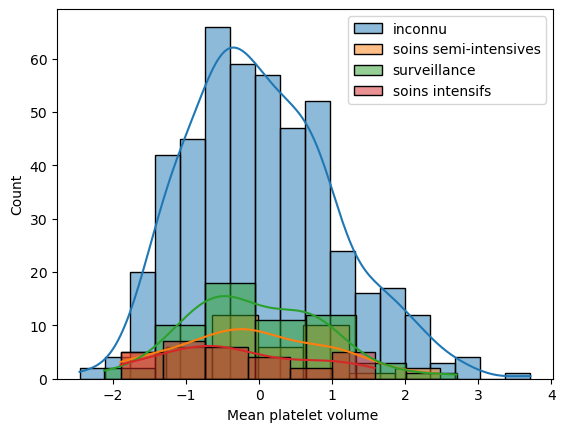

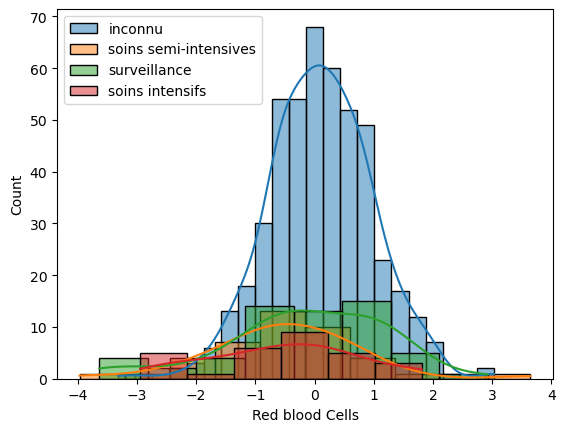

...

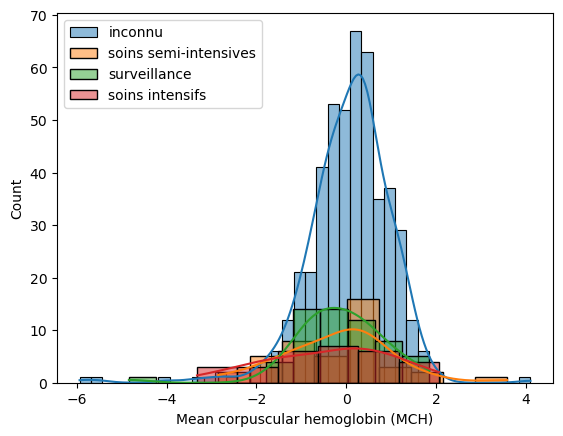

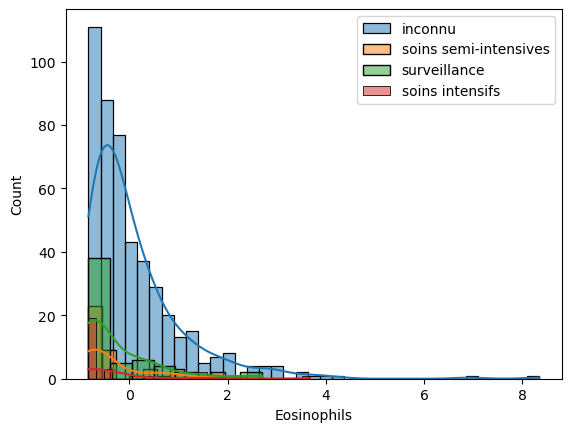

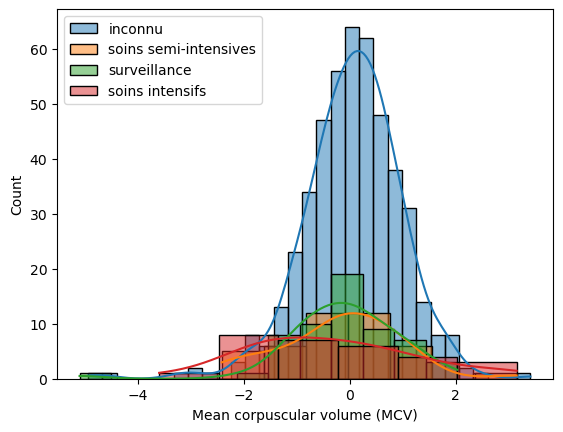

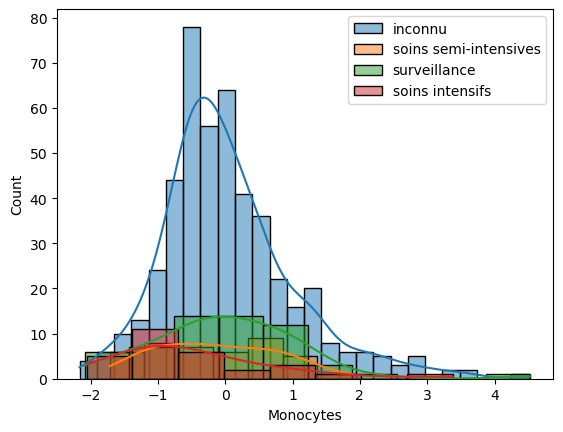

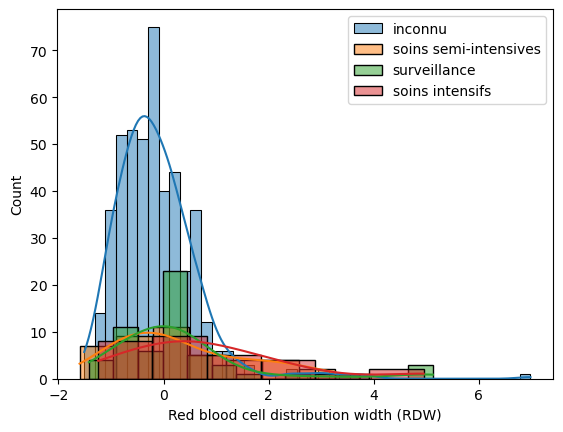

In [56]:
for col in blood_columns:
    plt.figure()
    for cat in df['statut'].unique():
        sns.histplot(df[df['statut']==cat][col], label=cat, kde=True)
    plt.legend()

Ce que nous avons fait, c'est filtrer pour "statut égal à cat". 

Nous avons introduit ce tableau de booléens dans notre dataframe (df). C'est toujours la même méthode, le même protocole. 

Ensuite, nous avons sélectionné uniquement la colonne pertinente parmi ces colonnes dans le dataframe qui a été filtré pour contenir uniquement la catégorie concernée. 

Nous ajoutons une légende en indiquant quelle catégorie nous souhaitons afficher. 

Lorsque nous exécutons ce code, nous obtenons de très beaux graphiques.

Il est particulièrement intéressant de voir que les personnes admises en soins intensifs ont des taux de leucocytes significativement différents. C'est fascinant de constater cela. Ce serait même pertinent si nous avions pour objectif non pas de prédire si une personne est atteinte de COVID ou non, mais plutôt de déterminer dans quel service hospitaliser les patients en fonction de leurs résultats sanguins. 

Pour conclure, prenons quelques notes. Nous sommes satisfaits des résultats obtenus.

#### 3.5.8 Impact des NaN sur la variable Target

Nous allons réaliser une analyse un peu plus détaillée des valeurs manquantes de notre dataset. Cela sera rapide, mais il est essentiel de le faire. L'objectif est de comprendre, à titre informatif, ce qui se passerait dans notre dataset si nous éliminions certaines valeurs manquantes. Vous comprendrez tout de suite.

Actuellement, nous avons deux types de variables : les "blood" et les "virale". 

Idéalement, nous voudrions avoir les deux, mais le problème, comme on peut clairement le voir, est que nos lignes ne sont pas alignées entre ces deux catégories de variables.
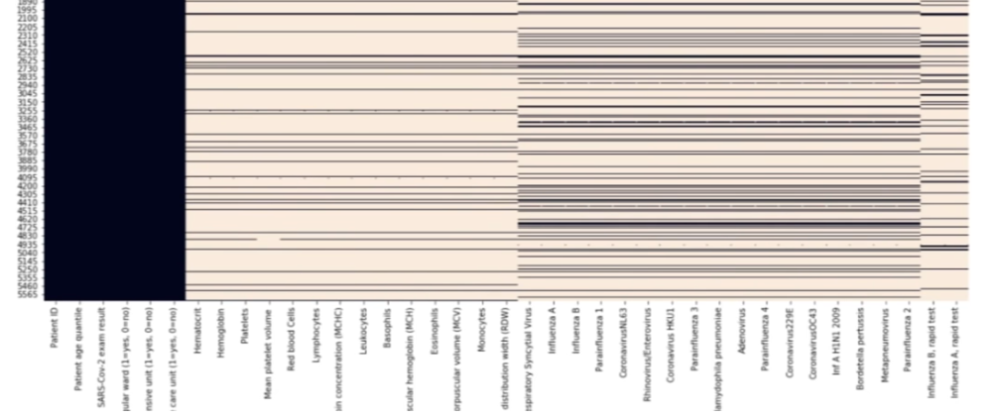

L'union de ces deux catégories va éliminer un grand nombre de valeurs dans notre dataset. Nous nous retrouverions avec un très faible nombre de données. 

Pour le voir facilement, on peut utiliser "df.dropna()" et compter le nombre de variables restantes. 

In [57]:
df.dropna().count()

Patient age quantile                                     99
SARS-Cov-2 exam result                                   99
Patient addmited to regular ward (1=yes, 0=no)           99
Patient addmited to semi-intensive unit (1=yes, 0=no)    99
Patient addmited to intensive care unit (1=yes, 0=no)    99
Hematocrit                                               99
Hemoglobin                                               99
Platelets                                                99
Mean platelet volume                                     99
Red blood Cells                                          99
Lymphocytes                                              99
Mean corpuscular hemoglobin concentration (MCHC)         99
Leukocytes                                               99
Basophils                                                99
Mean corpuscular hemoglobin (MCH)                        99
Eosinophils                                              99
Mean corpuscular volume (MCV)           

Ainsi, il nous reste seulement 99 valeurs par colonne sur les 5600 initiales. C'est vraiment dommage.

Si nous voulons travailler avec ces deux types de données, nous devrons probablement traiter les valeurs manquantes, peut-être les remplacer. 

En attendant, il serait intéressant de savoir combien de valeurs nous aurions si nous travaillions uniquement avec les données "blood". 

In [58]:
df[blood_columns].count()

Hematocrit                                          603
Hemoglobin                                          603
Platelets                                           602
Mean platelet volume                                599
Red blood Cells                                     602
Lymphocytes                                         602
Mean corpuscular hemoglobin concentration (MCHC)    602
Leukocytes                                          602
Basophils                                           602
Mean corpuscular hemoglobin (MCH)                   602
Eosinophils                                         602
Mean corpuscular volume (MCV)                       602
Monocytes                                           601
Red blood cell distribution width (RDW)             602
dtype: int64

Nous obtiendrions 600 valeurs, soit un peu plus de 10% de notre dataset. 

De la même manière, si nous travaillions avec les variables "virale", il nous resterait 1354 valeurs. 

In [59]:
df[viral_columns].count()

Respiratory Syncytial Virus    1354
Influenza A                    1354
Influenza B                    1354
Parainfluenza 1                1352
CoronavirusNL63                1352
Rhinovirus/Enterovirus         1352
Coronavirus HKU1               1352
Parainfluenza 3                1352
Chlamydophila pneumoniae       1352
Adenovirus                     1352
Parainfluenza 4                1352
Coronavirus229E                1352
CoronavirusOC43                1352
Inf A H1N1 2009                1352
Bordetella pertussis           1352
Metapneumovirus                1352
Parainfluenza 2                1352
Influenza B, rapid test         820
Influenza A, rapid test         820
dtype: int64

Il est donc évident qu'il est préférable de travailler avec "virale". Cependant, cela ne serait probablement pas suffisant, car notre analyse a révélé que ces variables sont extrêmement utiles.

Pour terminer cette analyse des valeurs manquantes, nous devons essayer de comprendre l'état de notre variable cible (ou "target") si nous éliminons toutes les valeurs manquantes de certains groupes. 

Par exemple, si nous sélectionnons le groupe de données "virale", y ajoutons la variable "target" et éliminons toutes les valeurs manquantes (passant ainsi de 5000 à 1354 valeurs), conservons-nous un bon rapport entre les positifs et les négatifs dans notre "target"? 

Nous pouvons vérifier cela rapidement en utilisant "dropna()" et "value_counts". Optionnellement, comme mentionné au début de la vidéo, on peut utiliser "normalize" et "round".

In [60]:
df1 = df[viral_columns[:-2]]
df1.loc[:, 'covid'] = df.loc[:, 'SARS-Cov-2 exam result']
df1.dropna()['covid'].value_counts(normalize=True)

C:\Users\romeofr\AppData\Local\Temp\ipykernel_4020\2336744833.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.loc[:, 'covid'] = df.loc[:, 'SARS-Cov-2 exam result']


negative    0.91716
positive    0.08284
Name: covid, dtype: float64

Nous constatons qu'il reste à peu près les mêmes proportions. 

Pour compléter notre analyse, nous devons répéter cette procédure pour les variables "blood". 

In [61]:
df2 = df[blood_columns]
df2.loc[:, 'covid'] = df['SARS-Cov-2 exam result']
df2.dropna()['covid'].value_counts(normalize=True)

C:\Users\romeofr\AppData\Local\Temp\ipykernel_4020\661244846.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.loc[:, 'covid'] = df['SARS-Cov-2 exam result']


negative    0.864548
positive    0.135452
Name: covid, dtype: float64

Nous observons alors de meilleures proportions : nos classes sont plus équilibrées avec 86% et 14% respectivement. Pour conclure, prenons des notes en consignant tout cela sur papier, afin de conserver ces informations.

## 3.6 Test d'hypothèse (test de Student)

Nous allons terminer en réalisant rapidement quelques tests d'hypothèses. 

En effet, lors de notre exploration, certaines idées nous sont venues. Par exemple, il semblerait que les individus atteints du COVID-19 aient des taux de leucocytes et de monocytes significativement différents de ceux qui sont négatifs. 

Nous allons tester cette idée. Notre hypothèse nulle, notée H0, stipule que les taux moyens sont identiques chez les individus positifs et négatifs. 

Pour tester cette hypothèse, nous allons utiliser le test de Student. Bien que nous n'ayons pas encore discuté des tests statistiques, à part brièvement le test Chi2, le test de Student permet de vérifier si la moyenne de deux distributions est significativement différente. L'idée est d'essayer de rejeter l'hypothèse nulle. 

Pour ce faire, nous définissons un seuil alpha, généralement autour de 2% ou 5%. Ensuite, nous calculons une valeur p avec notre test. Si cette valeur p est inférieure à alpha, nous pouvons rejeter l'hypothèse nulle.

Pour réaliser notre test, nous utiliserons un outil de ttest_ind issu du module scipy.stats. 

In [62]:
from scipy.stats import ttest_ind

Une chose importante à savoir est que lorsqu'on effectue un test de student, il est préférable d'avoir des classes équilibrées entre nos différents groupes. Le nombre de personnes positives doit à peu près être égal au nombre de personnes négatives. 

In [63]:
positive_df.shape

(558, 38)

In [64]:
negative_df.shape

(5086, 38)

Le problème, c'est que nous n'avons pas du tout cela. 

Donc ce que nous allons faire, c'est utiliser une technique d'échantillonnage en écrivant sample, dans lequel nous allons préciser le nombre d'échantillons que nous voulons tirer au hasard des négatifs. 

Donc, si nous voulons quelque chose de parfaitement équilibré, nous écrirons 558 et nous nous retrouverons avec 558 échantillons tirés au hasard de nos données. 

In [65]:
negative_df.sample(558)

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
883,18,negative,1,0,0,0.488289,0.228284,0.085554,-0.774677,0.754327,2.024174,-0.851210,-0.692910,0.081693,-0.971801,0.007280,-0.655019,-0.272770,0.347948,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,NaN,NaN
1386,1,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2373,9,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4688,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1005,14,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4586,4,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4214,0,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
186,11,negative,0,0,0,-0.038148,0.102972,0.173487,-1.335643,0.366460,-1.387443,0.542882,-0.016692,-0.834685,-0.501356,-0.793368,-0.855315,-0.640455,0.347948,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,negative,negative
4456,7,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Cela nous donne 558 lignes, ce qui sera très utile. Pour être un peu plus malin, nous prendrons positive_df.shape[0], au cas où cela changerait à l'avenir. Donc, nous avons notre 558 qui est écrit ici.

In [66]:
negative_df.sample(positive_df.shape[0])

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
4256,11,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
484,0,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5164,19,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1066,16,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
316,18,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4489,12,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
461,14,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN
195,2,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN
4856,0,negative,0,0,0,-0.816359,-0.586244,1.605533,0.235063,-0.197712,-0.764823,0.74204,1.95909,-0.223767,-0.710443,0.133698,-1.175789,0.4626,-0.713529,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN


Ces deux éléments seront intégrés dans une fonction qui fera appel à un test indépendant pour calculer la valeur p entre positif_df et negative_df.sample(positive_df.shape[0]), pour chaque colonne du test et nous comparerons cette valeur p à notre seuil alpha. 

En gros, nous avons une fonction où la valeur alpha est égale à 0.2. 

Nous calculons une valeur p à partir du test indépendant, comme je l'ai mentionné, dans lequel nous comparons à balanced_neg où nous éliminerons les valeurs manquantes. C'est mieux pour effectuer un test. 

Et nous ferons la même chose pour positive_df, où nous prendrons la colonne concernée en paramètre. 

Si notre valeur p est inférieure à alpha, alors nous rejetons notre hypothèse, sinon nous retournons 0. 

Nous compilons cette fonction.

In [67]:
balanced_neg = negative_df.sample(positive_df.shape[0])

def t_test(col):
    alpha = 0.02
    stat, p = ttest_ind(balanced_neg[col].dropna(), positive_df[col].dropna())
    if p < alpha:
        return 'H0 Rejetée'
    else :
        return 0

Et maintenant nous allons créer une boucle. Pour chaque colonne, nous imprimons la colonne, nous utilisons l'astuce que je vous ai montrée au début pour aligner joliment et nous appelons notre fonction de test pour chaque colonne.

In [68]:
for col in blood_columns:
    print(f'{col :-<50} {t_test(col)}')

Hematocrit---------------------------------------- 0
Hemoglobin---------------------------------------- 0
Platelets----------------------------------------- H0 Rejetée
Mean platelet volume ----------------------------- 0
Red blood Cells----------------------------------- 0
Lymphocytes--------------------------------------- 0
Mean corpuscular hemoglobin concentration (MCHC)-- 0
Leukocytes---------------------------------------- H0 Rejetée
Basophils----------------------------------------- 0
Mean corpuscular hemoglobin (MCH)----------------- 0
Eosinophils--------------------------------------- H0 Rejetée
Mean corpuscular volume (MCV)--------------------- 0
Monocytes----------------------------------------- 0
Red blood cell distribution width (RDW)----------- 0


Ce qui est intéressant à constater, c'est qu'en effet, les plaquettes et les leucocytes semblent être des variables significativement différentes pour les personnes atteintes du coronavirus et celles qui ne le sont pas. 

Ce test nous permet de revenir à nos notes et de dire que cette hypothèse est rejetée : les taux moyens ne sont pas égaux chez les individus positifs et négatifs. C'est très intéressant pour la suite du programme.

Pour conclure sur cette exploration de notre data set, nous avons pris beaucoup de notes qui nous serviront tout au long du projet. 

Maintenant, il reste à faire le pré-traitement en cohérence avec ce que nous avons identifié. 

Nous partirons de notre data set original, en refaisant une copie, et nous mettrons en place différentes opérations que nous avons identifiées comme utiles. Par exemple, nous éliminerons certains patients, nous filtrerons les variables avec plus de 90% de valeurs manquantes, et bien d'autres choses encore. 

## 3.7 Notebook : syntèse

In [69]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999

<IPython.core.display.Javascript object>

In [70]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib as mpl
mpl.rcParams['figure.max_open_warning'] = 60

In [71]:
pd.set_option('display.max_row', 111)
pd.set_option('display.max_column', 111)

In [72]:
url = 'https://raw.githubusercontent.com/MachineLearnia/Python-Machine-Learning/master/Dataset/dataset.csv'
data = pd.read_csv(url, index_col=0, encoding = "ISO-8859-1")

In [73]:
data.head()

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Serum Glucose,Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Mycoplasma pneumoniae,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,Neutrophils,Urea,Proteina C reativa mg/dL,Creatinine,Potassium,Sodium,"Influenza B, rapid test","Influenza A, rapid test",Alanine transaminase,Aspartate transaminase,Gamma-glutamyltransferase,Total Bilirubin,Direct Bilirubin,Indirect Bilirubin,Alkaline phosphatase,Ionized calcium,Strepto A,Magnesium,pCO2 (venous blood gas analysis),Hb saturation (venous blood gas analysis),Base excess (venous blood gas analysis),pO2 (venous blood gas analysis),Fio2 (venous blood gas analysis),Total CO2 (venous blood gas analysis),pH (venous blood gas analysis),HCO3 (venous blood gas analysis),Rods #,Segmented,Promyelocytes,Metamyelocytes,Myelocytes,Myeloblasts,Urine - Esterase,Urine - Aspect,Urine - pH,Urine - Hemoglobin,Urine - Bile pigments,Urine - Ketone Bodies,Urine - Nitrite,Urine - Density,Urine - Urobilinogen,Urine - Protein,Urine - Sugar,Urine - Leukocytes,Urine - Crystals,Urine - Red blood cells,Urine - Hyaline cylinders,Urine - Granular cylinders,Urine - Yeasts,Urine - Color,Partial thromboplastin time (PTT),Relationship (Patient/Normal),International normalized ratio (INR),Lactic Dehydrogenase,"Prothrombin time (PT), Activity",Vitamin B12,Creatine phosphokinase (CPK),Ferritin,Arterial Lactic Acid,Lipase dosage,D-Dimer,Albumin,Hb saturation (arterial blood gases),pCO2 (arterial blood gas analysis),Base excess (arterial blood gas analysis),pH (arterial blood gas analysis),Total CO2 (arterial blood gas analysis),HCO3 (arterial blood gas analysis),pO2 (arterial blood gas analysis),Arteiral Fio2,Phosphor,ctO2 (arterial blood gas analysis)
Patient ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
126e9dd13932f68,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,-0.140648,not_detected,not_detected,not_detected,not_detected,not_detected,detected,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,-0.619086,1.198059,-0.147895,2.089928,-0.305787,0.862512,negative,negative,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

**Exploratory Data Analysis**

**Objectif :**

    Comprendre du mieux possible nos données (un petit pas en avant vaut mieux qu'un grand pas en arriere)
    Développer une premiere stratégie de modélisation

**Checklist de base**

***Analyse de Forme :***

    variable target : SARS-Cov-2 exam result
    lignes et colonnes : 5644, 111
    types de variables : qualitatives : 70, quantitatives : 41
    Analyse des valeurs manquantes :
        beaucoup de NaN (moitié des variables > 90% de NaN)
        2 groupes de données 76% -> Test viral, 89% -> taux sanguins

***Analyse de Fond :***

    Visualisation de la target :
        10% de positifs (558 / 5000)

    Signification des variables :
        variables continues standardisées, skewed (asymétriques), test sanguin
        age quantile : difficile d'interpreter ce graphique, clairement ces données ont été traitées, on pourrait penser 0-5, mais cela pourrait aussi etre une transformation mathématique. On peut pas savoir car la personne qui a mit ce dataset ne le précise nul part. Mais ca n'est pas tres important
        variable qualitative : binaire (0, 1), viral, Rhinovirus qui semble tres élevée

    Relation Variables / Target :
        target / blood : les taux de Monocytes, Platelets, Leukocytes semblent liés au covid-19 -> hypothese a tester
        target/age : les individus de faible age sont tres peu contaminés ? -> attention on ne connait pas l'age, et on ne sait pas de quand date le dataset (s'il s'agit des enfants on sait que les enfants sont touchés autant que les adultes). En revanche cette variable pourra etre intéressante pour la comparer avec les résultats de tests sanguins
        target / viral : les doubles maladies sont tres rares. Rhinovirus/Enterovirus positif - covid-19 négatif ? -> hypothese a tester ? mais il est possible que la région est subie une épidémie de ce virus. De plus on peut tres bien avoir 2 virus en meme temps. Tout ca n'a aucun lien avec le covid-19

***Analyse plus détaillée***

    Relation Variables / Variables :
        blood_data / blood_data : certaines variables sont tres corrélées : +0.9 (a suveiller plus tard)
        blood_data / age : tres faible corrélation entre age et taux sanguins
        viral / viral : influenza rapid test donne de mauvais résultats, il fauda peut-etre la laisser tomber
        relation maladie / blood data : Les taux sanguins entre malades et covid-19 sont différents
        relation hospitalisation / est malade :
        relation hospitalisation / blood : intéressant dans le cas ou on voudrait prédire dans quelle service un patient devrait aller

    NaN analyse : viral : 1350(92/8), blood : 600(87/13), both : 90

***hypotheses nulle (H0):***

    Les individus atteints du covid-19 ont des taux de Leukocytes, Monocytes, Platelets significativement différents
        H0 = Les taux moyens sont ÉGAUX chez les individus positifs et négatifs

    Les individus atteints d'une quelconque maladie ont des taux significativement différents



Analyse de la forme des données

In [74]:
df = data.copy()

In [75]:
df.shape

(5644, 110)

<Axes: >

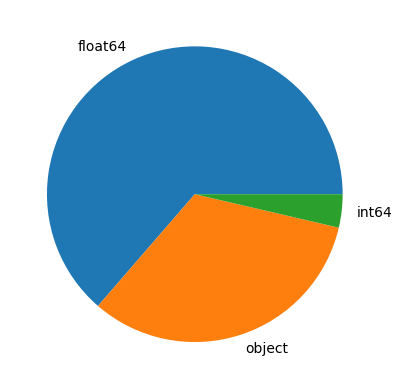

In [76]:
df.dtypes.value_counts().plot.pie()

<Axes: ylabel='Patient ID'>

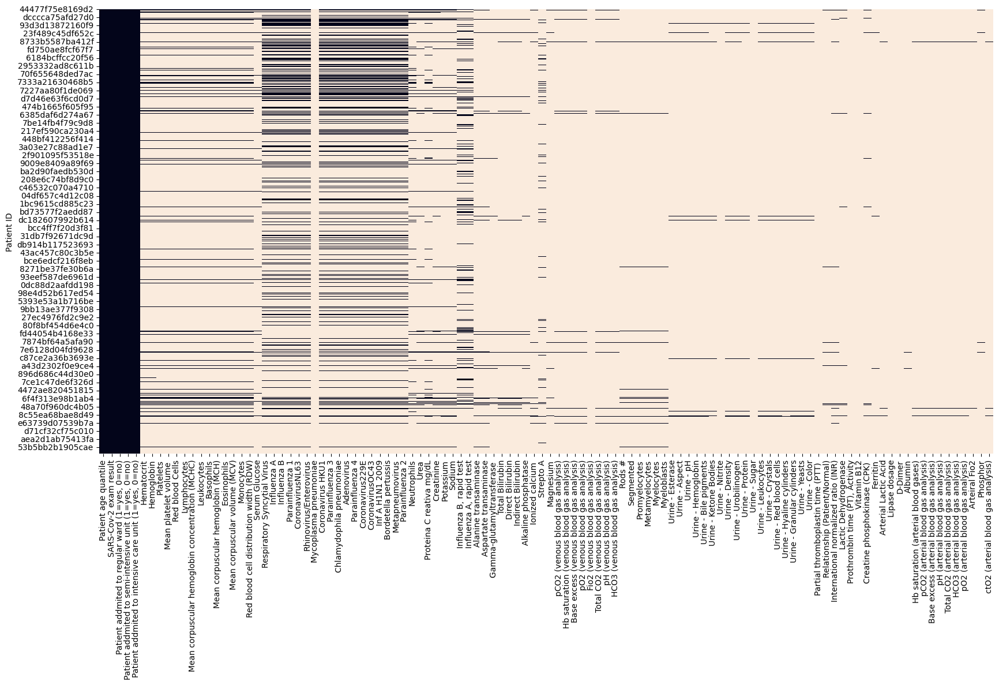

In [77]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(), cbar=False)

In [78]:
(df.isna().sum()/df.shape[0]).sort_values(ascending=True)

Patient age quantile                                     0.000000
SARS-Cov-2 exam result                                   0.000000
Patient addmited to regular ward (1=yes, 0=no)           0.000000
Patient addmited to semi-intensive unit (1=yes, 0=no)    0.000000
Patient addmited to intensive care unit (1=yes, 0=no)    0.000000
Influenza B                                              0.760099
Respiratory Syncytial Virus                              0.760099
Influenza A                                              0.760099
Rhinovirus/Enterovirus                                   0.760454
Inf A H1N1 2009                                          0.760454
CoronavirusOC43                                          0.760454
Coronavirus229E                                          0.760454
Parainfluenza 4                                          0.760454
Adenovirus                                               0.760454
Chlamydophila pneumoniae                                 0.760454
Parainflue

Analyse du Fond
1. Visulation initiale - Elimination des colonnes inutiles

In [79]:
df = df[df.columns[df.isna().sum()/df.shape[0] <0.9]]
df.head()

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
Patient ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
126e9dd13932f68,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative
a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
f7d619a94f97c45,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
d9e41465789c2b5,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN


<Axes: ylabel='Patient ID'>

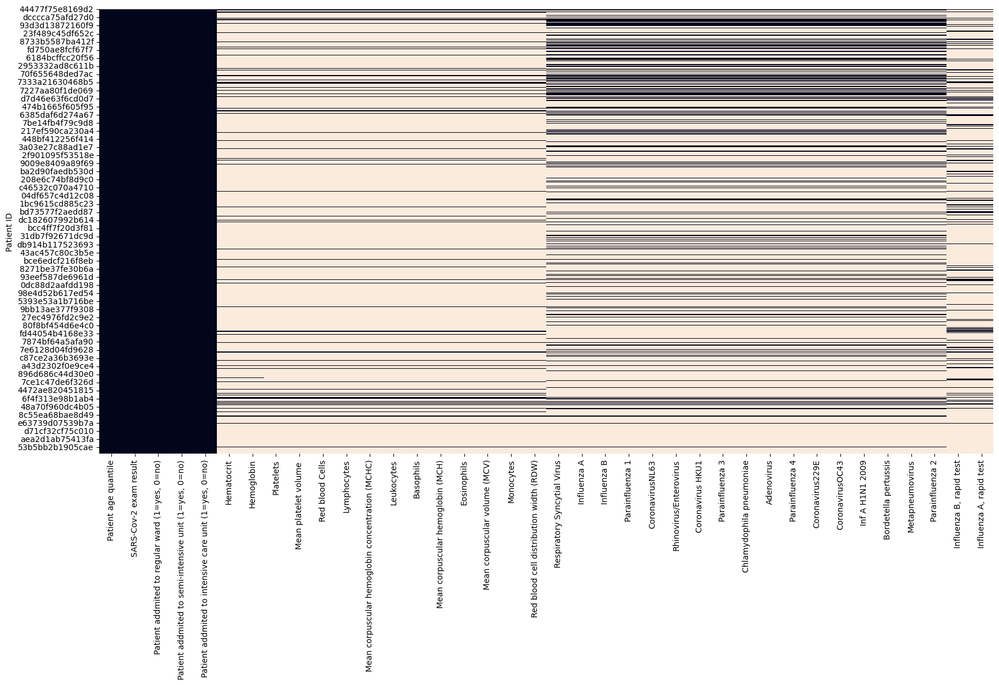

In [80]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(), cbar=False)

In [81]:
df.head()

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test"
Patient ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
126e9dd13932f68,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative
a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
f7d619a94f97c45,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
d9e41465789c2b5,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN


Examen de la colonne target

In [82]:
df['SARS-Cov-2 exam result'].value_counts(normalize=True)

negative    0.901134
positive    0.098866
Name: SARS-Cov-2 exam result, dtype: float64

histogrames des variables continues

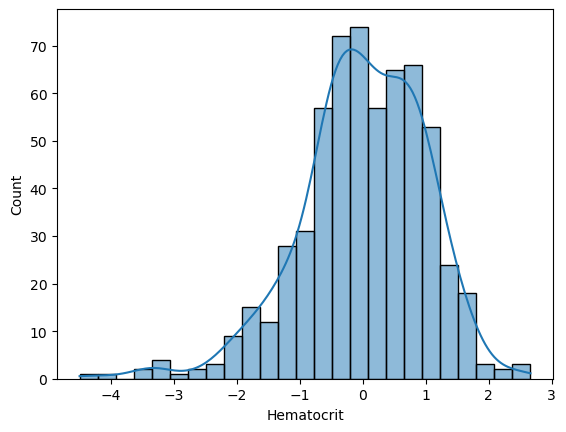

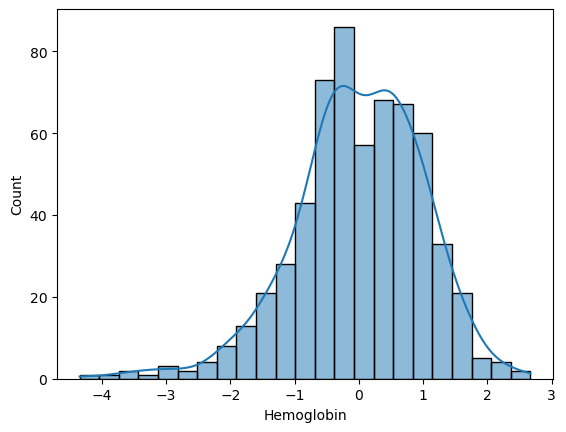

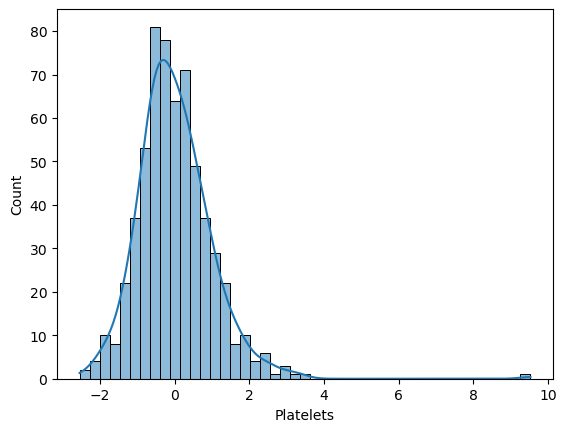

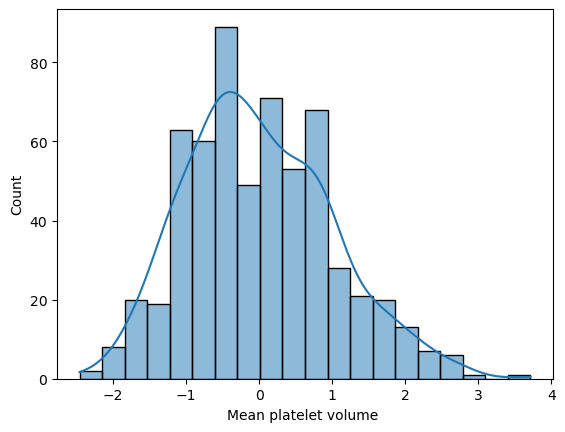

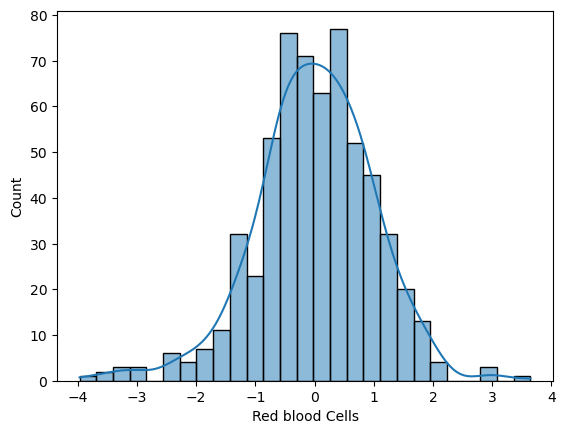

...

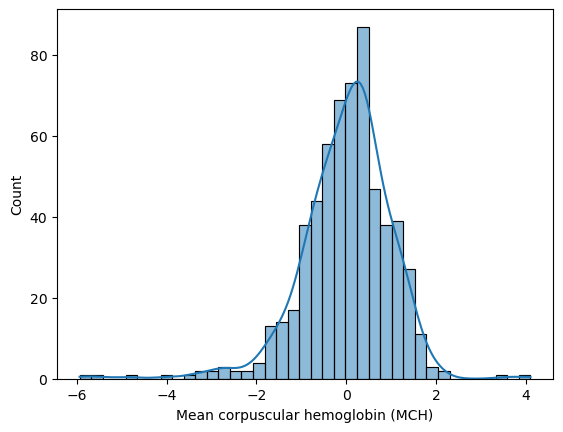

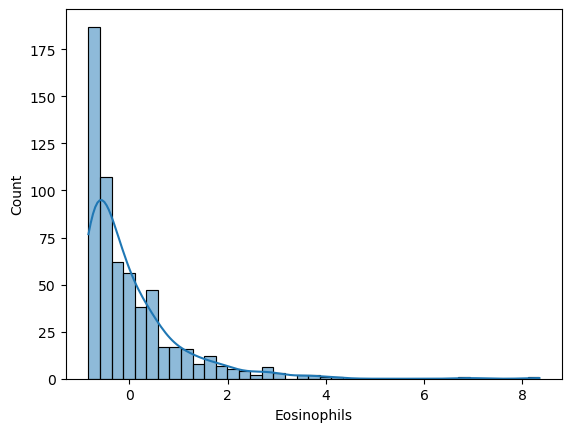

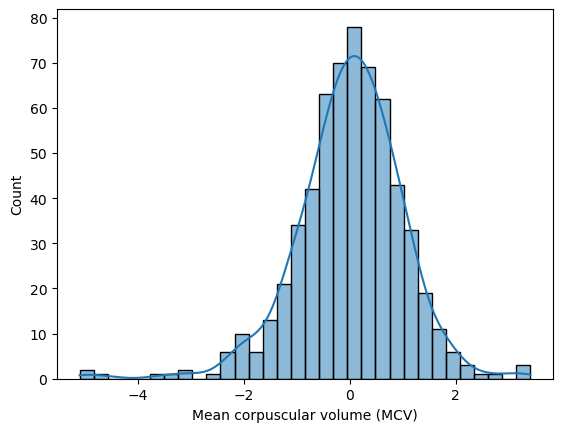

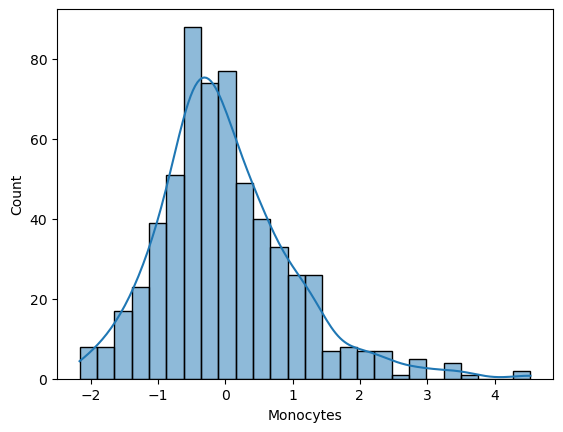

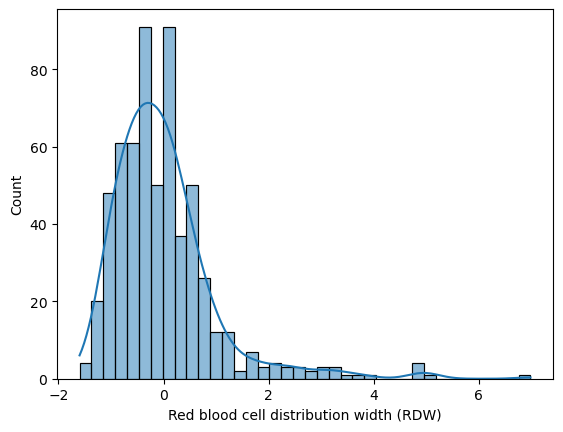

In [83]:
for col in df.select_dtypes('float'):
    plt.figure()
    sns.histplot(df[col], kde=True)

<Axes: xlabel='Patient age quantile', ylabel='Count'>

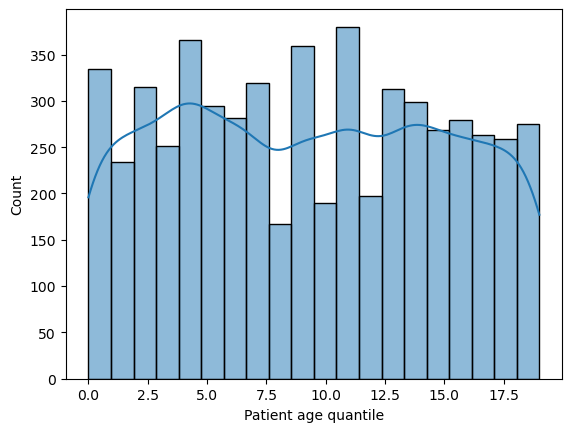

In [84]:
sns.histplot(df['Patient age quantile'], bins=20, kde=True)

In [85]:
df['Patient age quantile'].value_counts()

11    380
4     366
9     359
0     334
7     319
2     315
13    313
14    299
5     294
6     281
16    279
19    275
15    269
17    263
18    259
3     251
1     234
12    197
10    190
8     167
Name: Patient age quantile, dtype: int64

Variables Qualitatives

In [86]:
def hospitalisation(df):
    if df['Patient addmited to regular ward (1=yes, 0=no)'] == 1:
        return 'surveillance'
    elif df['Patient addmited to semi-intensive unit (1=yes, 0=no)'] == 1:
        return 'soins semi-intensives'
    elif df['Patient addmited to intensive care unit (1=yes, 0=no)'] == 1:
        return 'soins intensifs'
    else:
        return 'inconnu'

In [87]:
df['statut'] = df.apply(hospitalisation, axis=1)
df

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test",statut
Patient ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
126e9dd13932f68,17,negative,0,0,0,0.236515,-0.022340,-0.517413,0.010677,0.102004,0.318366,-0.950790,-0.094610,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative,inconnu
a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
f7d619a94f97c45,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
d9e41465789c2b5,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN,inconnu
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ae66feb9e4dc3a0,3,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
517c2834024f3ea,17,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
5c57d6037fe266d,4,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu


In [88]:
for col in df.select_dtypes('object'):
    print(f'{col :-<50} {df[col].unique()}')

SARS-Cov-2 exam result---------------------------- ['negative' 'positive']
Respiratory Syncytial Virus----------------------- [nan 'not_detected' 'detected']
Influenza A--------------------------------------- [nan 'not_detected' 'detected']
Influenza B--------------------------------------- [nan 'not_detected' 'detected']
Parainfluenza 1----------------------------------- [nan 'not_detected' 'detected']
CoronavirusNL63----------------------------------- [nan 'not_detected' 'detected']
Rhinovirus/Enterovirus---------------------------- [nan 'detected' 'not_detected']
Coronavirus HKU1---------------------------------- [nan 'not_detected' 'detected']
Parainfluenza 3----------------------------------- [nan 'not_detected' 'detected']
Chlamydophila pneumoniae-------------------------- [nan 'not_detected' 'detected']
Adenovirus---------------------------------------- [nan 'not_detected' 'detected']
Parainfluenza 4----------------------------------- [nan 'not_detected' 'detected']
Coronavirus2

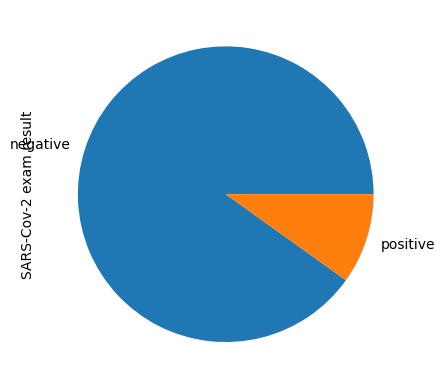

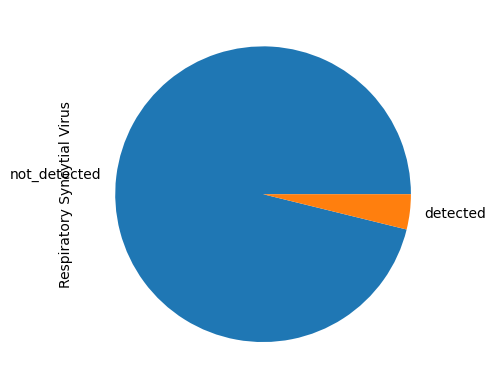

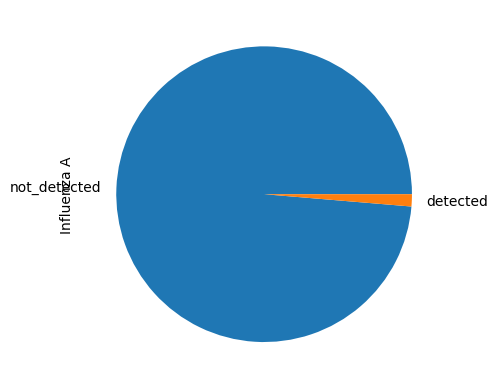

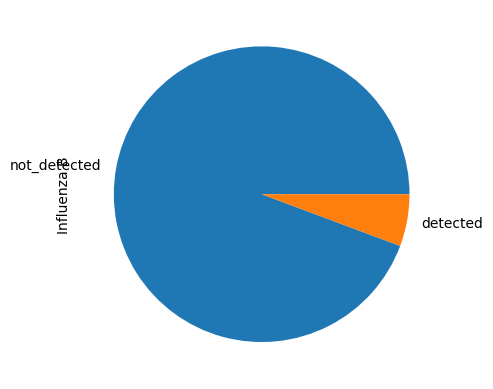

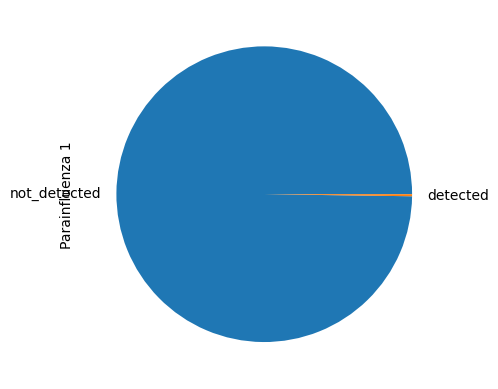

...

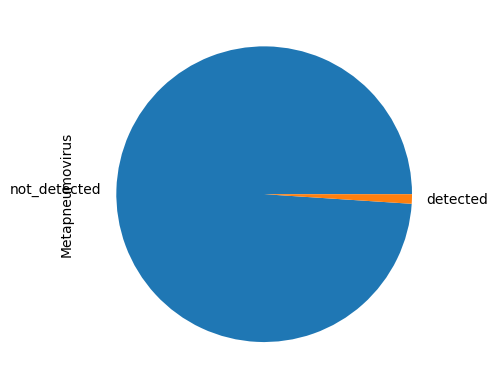

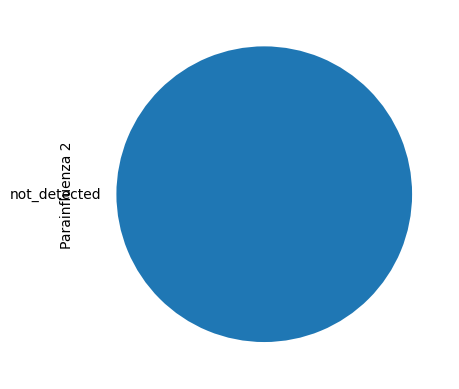

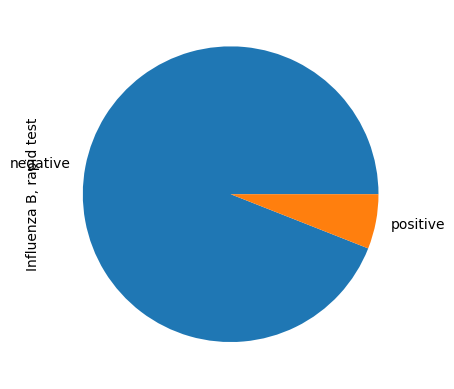

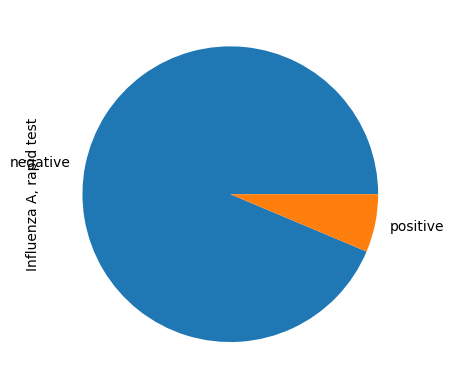

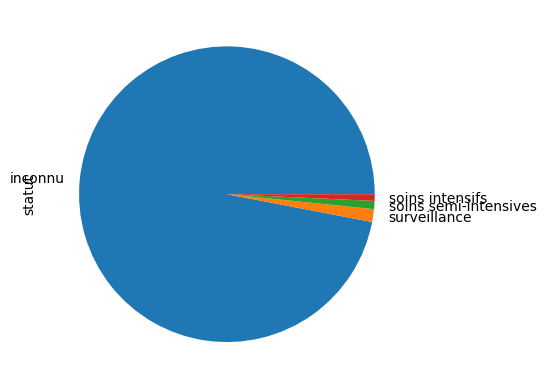

In [89]:
for col in df.select_dtypes('object'):
    plt.figure()
    df[col].value_counts().plot.pie()

Relation Target / Variables

Création de sous-ensembles positifs et négatifs

In [90]:
positive_df = df[df['SARS-Cov-2 exam result'] == 'positive']

In [91]:
negative_df = df[df['SARS-Cov-2 exam result'] == 'negative']

Création des ensembles Blood et viral

In [92]:
missing_rate = df.isna().sum()/df.shape[0]

In [93]:
blood_columns = df.columns[(missing_rate < 0.9) & (missing_rate >0.88)]

In [94]:
viral_columns = df.columns[(missing_rate < 0.88) & (missing_rate > 0.75)]

Target / Blood

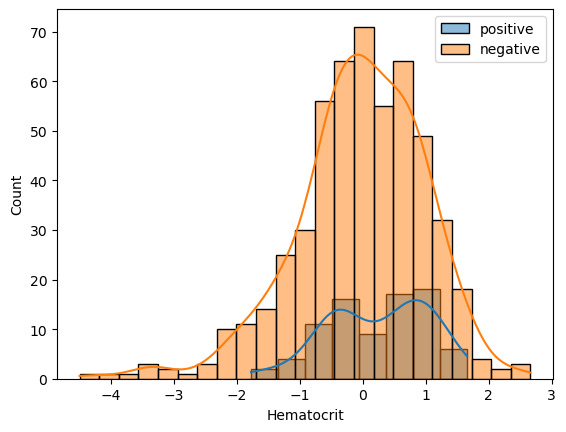

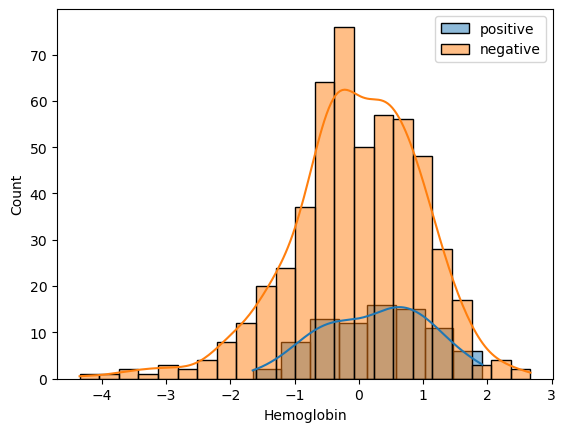

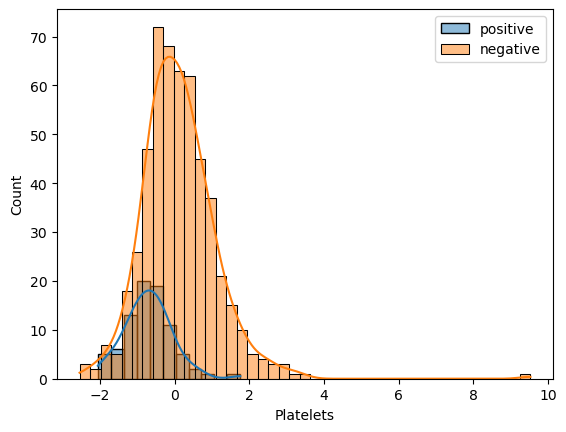

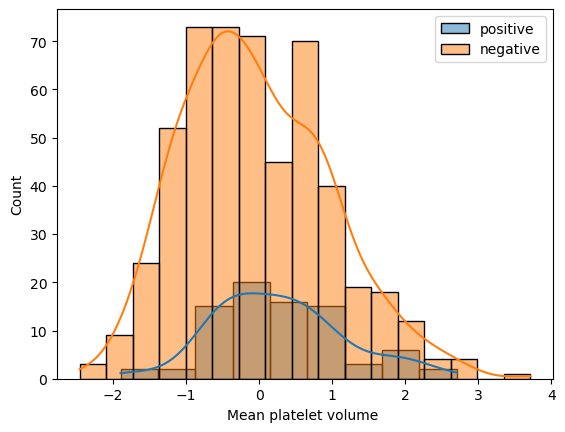

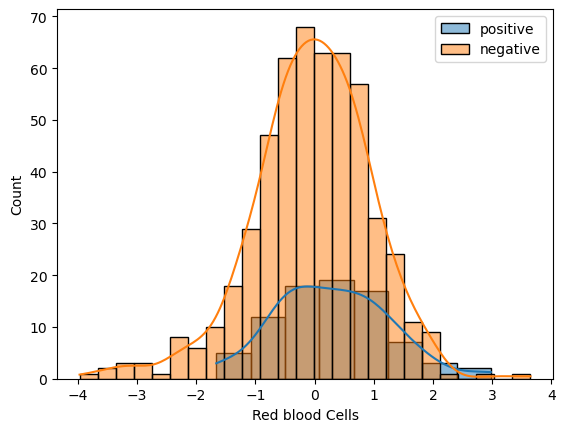

...

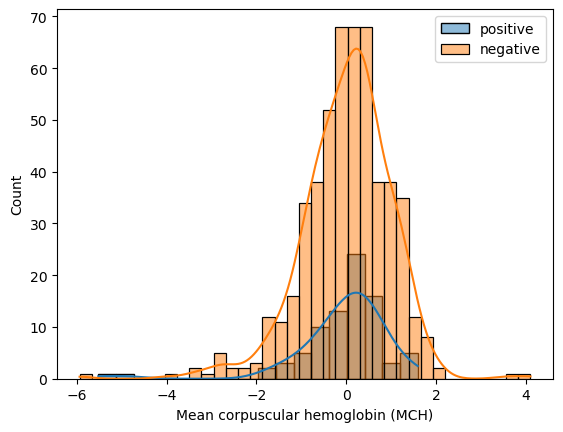

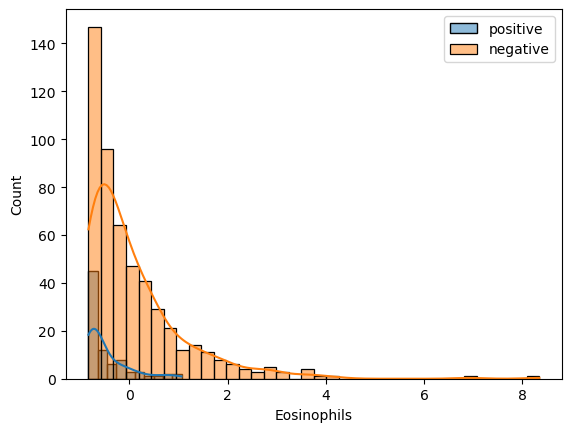

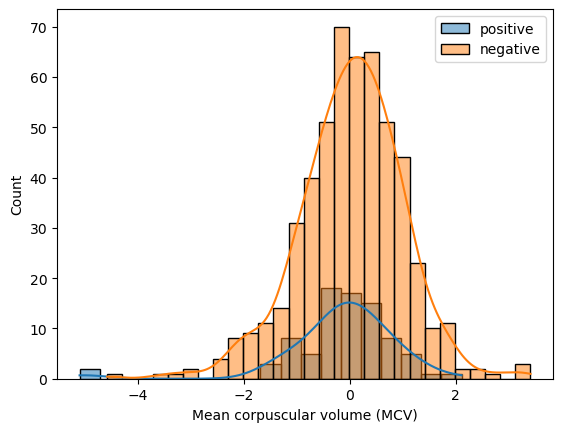

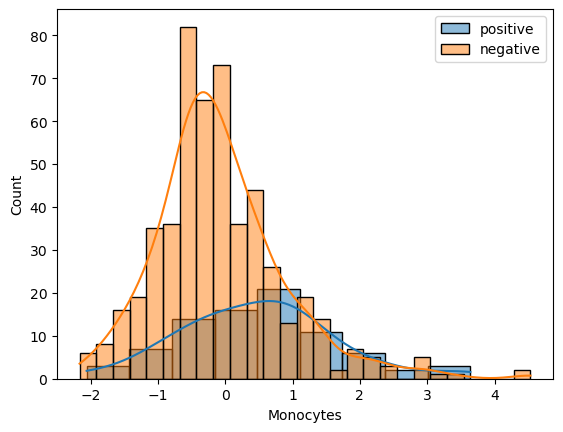

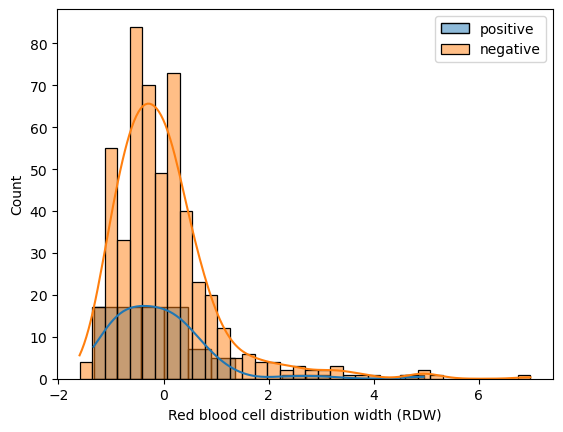

In [95]:
for col in blood_columns:
    plt.figure()
    sns.histplot(positive_df[col], label='positive', kde=True)
    sns.histplot(negative_df[col], label='negative', kde=True)
    plt.legend()

Relation Target / Viral

In [96]:
pd.crosstab(df['SARS-Cov-2 exam result'], df['Influenza A'])

Influenza A,detected,not_detected
SARS-Cov-2 exam result,,
negative,18,1224
positive,0,112


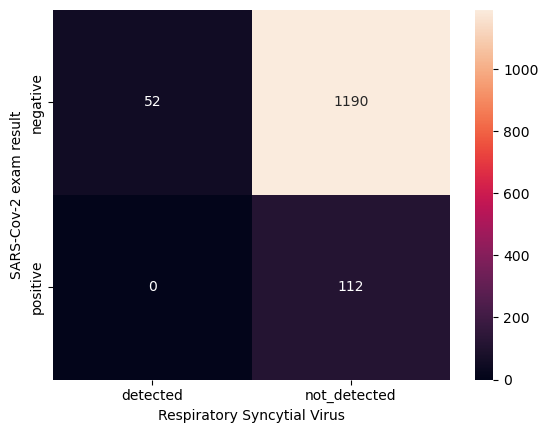

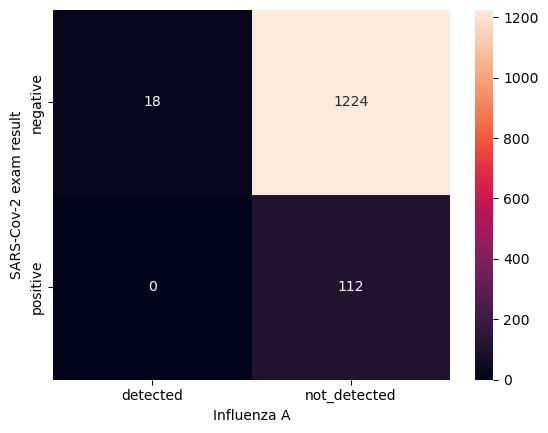

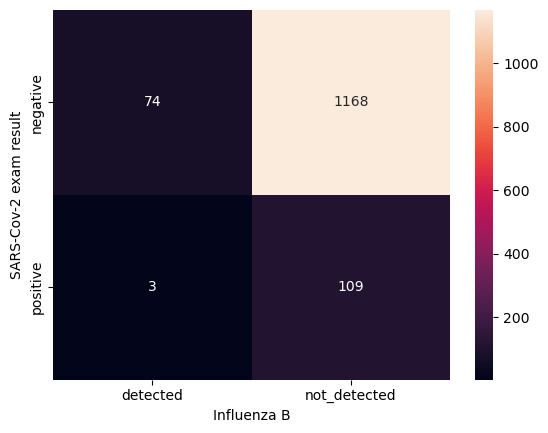

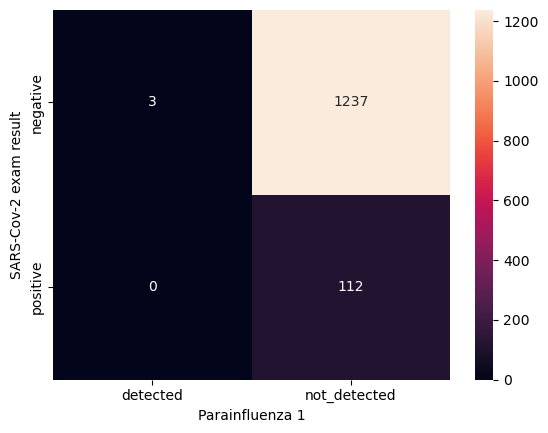

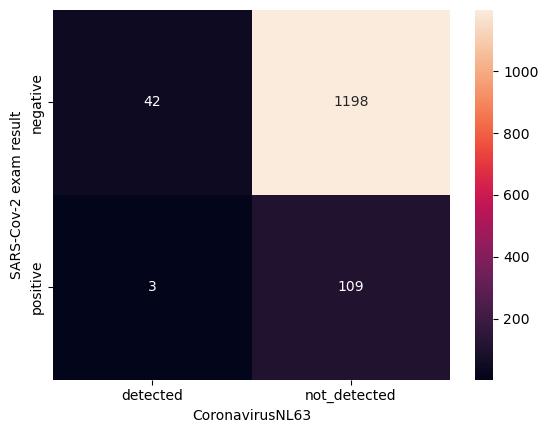

...

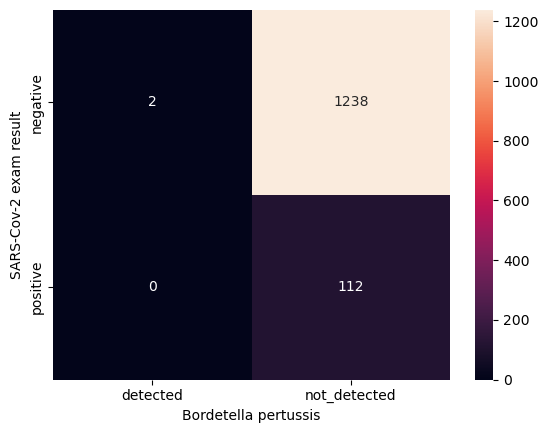

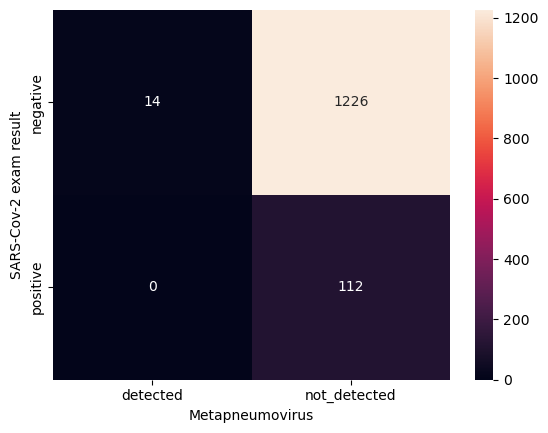

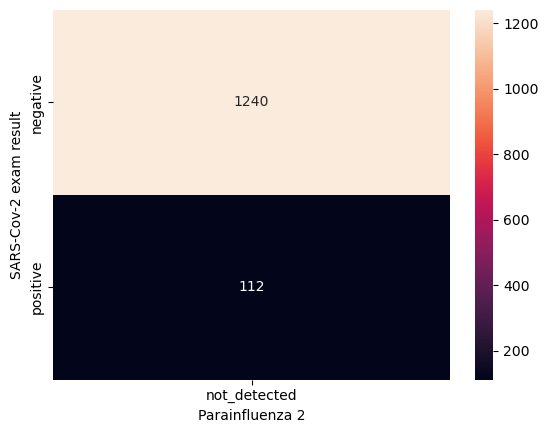

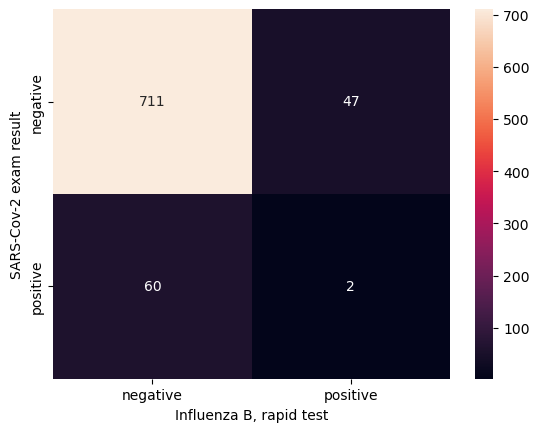

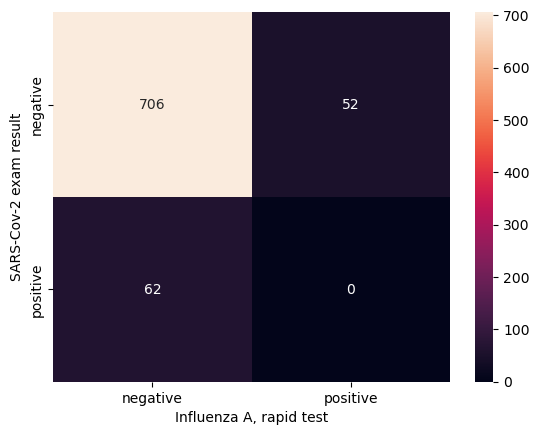

In [97]:
for col in viral_columns:
    plt.figure()
    sns.heatmap(pd.crosstab(df['SARS-Cov-2 exam result'], df[col]), annot=True, fmt='d')

Analyse un peu plus Avancée

Relation Variables / Variables

relations Taux Sanguin

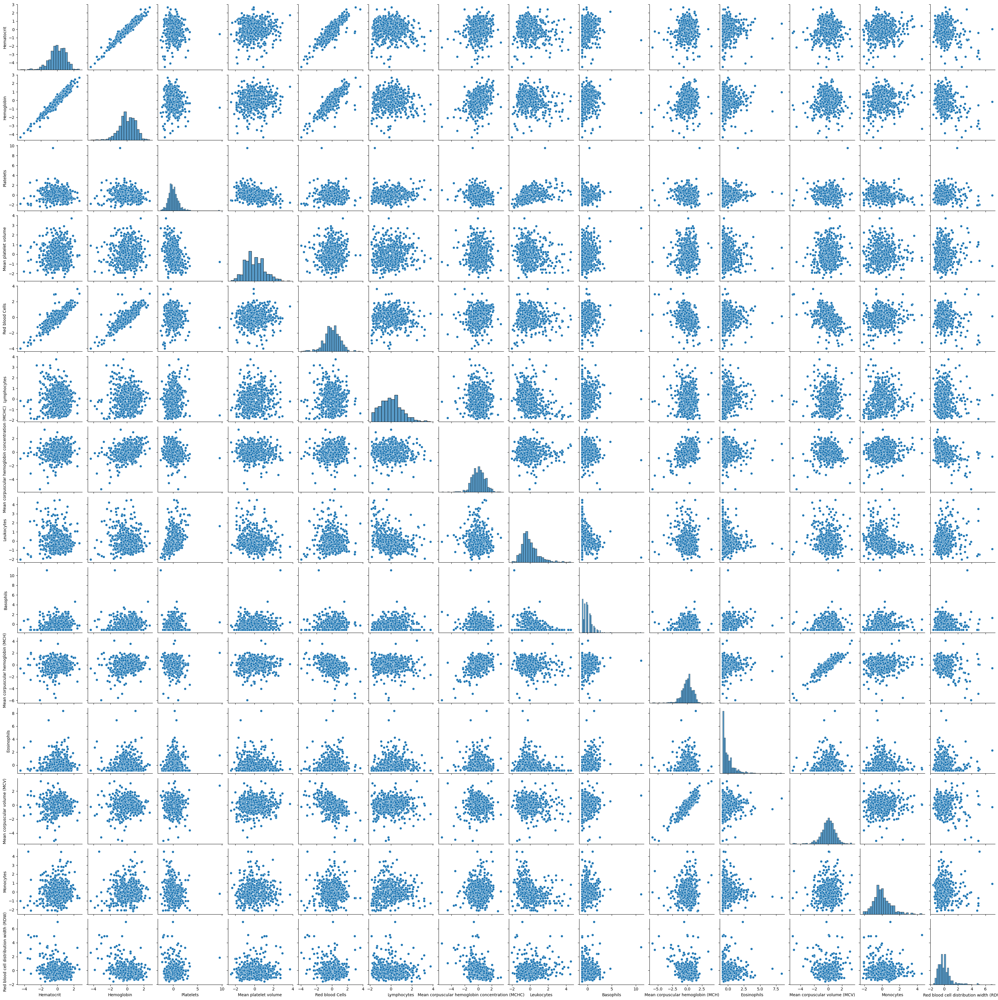

In [98]:
sns.pairplot(df[blood_columns])

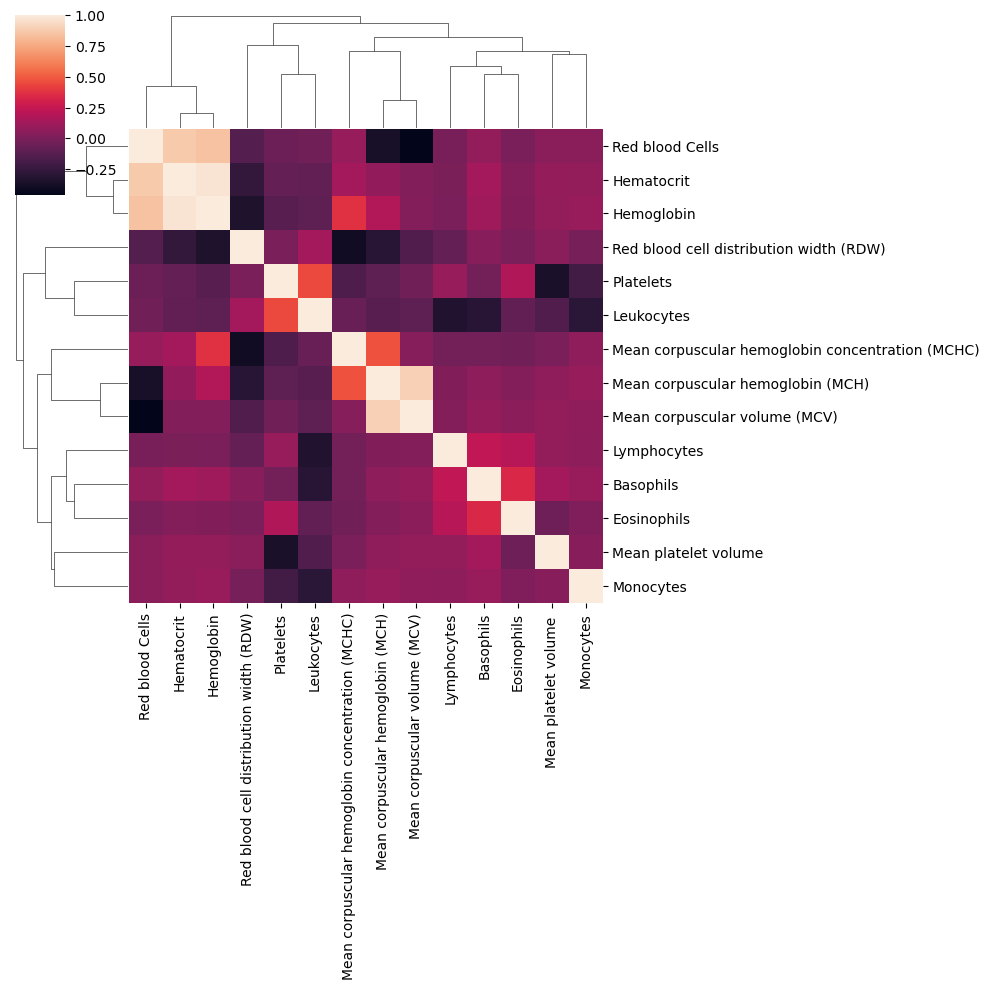

In [99]:
sns.clustermap(df[blood_columns].corr())

Relation Age / Sang

<Figure size 640x480 with 0 Axes>

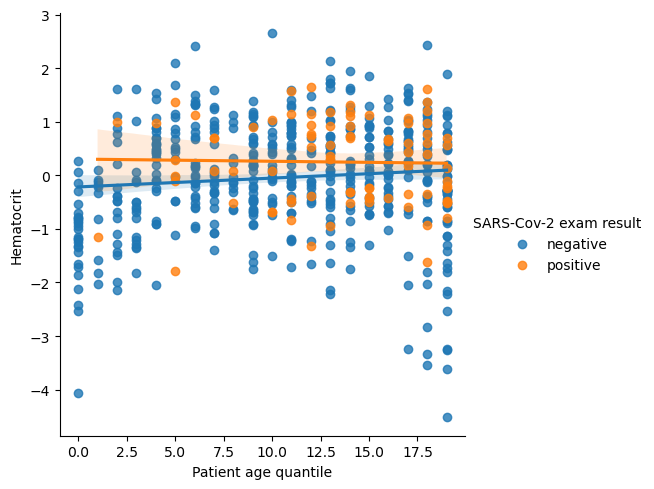

<Figure size 640x480 with 0 Axes>

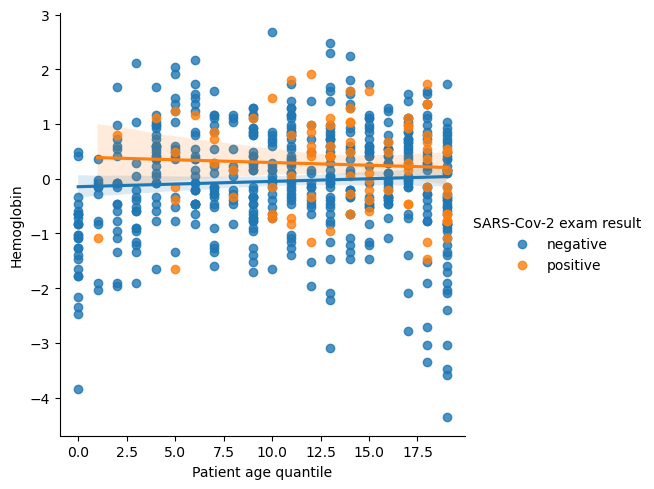

<Figure size 640x480 with 0 Axes>

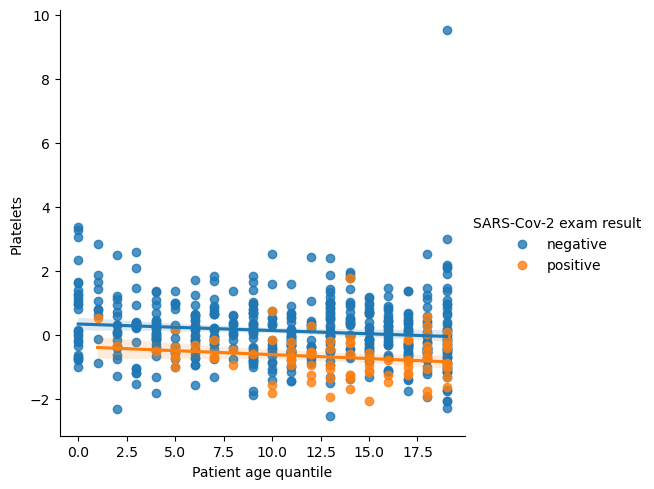

<Figure size 640x480 with 0 Axes>

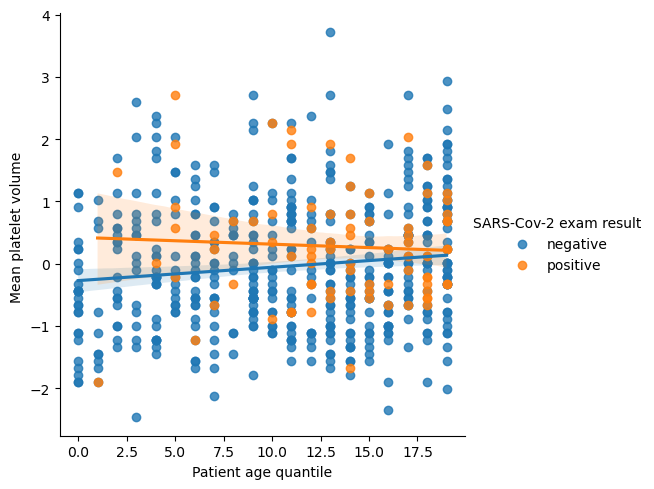

<Figure size 640x480 with 0 Axes>

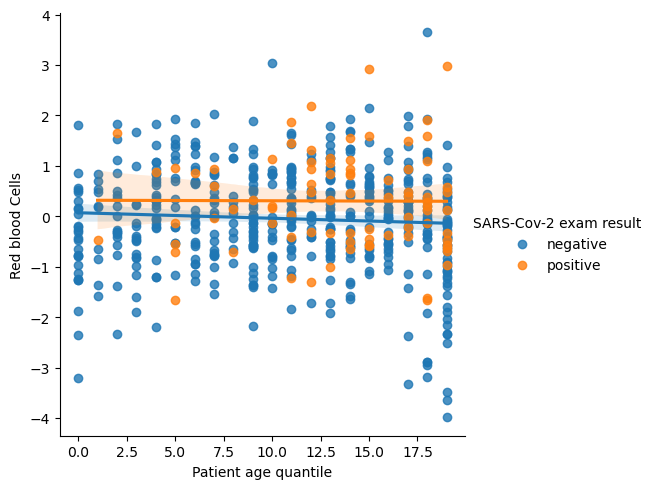

<Figure size 640x480 with 0 Axes>

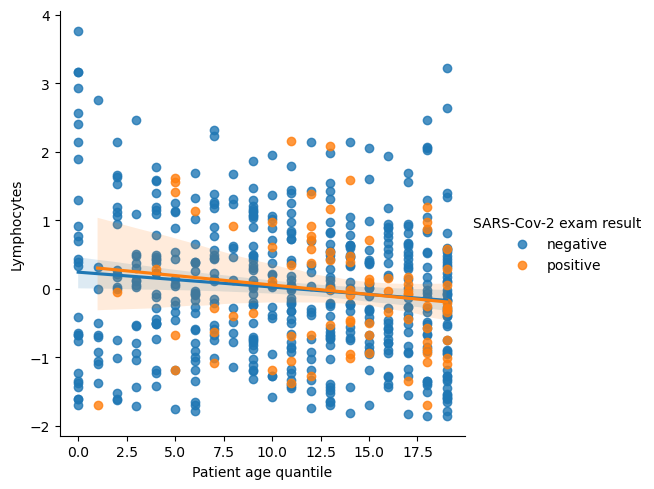

<Figure size 640x480 with 0 Axes>

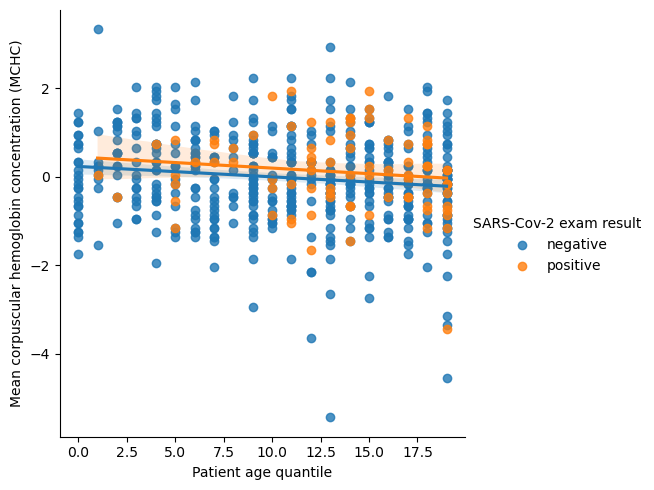

<Figure size 640x480 with 0 Axes>

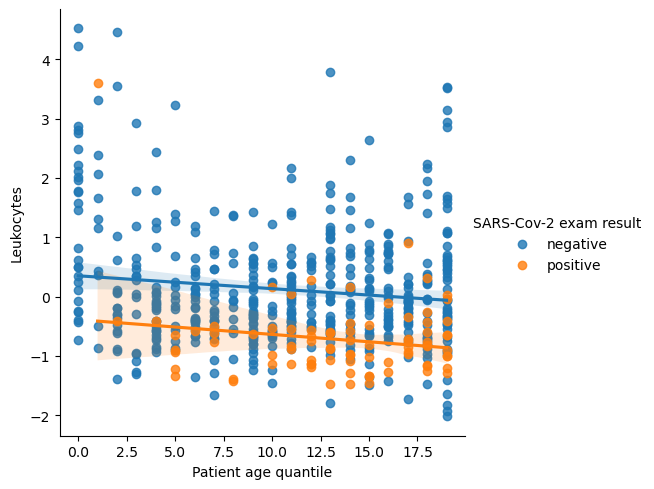

<Figure size 640x480 with 0 Axes>

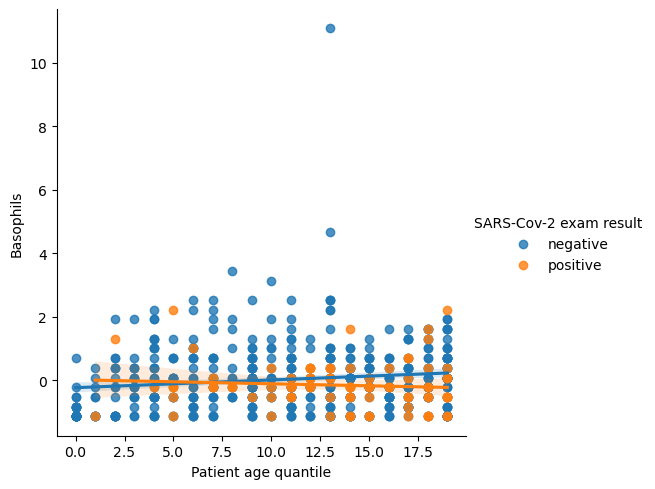

<Figure size 640x480 with 0 Axes>

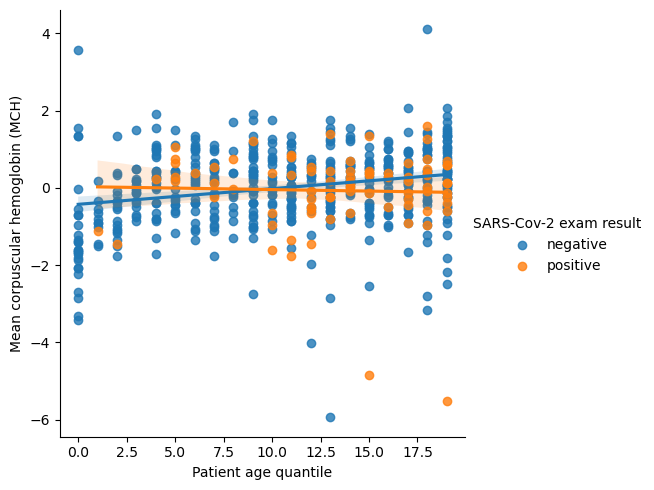

<Figure size 640x480 with 0 Axes>

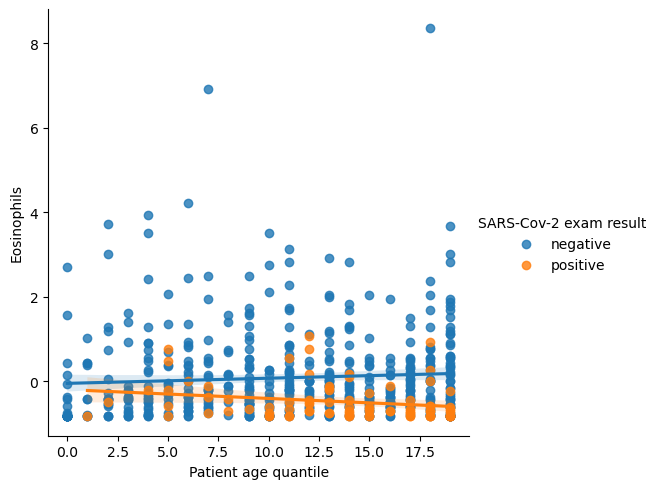

<Figure size 640x480 with 0 Axes>

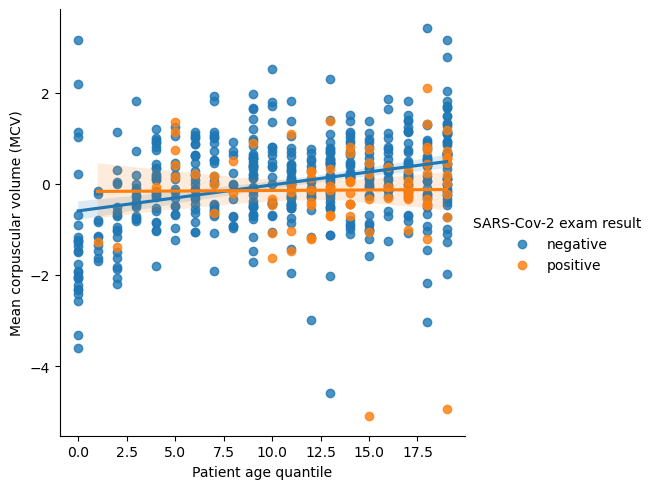

<Figure size 640x480 with 0 Axes>

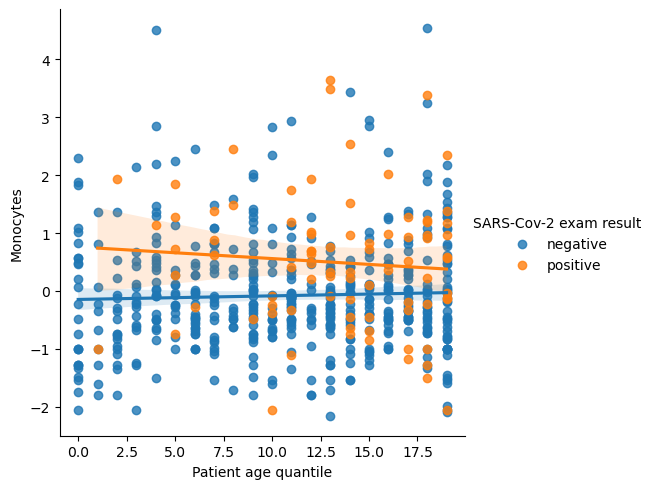

<Figure size 640x480 with 0 Axes>

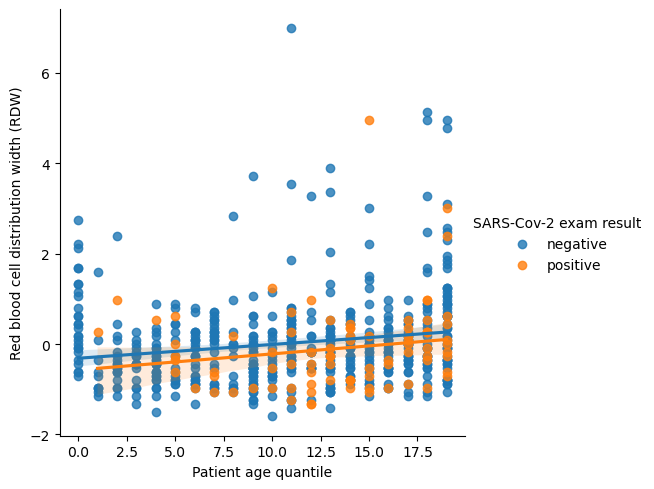

In [100]:
for col in blood_columns:
    plt.figure()
    sns.lmplot(x='Patient age quantile', y=col, hue='SARS-Cov-2 exam result', data=df)

In [101]:
df.corr(numeric_only=True)['Patient age quantile'].sort_values()

Leukocytes                                              -0.166386
Platelets                                               -0.158683
Lymphocytes                                             -0.125935
Mean corpuscular hemoglobin concentration (MCHC)        -0.124671
Red blood Cells                                         -0.037510
Patient addmited to intensive care unit (1=yes, 0=no)   -0.035772
Patient addmited to semi-intensive unit (1=yes, 0=no)    0.015736
Eosinophils                                              0.022085
Patient addmited to regular ward (1=yes, 0=no)           0.046166
Monocytes                                                0.050962
Hemoglobin                                               0.060320
Hematocrit                                               0.096808
Basophils                                                0.107525
Mean platelet volume                                     0.119449
Red blood cell distribution width (RDW)                  0.166429
Mean corpu

Relation entre Influenza et rapid test

In [102]:
pd.crosstab(df['Influenza A'], df['Influenza A, rapid test'])

"Influenza A, rapid test",negative,positive
Influenza A,,
detected,2,4
not_detected,245,15


In [103]:
pd.crosstab(df['Influenza B'], df['Influenza B, rapid test'])

"Influenza B, rapid test",negative,positive
Influenza B,,
detected,18,11
not_detected,233,4


relation Viral / sanguin

Création d'une nouvelle variable "est malade"

In [104]:
df['est malade'] = np.sum(df[viral_columns[:-2]] == 'detected', axis=1) >=1

In [105]:
df.head()

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test",statut,est malade
Patient ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
44477f75e8169d2,13,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu,False
126e9dd13932f68,17,negative,0,0,0,0.236515,-0.02234,-0.517413,0.010677,0.102004,0.318366,-0.95079,-0.09461,-0.223767,-0.292269,1.482158,0.166192,0.357547,-0.625073,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,negative,negative,inconnu,True
a46b4402a0e5696,8,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu,False
f7d619a94f97c45,5,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu,False
d9e41465789c2b5,15,negative,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN,inconnu,True


In [106]:
malade_df = df[df['est malade'] == True]
non_malade_df = df[df['est malade'] == False]

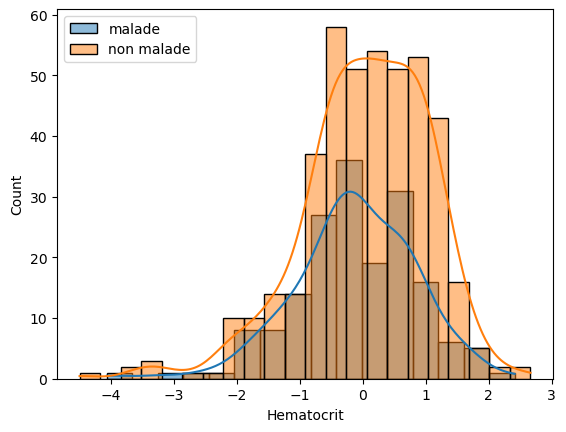

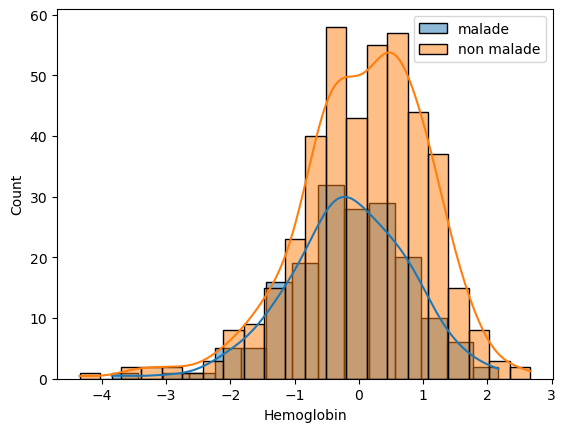

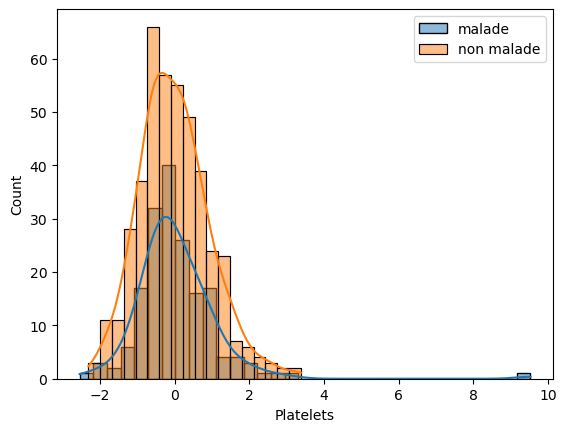

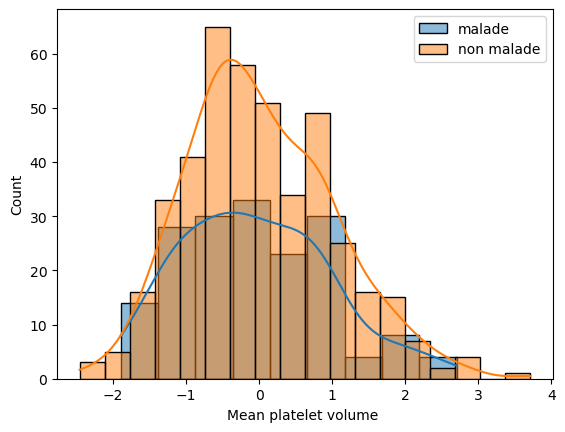

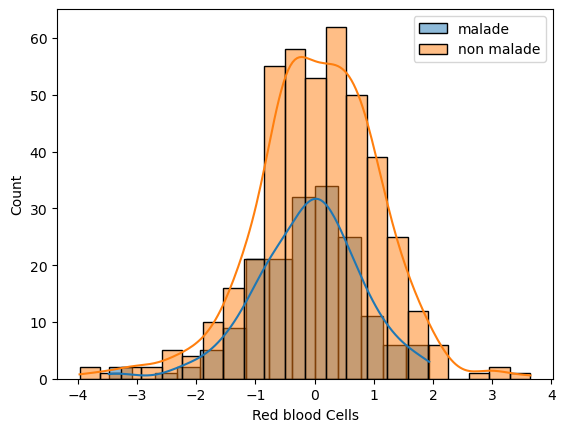

...

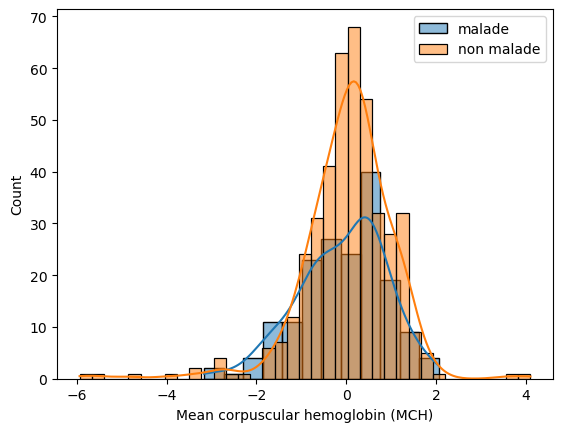

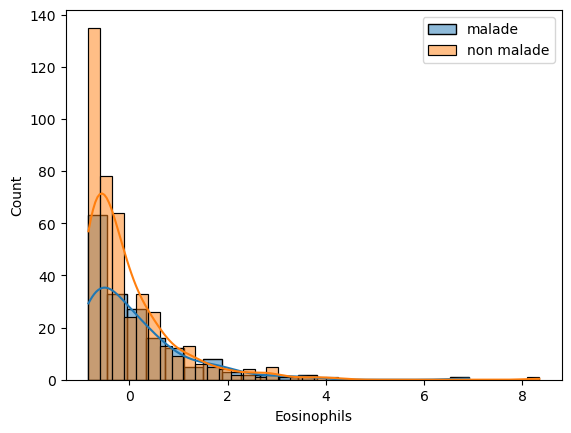

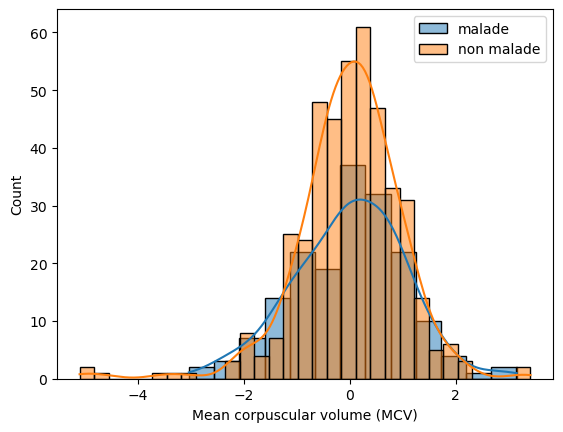

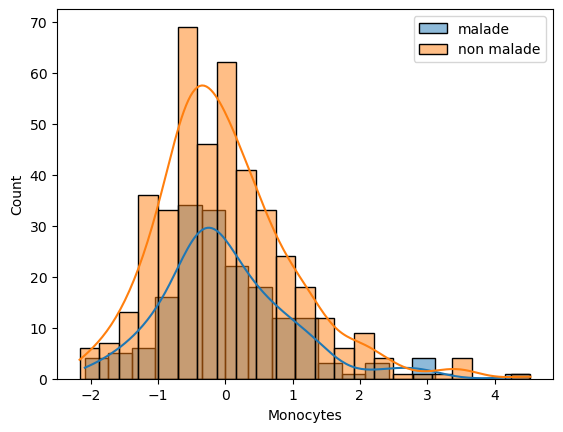

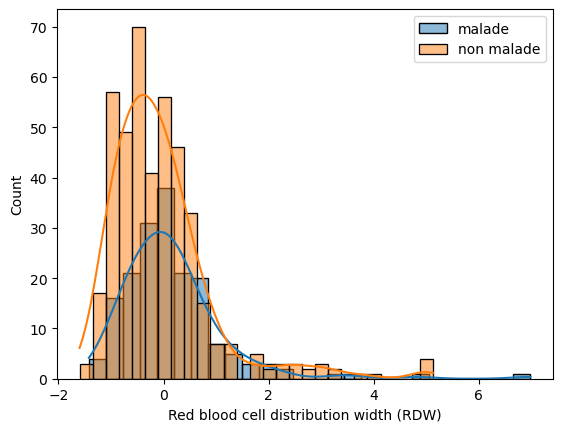

In [107]:
for col in blood_columns:
    plt.figure()
    sns.histplot(malade_df[col], label='malade', kde=True)
    sns.histplot(non_malade_df[col], label='non malade', kde=True)
    plt.legend()

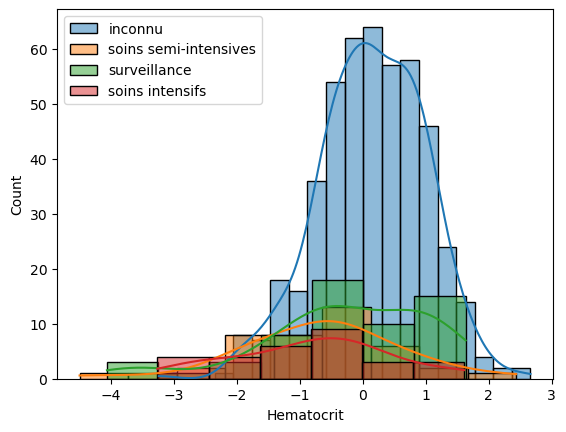

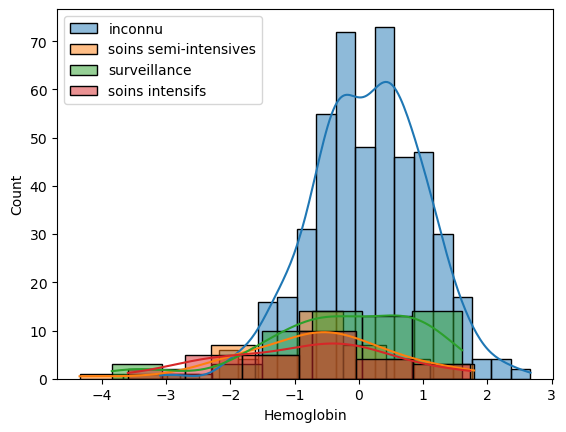

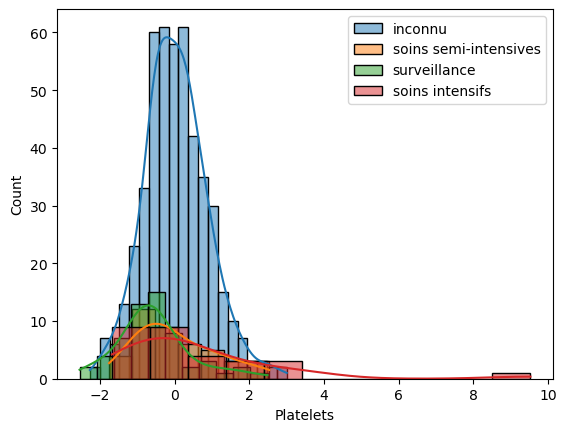

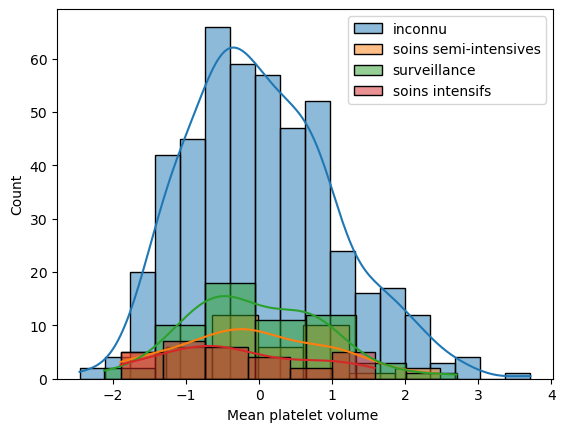

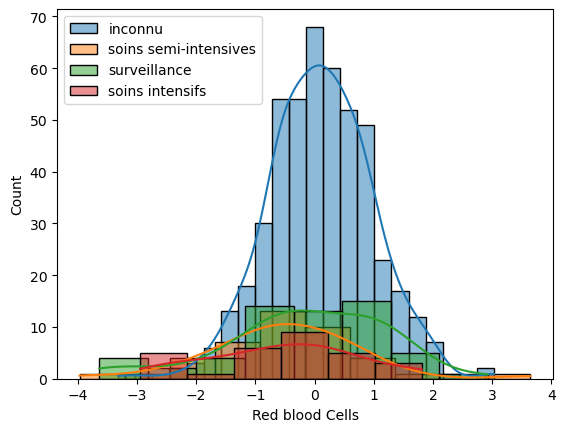

...

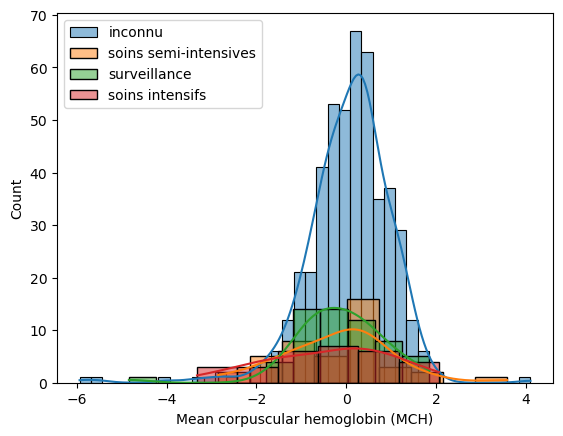

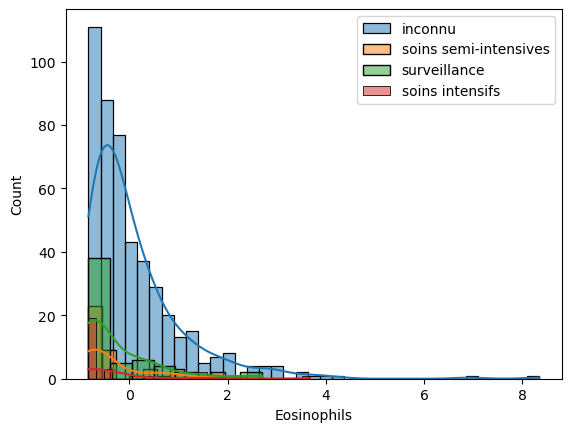

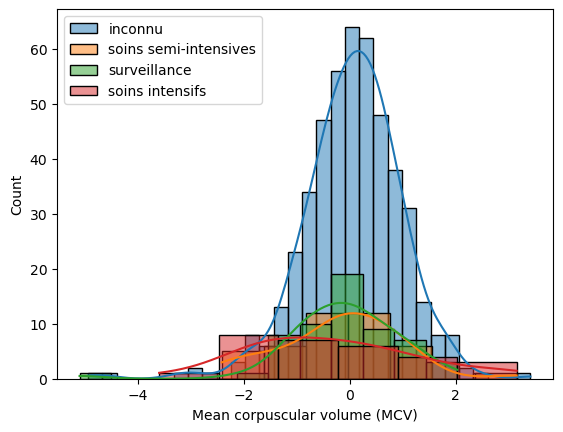

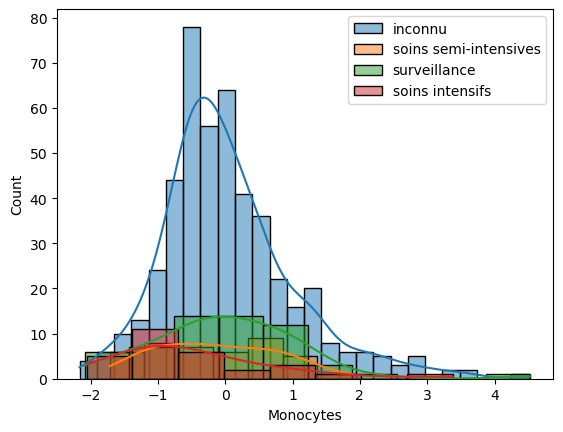

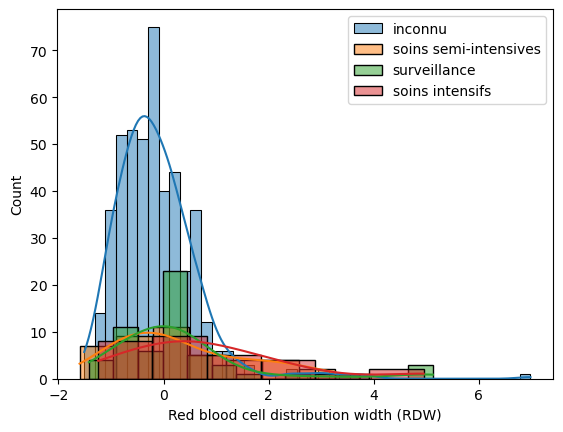

In [108]:
for col in blood_columns:
    plt.figure()
    for cat in df['statut'].unique():
        sns.histplot(df[df['statut']==cat][col], label=cat, kde=True)
    plt.legend()

In [109]:
df[blood_columns].count()

Hematocrit                                          603
Hemoglobin                                          603
Platelets                                           602
Mean platelet volume                                599
Red blood Cells                                     602
Lymphocytes                                         602
Mean corpuscular hemoglobin concentration (MCHC)    602
Leukocytes                                          602
Basophils                                           602
Mean corpuscular hemoglobin (MCH)                   602
Eosinophils                                         602
Mean corpuscular volume (MCV)                       602
Monocytes                                           601
Red blood cell distribution width (RDW)             602
dtype: int64

In [110]:
df[viral_columns].count()

Respiratory Syncytial Virus    1354
Influenza A                    1354
Influenza B                    1354
Parainfluenza 1                1352
CoronavirusNL63                1352
Rhinovirus/Enterovirus         1352
Coronavirus HKU1               1352
Parainfluenza 3                1352
Chlamydophila pneumoniae       1352
Adenovirus                     1352
Parainfluenza 4                1352
Coronavirus229E                1352
CoronavirusOC43                1352
Inf A H1N1 2009                1352
Bordetella pertussis           1352
Metapneumovirus                1352
Parainfluenza 2                1352
Influenza B, rapid test         820
Influenza A, rapid test         820
dtype: int64

In [111]:
df1 = df[viral_columns[:-2]]
df1['covid'] = df['SARS-Cov-2 exam result']
df1.dropna()['covid'].value_counts(normalize=True)

C:\Users\romeofr\AppData\Local\Temp\ipykernel_4020\3520532109.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['covid'] = df['SARS-Cov-2 exam result']


negative    0.91716
positive    0.08284
Name: covid, dtype: float64

In [112]:
df2 = df[blood_columns]
df2['covid'] = df['SARS-Cov-2 exam result']
df2.dropna()['covid'].value_counts(normalize=True)

C:\Users\romeofr\AppData\Local\Temp\ipykernel_4020\4103850288.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['covid'] = df['SARS-Cov-2 exam result']


negative    0.864548
positive    0.135452
Name: covid, dtype: float64

T-Test

In [113]:
from scipy.stats import ttest_ind

positive_df

,Patient age quantile,SARS-Cov-2 exam result,"Patient addmited to regular ward (1=yes, 0=no)","Patient addmited to semi-intensive unit (1=yes, 0=no)","Patient addmited to intensive care unit (1=yes, 0=no)",Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,Basophils,Mean corpuscular hemoglobin (MCH),Eosinophils,Mean corpuscular volume (MCV),Monocytes,Red blood cell distribution width (RDW),Respiratory Syncytial Virus,Influenza A,Influenza B,Parainfluenza 1,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Chlamydophila pneumoniae,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Bordetella pertussis,Metapneumovirus,Parainfluenza 2,"Influenza B, rapid test","Influenza A, rapid test",statut
Patient ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
78511c183ae18bc,7,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
d7834ed75f2da44,16,positive,1,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN,surveillance
b16b49f7bd3e692,10,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN,inconnu
4382f5ea05e60c4,2,positive,0,0,0,0.991838,0.792188,-0.341548,1.469188,1.653476,-0.048383,-0.452899,-0.420197,1.303529,-1.442245,-0.498393,-1.396114,1.933339,0.967144,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,not_detected,NaN,NaN,inconnu
d3729cd2658ca64,15,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5c386388ba3c3f0,16,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
9f8dfe2ae239238,4,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu
db77903261ab6d0,15,positive,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inconnu


In [114]:
balanced_neg = negative_df.sample(positive_df.shape[0])

In [115]:
def t_test(col):
    alpha = 0.02
    stat, p = ttest_ind(balanced_neg[col].dropna(), positive_df[col].dropna())
    if p < alpha:
        return 'H0 Rejetée'
    else :
        return 0

In [116]:
for col in blood_columns:
    print(f'{col :-<50} {t_test(col)}')

Hematocrit---------------------------------------- H0 Rejetée
Hemoglobin---------------------------------------- H0 Rejetée
Platelets----------------------------------------- H0 Rejetée
Mean platelet volume ----------------------------- 0
Red blood Cells----------------------------------- H0 Rejetée
Lymphocytes--------------------------------------- 0
Mean corpuscular hemoglobin concentration (MCHC)-- 0
Leukocytes---------------------------------------- H0 Rejetée
Basophils----------------------------------------- 0
Mean corpuscular hemoglobin (MCH)----------------- 0
Eosinophils--------------------------------------- H0 Rejetée
Mean corpuscular volume (MCV)--------------------- 0
Monocytes----------------------------------------- H0 Rejetée
Red blood cell distribution width (RDW)----------- 0
